# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

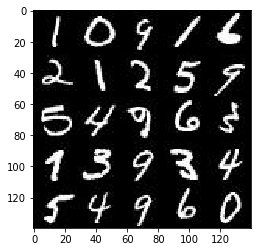

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

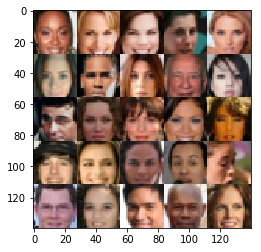

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    input_real = tf.placeholder(tf.float32, 
                                shape=(None, image_width, image_height, image_channels),
                                name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    learning_rate = tf.placeholder(tf.float32, name='learning_rate')

    return input_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
alpha = 0.2
def leaky_relu(x):
    return tf.maximum(alpha*x,x)

In [15]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        conv_layer1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        relu1 = leaky_relu(conv_layer1)
        
        conv_layer2 = tf.layers.conv2d(conv_layer1, 128, 5, strides=2, padding='same')
        conv_layer2 = tf.layers.batch_normalization(conv_layer2, training=True)
        relu2 = leaky_relu(conv_layer2)
        
        conv_layer3 = tf.layers.conv2d(conv_layer2, 256, 5, strides=2, padding='same')
        conv_layer3 = tf.layers.batch_normalization(conv_layer3, training=True)
        relu3 = leaky_relu(conv_layer3)
        
        conv_layer4 = tf.layers.conv2d(conv_layer3, 512, 5, strides=2, padding='same')
        conv_layer4 = tf.layers.batch_normalization(conv_layer4)
        relu4 = leaky_relu(conv_layer4)
              
        #Flat
        flat = tf.reshape(relu4, (-1, 4*4*512))
        
        #Logits
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [16]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    with tf.variable_scope('generator', reuse=False if is_train==True else True):
        #Fully connected layer
        fully_conn = tf.layers.dense(z, 7*7*512)
        fully_conn = tf.reshape(fully_conn, (-1,7,7,512))
        fully_conn = tf.layers.batch_normalization(fully_conn, training=is_train)
        fully_conn = leaky_relu(fully_conn)
        # 7x7x512

        #Convolutions
        conv_layer1 = tf.layers.conv2d_transpose(fully_conn, 256, 5, strides=2, padding='same')
        conv_layer1 = tf.layers.batch_normalization(conv_layer1, training=is_train)
        conv_layer1 = leaky_relu(conv_layer1)
        # 14x14x256

        conv_layer2 = tf.layers.conv2d_transpose(conv_layer1, 128, 5, strides=1, padding='same')
        conv_layer2 = tf.layers.batch_normalization(conv_layer2, training=is_train)
        conv_layer2 = leaky_relu(conv_layer2)
        # 14x14x128

        conv_layer3 = tf.layers.conv2d_transpose(conv_layer2, 64, 5, strides=2, padding='same')
        conv_layer3 = tf.layers.batch_normalization(conv_layer3, training=is_train)
        conv_layer3 = leaky_relu(conv_layer3)
        # 28x28x64 
        
        conv_layer4 = tf.layers.conv2d_transpose(conv_layer3, 32, 5, strides=1, padding='same')
        conv_layer4 = tf.layers.batch_normalization(conv_layer4, training=is_train)
        conv_layer4 = leaky_relu(conv_layer4)
        # 28x28x32 
        
        # Output layer
        logits = tf.layers.conv2d_transpose(conv_layer4, out_channel_dim, 5, strides=1, padding='same')
        # 28x28xout_dim 

        gen_out = tf.tanh(logits)

    return gen_out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [17]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    # Label smoothing 
    smooth = 0.1
    
    g_model = generator(input_z, out_channel_dim, is_train=True)
    d_model_real, d_logits_real = discriminator(input_real, reuse=False)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                labels=(tf.ones_like(d_model_real)*(1-smooth)) ))
    
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                labels=tf.zeros_like(d_model_fake)))

    dicriminator_loss = d_loss_real + d_loss_fake
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    
    return dicriminator_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [18]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
    
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [19]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [20]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    print("Shape:", data_shape)
    print("Learning rate:", learning_rate)
    img_width = data_shape[1]
    img_height = data_shape[2]
    img_channels = data_shape[3]
    
    # Init GAN
    input_real, input_z, lr = model_inputs(img_width, img_height, img_channels, z_dim)
    print(input_real)
    print(input_z)
    d_loss, g_loss = model_loss(input_real, input_z, img_channels)
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    # Train
    steps = 0
    saver = tf.train.Saver()    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                steps += 1
                
                #adjust the range
                batch_images *= 2
                
                batch_z = np.random.uniform(-1,1, size=(batch_size, z_dim))
                
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                
                if steps % 10 == 0:
                    d_loss_train = d_loss.eval({input_z: batch_z, input_real: batch_images})
                    g_loss_train = g_loss.eval({input_z: batch_z})
                    
                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                         "Discriminator Loss: {:.4f}...".format(d_loss_train),
                         "Generator Loss: {:.4f}".format(g_loss_train))
                    
                if steps % 100 == 0:
                    show_generator_output(sess, 25, input_z, img_channels, data_image_mode)
                    
                
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Shape: (60000, 28, 28, 1)
Learning rate: 0.0002
Tensor("input_real:0", shape=(?, 28, 28, 1), dtype=float32)
Tensor("input_z:0", shape=(?, 100), dtype=float32)
Epoch 1/3... Discriminator Loss: 10.6759... Generator Loss: 0.0000
Epoch 1/3... Discriminator Loss: 0.3850... Generator Loss: 15.9446
Epoch 1/3... Discriminator Loss: 0.5147... Generator Loss: 25.3897
Epoch 1/3... Discriminator Loss: 0.4357... Generator Loss: 2.5811
Epoch 1/3... Discriminator Loss: 0.6435... Generator Loss: 29.5281
Epoch 1/3... Discriminator Loss: 0.3742... Generator Loss: 7.6315
Epoch 1/3... Discriminator Loss: 0.3522... Generator Loss: 17.8856
Epoch 1/3... Discriminator Loss: 0.5481... Generator Loss: 1.9654
Epoch 1/3... Discriminator Loss: 0.3720... Generator Loss: 3.4842
Epoch 1/3... Discriminator Loss: 0.7699... Generator Loss: 1.1998


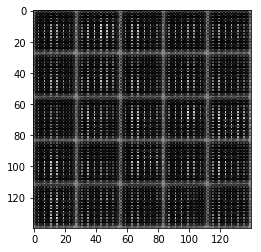

Epoch 1/3... Discriminator Loss: 0.5224... Generator Loss: 1.8686
Epoch 1/3... Discriminator Loss: 0.3459... Generator Loss: 5.4047
Epoch 1/3... Discriminator Loss: 0.4485... Generator Loss: 2.6083
Epoch 1/3... Discriminator Loss: 0.4588... Generator Loss: 3.0327
Epoch 1/3... Discriminator Loss: 2.6748... Generator Loss: 10.9120
Epoch 1/3... Discriminator Loss: 0.5544... Generator Loss: 2.5647
Epoch 1/3... Discriminator Loss: 1.0995... Generator Loss: 0.8506
Epoch 1/3... Discriminator Loss: 0.7204... Generator Loss: 5.2743
Epoch 1/3... Discriminator Loss: 0.3776... Generator Loss: 3.9920
Epoch 1/3... Discriminator Loss: 0.9429... Generator Loss: 1.0773


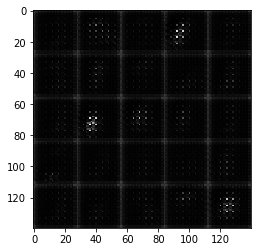

Epoch 1/3... Discriminator Loss: 0.5948... Generator Loss: 2.3509
Epoch 1/3... Discriminator Loss: 0.7165... Generator Loss: 1.6678
Epoch 1/3... Discriminator Loss: 1.0319... Generator Loss: 0.8785
Epoch 1/3... Discriminator Loss: 1.2453... Generator Loss: 1.5639
Epoch 1/3... Discriminator Loss: 1.0666... Generator Loss: 0.8732
Epoch 1/3... Discriminator Loss: 1.1580... Generator Loss: 2.0450
Epoch 1/3... Discriminator Loss: 1.5884... Generator Loss: 0.4272
Epoch 1/3... Discriminator Loss: 1.2102... Generator Loss: 2.6429
Epoch 1/3... Discriminator Loss: 1.0838... Generator Loss: 1.0571
Epoch 1/3... Discriminator Loss: 1.1128... Generator Loss: 0.9062


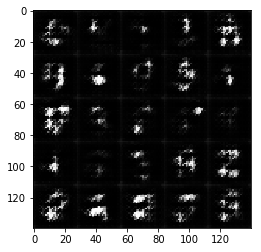

Epoch 1/3... Discriminator Loss: 1.3905... Generator Loss: 0.5787
Epoch 1/3... Discriminator Loss: 1.4338... Generator Loss: 0.7125
Epoch 1/3... Discriminator Loss: 1.2327... Generator Loss: 0.9266
Epoch 1/3... Discriminator Loss: 1.4052... Generator Loss: 0.5118
Epoch 1/3... Discriminator Loss: 1.2747... Generator Loss: 0.6679
Epoch 1/3... Discriminator Loss: 1.3288... Generator Loss: 0.6086
Epoch 1/3... Discriminator Loss: 1.5997... Generator Loss: 0.4353
Epoch 1/3... Discriminator Loss: 1.5618... Generator Loss: 0.4598
Epoch 1/3... Discriminator Loss: 1.2131... Generator Loss: 0.7570
Epoch 1/3... Discriminator Loss: 1.2292... Generator Loss: 2.0198


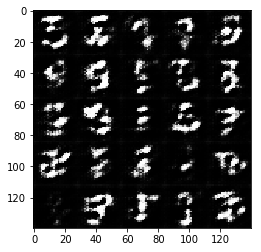

Epoch 1/3... Discriminator Loss: 1.6250... Generator Loss: 1.4474
Epoch 1/3... Discriminator Loss: 1.1621... Generator Loss: 1.1622
Epoch 1/3... Discriminator Loss: 1.5011... Generator Loss: 1.2671
Epoch 1/3... Discriminator Loss: 1.1474... Generator Loss: 0.9683
Epoch 1/3... Discriminator Loss: 1.2908... Generator Loss: 0.8514
Epoch 1/3... Discriminator Loss: 1.2033... Generator Loss: 0.7248
Epoch 1/3... Discriminator Loss: 1.3642... Generator Loss: 1.0596
Epoch 1/3... Discriminator Loss: 1.0750... Generator Loss: 1.0363
Epoch 1/3... Discriminator Loss: 1.5917... Generator Loss: 0.4092
Epoch 1/3... Discriminator Loss: 1.3607... Generator Loss: 0.6106


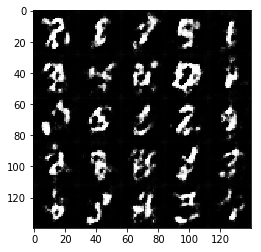

Epoch 1/3... Discriminator Loss: 1.1410... Generator Loss: 1.3629
Epoch 1/3... Discriminator Loss: 1.0790... Generator Loss: 1.0599
Epoch 1/3... Discriminator Loss: 1.3014... Generator Loss: 1.3915
Epoch 1/3... Discriminator Loss: 1.1473... Generator Loss: 0.7982
Epoch 1/3... Discriminator Loss: 1.0507... Generator Loss: 0.9577
Epoch 1/3... Discriminator Loss: 1.1317... Generator Loss: 0.9290
Epoch 1/3... Discriminator Loss: 1.0548... Generator Loss: 0.9006
Epoch 1/3... Discriminator Loss: 1.2472... Generator Loss: 0.8714
Epoch 1/3... Discriminator Loss: 1.0646... Generator Loss: 1.1167
Epoch 1/3... Discriminator Loss: 1.0713... Generator Loss: 0.9914


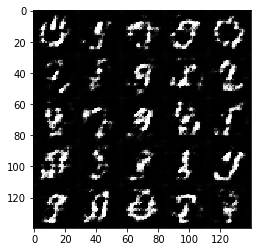

Epoch 1/3... Discriminator Loss: 1.2303... Generator Loss: 0.8020
Epoch 1/3... Discriminator Loss: 1.2048... Generator Loss: 0.6414
Epoch 1/3... Discriminator Loss: 1.0745... Generator Loss: 0.8893
Epoch 1/3... Discriminator Loss: 1.2471... Generator Loss: 0.8446
Epoch 1/3... Discriminator Loss: 1.2796... Generator Loss: 0.6288
Epoch 1/3... Discriminator Loss: 1.2408... Generator Loss: 1.1503
Epoch 1/3... Discriminator Loss: 0.9170... Generator Loss: 1.1327
Epoch 1/3... Discriminator Loss: 0.9173... Generator Loss: 1.5018
Epoch 1/3... Discriminator Loss: 0.8387... Generator Loss: 1.4442
Epoch 1/3... Discriminator Loss: 0.9467... Generator Loss: 0.9882


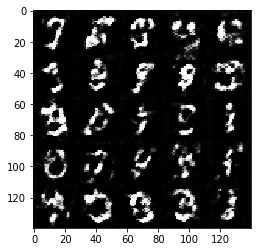

Epoch 1/3... Discriminator Loss: 0.9649... Generator Loss: 1.1397
Epoch 1/3... Discriminator Loss: 0.9503... Generator Loss: 1.3441
Epoch 1/3... Discriminator Loss: 1.0965... Generator Loss: 0.9799
Epoch 1/3... Discriminator Loss: 1.1110... Generator Loss: 0.8335
Epoch 1/3... Discriminator Loss: 1.1207... Generator Loss: 0.8964
Epoch 1/3... Discriminator Loss: 1.1679... Generator Loss: 0.7057
Epoch 1/3... Discriminator Loss: 1.1336... Generator Loss: 1.1336
Epoch 1/3... Discriminator Loss: 0.9310... Generator Loss: 1.8620
Epoch 1/3... Discriminator Loss: 1.0531... Generator Loss: 1.2455
Epoch 1/3... Discriminator Loss: 1.0853... Generator Loss: 1.5548


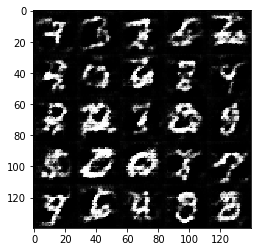

Epoch 1/3... Discriminator Loss: 1.2976... Generator Loss: 0.5930
Epoch 1/3... Discriminator Loss: 1.3361... Generator Loss: 0.6169
Epoch 1/3... Discriminator Loss: 1.0241... Generator Loss: 1.0199
Epoch 1/3... Discriminator Loss: 1.5507... Generator Loss: 0.4776
Epoch 1/3... Discriminator Loss: 1.1874... Generator Loss: 0.6560
Epoch 1/3... Discriminator Loss: 1.1874... Generator Loss: 0.8100
Epoch 1/3... Discriminator Loss: 0.9670... Generator Loss: 1.0371
Epoch 1/3... Discriminator Loss: 1.3002... Generator Loss: 0.5240
Epoch 1/3... Discriminator Loss: 1.1526... Generator Loss: 1.0159
Epoch 1/3... Discriminator Loss: 1.0215... Generator Loss: 0.9527


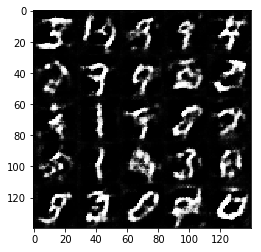

Epoch 1/3... Discriminator Loss: 1.0544... Generator Loss: 1.7359
Epoch 1/3... Discriminator Loss: 1.1430... Generator Loss: 1.2899
Epoch 1/3... Discriminator Loss: 1.2080... Generator Loss: 1.1458
Epoch 2/3... Discriminator Loss: 1.0836... Generator Loss: 0.9371
Epoch 2/3... Discriminator Loss: 1.1306... Generator Loss: 0.8468
Epoch 2/3... Discriminator Loss: 1.2669... Generator Loss: 0.9564
Epoch 2/3... Discriminator Loss: 1.2021... Generator Loss: 1.1877
Epoch 2/3... Discriminator Loss: 1.2509... Generator Loss: 0.9788
Epoch 2/3... Discriminator Loss: 1.2513... Generator Loss: 0.7269
Epoch 2/3... Discriminator Loss: 1.1444... Generator Loss: 1.1469


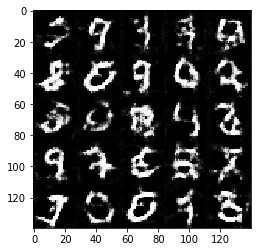

Epoch 2/3... Discriminator Loss: 1.1367... Generator Loss: 1.2322
Epoch 2/3... Discriminator Loss: 1.1609... Generator Loss: 1.1875
Epoch 2/3... Discriminator Loss: 1.3275... Generator Loss: 1.2989
Epoch 2/3... Discriminator Loss: 1.3126... Generator Loss: 0.7692
Epoch 2/3... Discriminator Loss: 1.4618... Generator Loss: 0.6338
Epoch 2/3... Discriminator Loss: 1.2021... Generator Loss: 0.7360
Epoch 2/3... Discriminator Loss: 1.2602... Generator Loss: 0.8127
Epoch 2/3... Discriminator Loss: 0.9534... Generator Loss: 1.0563
Epoch 2/3... Discriminator Loss: 1.4174... Generator Loss: 0.7115
Epoch 2/3... Discriminator Loss: 1.2921... Generator Loss: 1.0833


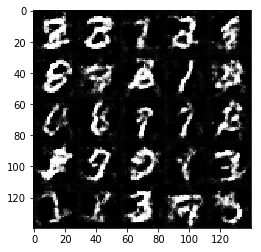

Epoch 2/3... Discriminator Loss: 1.2307... Generator Loss: 1.0838
Epoch 2/3... Discriminator Loss: 1.1457... Generator Loss: 0.9186
Epoch 2/3... Discriminator Loss: 1.3872... Generator Loss: 0.9326
Epoch 2/3... Discriminator Loss: 1.5908... Generator Loss: 0.4502
Epoch 2/3... Discriminator Loss: 1.3778... Generator Loss: 0.7028
Epoch 2/3... Discriminator Loss: 1.3867... Generator Loss: 0.7555
Epoch 2/3... Discriminator Loss: 1.4295... Generator Loss: 0.8625
Epoch 2/3... Discriminator Loss: 1.1531... Generator Loss: 0.9427
Epoch 2/3... Discriminator Loss: 1.1394... Generator Loss: 0.8592
Epoch 2/3... Discriminator Loss: 1.3017... Generator Loss: 1.2107


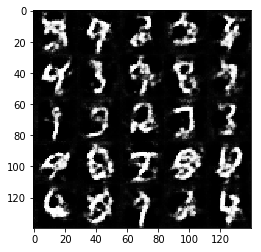

Epoch 2/3... Discriminator Loss: 1.4049... Generator Loss: 0.7292
Epoch 2/3... Discriminator Loss: 1.1482... Generator Loss: 1.2754
Epoch 2/3... Discriminator Loss: 1.2093... Generator Loss: 0.8379
Epoch 2/3... Discriminator Loss: 1.3546... Generator Loss: 0.5423
Epoch 2/3... Discriminator Loss: 1.2586... Generator Loss: 0.7020
Epoch 2/3... Discriminator Loss: 1.0876... Generator Loss: 1.0048
Epoch 2/3... Discriminator Loss: 1.2188... Generator Loss: 0.8430
Epoch 2/3... Discriminator Loss: 1.0460... Generator Loss: 1.0315
Epoch 2/3... Discriminator Loss: 1.1336... Generator Loss: 0.8932
Epoch 2/3... Discriminator Loss: 1.0733... Generator Loss: 0.7942


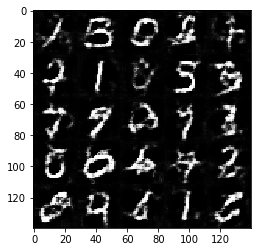

Epoch 2/3... Discriminator Loss: 1.5059... Generator Loss: 0.5597
Epoch 2/3... Discriminator Loss: 1.2049... Generator Loss: 1.1819
Epoch 2/3... Discriminator Loss: 1.2107... Generator Loss: 0.8585
Epoch 2/3... Discriminator Loss: 1.2697... Generator Loss: 0.9236
Epoch 2/3... Discriminator Loss: 1.1664... Generator Loss: 1.1171
Epoch 2/3... Discriminator Loss: 1.1377... Generator Loss: 1.3016
Epoch 2/3... Discriminator Loss: 1.2238... Generator Loss: 0.9421
Epoch 2/3... Discriminator Loss: 1.1637... Generator Loss: 0.9721
Epoch 2/3... Discriminator Loss: 1.3193... Generator Loss: 0.7673
Epoch 2/3... Discriminator Loss: 1.0425... Generator Loss: 0.8727


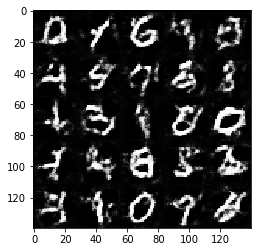

Epoch 2/3... Discriminator Loss: 1.1876... Generator Loss: 0.7400
Epoch 2/3... Discriminator Loss: 1.5646... Generator Loss: 1.1558
Epoch 2/3... Discriminator Loss: 1.2720... Generator Loss: 0.6719
Epoch 2/3... Discriminator Loss: 1.5211... Generator Loss: 0.4421
Epoch 2/3... Discriminator Loss: 1.3097... Generator Loss: 1.4596
Epoch 2/3... Discriminator Loss: 1.3244... Generator Loss: 0.6052
Epoch 2/3... Discriminator Loss: 1.1924... Generator Loss: 0.8011
Epoch 2/3... Discriminator Loss: 1.2619... Generator Loss: 1.1359
Epoch 2/3... Discriminator Loss: 1.1621... Generator Loss: 1.1354
Epoch 2/3... Discriminator Loss: 1.0618... Generator Loss: 0.9099


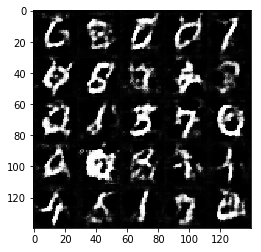

Epoch 2/3... Discriminator Loss: 1.3466... Generator Loss: 1.6618
Epoch 2/3... Discriminator Loss: 1.3808... Generator Loss: 0.7004
Epoch 2/3... Discriminator Loss: 1.2547... Generator Loss: 0.9470
Epoch 2/3... Discriminator Loss: 1.2178... Generator Loss: 0.8238
Epoch 2/3... Discriminator Loss: 1.3330... Generator Loss: 0.7063
Epoch 2/3... Discriminator Loss: 1.2004... Generator Loss: 1.1699
Epoch 2/3... Discriminator Loss: 1.1817... Generator Loss: 0.8312
Epoch 2/3... Discriminator Loss: 1.1768... Generator Loss: 0.7911
Epoch 2/3... Discriminator Loss: 1.3410... Generator Loss: 0.5479
Epoch 2/3... Discriminator Loss: 1.3431... Generator Loss: 0.8490


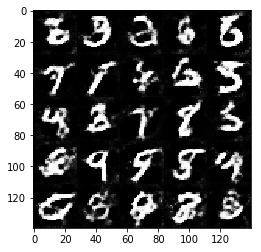

Epoch 2/3... Discriminator Loss: 1.1986... Generator Loss: 0.9932
Epoch 2/3... Discriminator Loss: 1.2938... Generator Loss: 1.0112
Epoch 2/3... Discriminator Loss: 1.1425... Generator Loss: 1.1580
Epoch 2/3... Discriminator Loss: 1.1282... Generator Loss: 0.9631
Epoch 2/3... Discriminator Loss: 1.2568... Generator Loss: 1.1389
Epoch 2/3... Discriminator Loss: 1.3819... Generator Loss: 0.7894
Epoch 2/3... Discriminator Loss: 1.4069... Generator Loss: 0.6122
Epoch 2/3... Discriminator Loss: 1.4874... Generator Loss: 0.6789
Epoch 2/3... Discriminator Loss: 1.0927... Generator Loss: 0.8657
Epoch 2/3... Discriminator Loss: 1.1598... Generator Loss: 1.1774


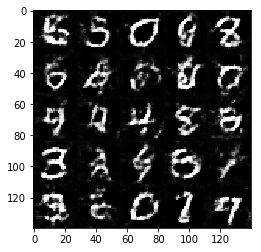

Epoch 2/3... Discriminator Loss: 1.1072... Generator Loss: 0.9414
Epoch 2/3... Discriminator Loss: 1.2306... Generator Loss: 0.8190
Epoch 2/3... Discriminator Loss: 1.3056... Generator Loss: 0.9086
Epoch 2/3... Discriminator Loss: 1.5352... Generator Loss: 0.4349
Epoch 2/3... Discriminator Loss: 1.2597... Generator Loss: 0.9926
Epoch 2/3... Discriminator Loss: 1.2220... Generator Loss: 0.9804
Epoch 2/3... Discriminator Loss: 1.1803... Generator Loss: 0.9162
Epoch 2/3... Discriminator Loss: 0.9651... Generator Loss: 1.2470
Epoch 2/3... Discriminator Loss: 1.4567... Generator Loss: 0.6844
Epoch 2/3... Discriminator Loss: 1.4034... Generator Loss: 0.7390


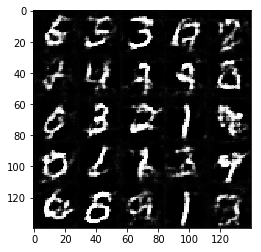

Epoch 2/3... Discriminator Loss: 1.0464... Generator Loss: 0.9417
Epoch 2/3... Discriminator Loss: 1.1888... Generator Loss: 0.8150
Epoch 2/3... Discriminator Loss: 1.0920... Generator Loss: 1.0336
Epoch 2/3... Discriminator Loss: 1.2196... Generator Loss: 1.1442
Epoch 2/3... Discriminator Loss: 1.1369... Generator Loss: 0.9492
Epoch 2/3... Discriminator Loss: 1.2252... Generator Loss: 1.3115
Epoch 2/3... Discriminator Loss: 1.0960... Generator Loss: 0.8115
Epoch 3/3... Discriminator Loss: 1.1701... Generator Loss: 0.8560
Epoch 3/3... Discriminator Loss: 1.2348... Generator Loss: 0.8673
Epoch 3/3... Discriminator Loss: 1.2597... Generator Loss: 0.8442


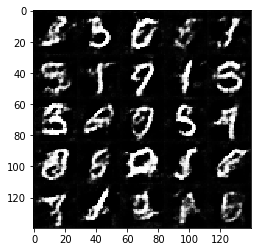

Epoch 3/3... Discriminator Loss: 1.2647... Generator Loss: 1.1608
Epoch 3/3... Discriminator Loss: 1.2787... Generator Loss: 0.7928
Epoch 3/3... Discriminator Loss: 1.1731... Generator Loss: 0.8481
Epoch 3/3... Discriminator Loss: 1.4016... Generator Loss: 0.7450
Epoch 3/3... Discriminator Loss: 1.2764... Generator Loss: 0.9880
Epoch 3/3... Discriminator Loss: 1.2072... Generator Loss: 0.9683
Epoch 3/3... Discriminator Loss: 1.1336... Generator Loss: 0.8760
Epoch 3/3... Discriminator Loss: 1.3753... Generator Loss: 0.6800
Epoch 3/3... Discriminator Loss: 1.0698... Generator Loss: 1.1274
Epoch 3/3... Discriminator Loss: 1.2001... Generator Loss: 1.4525


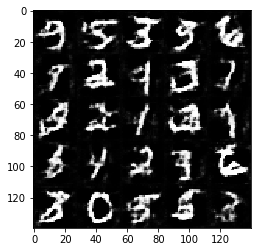

Epoch 3/3... Discriminator Loss: 1.2759... Generator Loss: 0.5893
Epoch 3/3... Discriminator Loss: 1.1788... Generator Loss: 0.8628
Epoch 3/3... Discriminator Loss: 1.2691... Generator Loss: 0.6844
Epoch 3/3... Discriminator Loss: 1.4822... Generator Loss: 0.6272
Epoch 3/3... Discriminator Loss: 1.2786... Generator Loss: 1.4431
Epoch 3/3... Discriminator Loss: 1.1620... Generator Loss: 1.0377
Epoch 3/3... Discriminator Loss: 1.1706... Generator Loss: 0.7533
Epoch 3/3... Discriminator Loss: 1.2687... Generator Loss: 0.7580
Epoch 3/3... Discriminator Loss: 1.1474... Generator Loss: 0.8681
Epoch 3/3... Discriminator Loss: 1.1566... Generator Loss: 0.8888


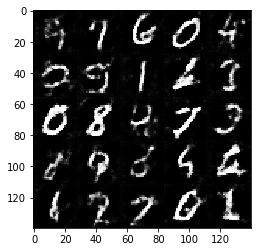

Epoch 3/3... Discriminator Loss: 1.1924... Generator Loss: 0.8679
Epoch 3/3... Discriminator Loss: 1.1755... Generator Loss: 1.1584
Epoch 3/3... Discriminator Loss: 1.3342... Generator Loss: 0.7564
Epoch 3/3... Discriminator Loss: 1.1691... Generator Loss: 1.0792
Epoch 3/3... Discriminator Loss: 1.1545... Generator Loss: 0.7889
Epoch 3/3... Discriminator Loss: 1.2682... Generator Loss: 1.3204
Epoch 3/3... Discriminator Loss: 1.0403... Generator Loss: 0.8945
Epoch 3/3... Discriminator Loss: 1.3456... Generator Loss: 0.9502
Epoch 3/3... Discriminator Loss: 1.0976... Generator Loss: 0.9307
Epoch 3/3... Discriminator Loss: 1.0599... Generator Loss: 1.1042


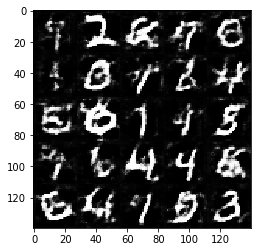

Epoch 3/3... Discriminator Loss: 1.2939... Generator Loss: 0.6628
Epoch 3/3... Discriminator Loss: 1.2853... Generator Loss: 1.5318
Epoch 3/3... Discriminator Loss: 1.4046... Generator Loss: 0.9895
Epoch 3/3... Discriminator Loss: 1.2234... Generator Loss: 1.0852
Epoch 3/3... Discriminator Loss: 1.2314... Generator Loss: 0.8176
Epoch 3/3... Discriminator Loss: 1.2376... Generator Loss: 0.7050
Epoch 3/3... Discriminator Loss: 1.3341... Generator Loss: 1.1689
Epoch 3/3... Discriminator Loss: 1.5100... Generator Loss: 0.6299
Epoch 3/3... Discriminator Loss: 1.3815... Generator Loss: 0.9873
Epoch 3/3... Discriminator Loss: 1.1704... Generator Loss: 0.8548


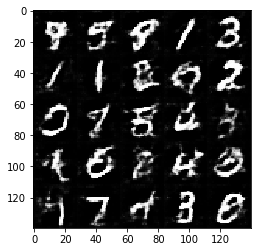

Epoch 3/3... Discriminator Loss: 1.2273... Generator Loss: 0.7134
Epoch 3/3... Discriminator Loss: 1.2021... Generator Loss: 0.7496
Epoch 3/3... Discriminator Loss: 1.3279... Generator Loss: 0.6949
Epoch 3/3... Discriminator Loss: 1.2991... Generator Loss: 1.1688
Epoch 3/3... Discriminator Loss: 1.3652... Generator Loss: 0.5557
Epoch 3/3... Discriminator Loss: 1.1288... Generator Loss: 1.1452
Epoch 3/3... Discriminator Loss: 1.4305... Generator Loss: 0.5363
Epoch 3/3... Discriminator Loss: 1.2755... Generator Loss: 0.7340
Epoch 3/3... Discriminator Loss: 1.1604... Generator Loss: 0.8040
Epoch 3/3... Discriminator Loss: 1.1634... Generator Loss: 0.9441


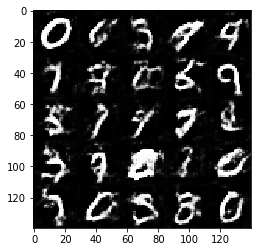

Epoch 3/3... Discriminator Loss: 1.2309... Generator Loss: 0.7981
Epoch 3/3... Discriminator Loss: 1.1209... Generator Loss: 0.8627
Epoch 3/3... Discriminator Loss: 1.2377... Generator Loss: 0.9397
Epoch 3/3... Discriminator Loss: 1.1483... Generator Loss: 0.7587
Epoch 3/3... Discriminator Loss: 1.3243... Generator Loss: 0.9011
Epoch 3/3... Discriminator Loss: 1.3781... Generator Loss: 0.7484
Epoch 3/3... Discriminator Loss: 1.4269... Generator Loss: 0.5614
Epoch 3/3... Discriminator Loss: 1.2489... Generator Loss: 0.8972
Epoch 3/3... Discriminator Loss: 1.1307... Generator Loss: 0.9429
Epoch 3/3... Discriminator Loss: 1.2167... Generator Loss: 1.0086


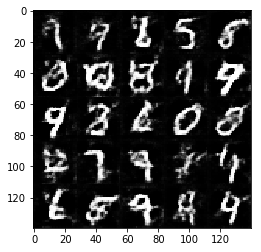

Epoch 3/3... Discriminator Loss: 1.2785... Generator Loss: 1.0503
Epoch 3/3... Discriminator Loss: 1.3884... Generator Loss: 0.8894
Epoch 3/3... Discriminator Loss: 1.1301... Generator Loss: 0.7664
Epoch 3/3... Discriminator Loss: 1.2203... Generator Loss: 0.7149
Epoch 3/3... Discriminator Loss: 1.3278... Generator Loss: 0.7436
Epoch 3/3... Discriminator Loss: 1.3816... Generator Loss: 0.5470
Epoch 3/3... Discriminator Loss: 1.2219... Generator Loss: 1.0601
Epoch 3/3... Discriminator Loss: 1.3870... Generator Loss: 1.3387
Epoch 3/3... Discriminator Loss: 1.2177... Generator Loss: 0.7772
Epoch 3/3... Discriminator Loss: 1.1036... Generator Loss: 1.2261


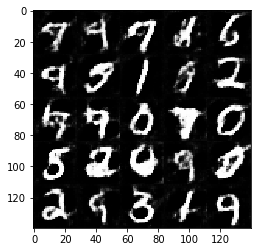

Epoch 3/3... Discriminator Loss: 1.3048... Generator Loss: 0.9199
Epoch 3/3... Discriminator Loss: 1.4601... Generator Loss: 0.5108
Epoch 3/3... Discriminator Loss: 1.4701... Generator Loss: 0.6939
Epoch 3/3... Discriminator Loss: 1.1791... Generator Loss: 0.9641
Epoch 3/3... Discriminator Loss: 1.2638... Generator Loss: 0.7209
Epoch 3/3... Discriminator Loss: 1.3314... Generator Loss: 0.8038
Epoch 3/3... Discriminator Loss: 1.1744... Generator Loss: 1.1254
Epoch 3/3... Discriminator Loss: 1.3194... Generator Loss: 0.7636
Epoch 3/3... Discriminator Loss: 1.2008... Generator Loss: 1.0886
Epoch 3/3... Discriminator Loss: 1.1875... Generator Loss: 1.0515


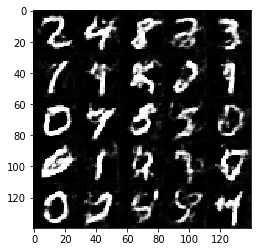

Epoch 3/3... Discriminator Loss: 1.3072... Generator Loss: 0.7493
Epoch 3/3... Discriminator Loss: 1.2760... Generator Loss: 0.9465
Epoch 3/3... Discriminator Loss: 1.4072... Generator Loss: 0.7366
Epoch 3/3... Discriminator Loss: 1.1868... Generator Loss: 0.7655
Epoch 3/3... Discriminator Loss: 1.1533... Generator Loss: 1.0390
Epoch 3/3... Discriminator Loss: 1.4766... Generator Loss: 1.3335
Epoch 3/3... Discriminator Loss: 1.1405... Generator Loss: 0.8693
Epoch 3/3... Discriminator Loss: 1.1997... Generator Loss: 0.9302
Epoch 3/3... Discriminator Loss: 1.2511... Generator Loss: 0.8095
Epoch 3/3... Discriminator Loss: 1.3340... Generator Loss: 0.7966


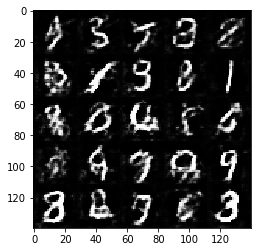

Epoch 3/3... Discriminator Loss: 1.2465... Generator Loss: 0.6839


In [21]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5
alpha = 0.2

tf.reset_default_graph()
"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 3

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))

with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Shape: (202599, 28, 28, 3)
Learning rate: 0.0002
Tensor("input_real:0", shape=(?, 28, 28, 3), dtype=float32)
Tensor("input_z:0", shape=(?, 100), dtype=float32)
Epoch 1/8... Discriminator Loss: 2.8972... Generator Loss: 0.0943
Epoch 1/8... Discriminator Loss: 0.3717... Generator Loss: 7.1293
Epoch 1/8... Discriminator Loss: 0.9751... Generator Loss: 0.8520
Epoch 1/8... Discriminator Loss: 0.5528... Generator Loss: 1.8244
Epoch 1/8... Discriminator Loss: 1.2481... Generator Loss: 0.6812
Epoch 1/8... Discriminator Loss: 1.9264... Generator Loss: 0.3464
Epoch 1/8... Discriminator Loss: 4.4561... Generator Loss: 0.0225
Epoch 1/8... Discriminator Loss: 1.4660... Generator Loss: 0.7730
Epoch 1/8... Discriminator Loss: 1.6436... Generator Loss: 0.8946
Epoch 1/8... Discriminator Loss: 1.1863... Generator Loss: 0.6426


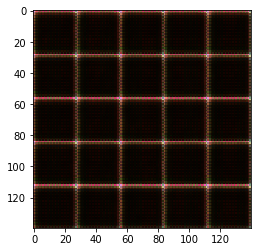

Epoch 1/8... Discriminator Loss: 3.9317... Generator Loss: 0.0433
Epoch 1/8... Discriminator Loss: 1.6519... Generator Loss: 0.4812
Epoch 1/8... Discriminator Loss: 1.1996... Generator Loss: 0.6696
Epoch 1/8... Discriminator Loss: 0.8955... Generator Loss: 1.0986
Epoch 1/8... Discriminator Loss: 1.0411... Generator Loss: 2.0508
Epoch 1/8... Discriminator Loss: 0.8639... Generator Loss: 1.3387
Epoch 1/8... Discriminator Loss: 1.2124... Generator Loss: 1.0487
Epoch 1/8... Discriminator Loss: 1.7435... Generator Loss: 0.4459
Epoch 1/8... Discriminator Loss: 2.0444... Generator Loss: 0.2366
Epoch 1/8... Discriminator Loss: 2.0426... Generator Loss: 0.3098


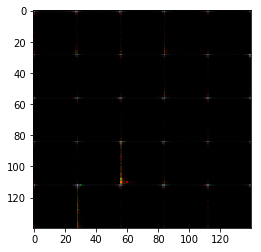

Epoch 1/8... Discriminator Loss: 1.1957... Generator Loss: 0.6893
Epoch 1/8... Discriminator Loss: 0.8082... Generator Loss: 1.1730
Epoch 1/8... Discriminator Loss: 1.1649... Generator Loss: 0.7060
Epoch 1/8... Discriminator Loss: 1.0622... Generator Loss: 0.9095
Epoch 1/8... Discriminator Loss: 0.7906... Generator Loss: 1.2013
Epoch 1/8... Discriminator Loss: 1.7398... Generator Loss: 0.3446
Epoch 1/8... Discriminator Loss: 0.6544... Generator Loss: 1.4862
Epoch 1/8... Discriminator Loss: 0.4062... Generator Loss: 3.7250
Epoch 1/8... Discriminator Loss: 1.2355... Generator Loss: 2.3402
Epoch 1/8... Discriminator Loss: 0.5916... Generator Loss: 2.0761


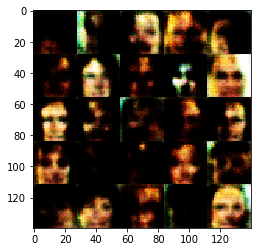

Epoch 1/8... Discriminator Loss: 1.4884... Generator Loss: 0.4464
Epoch 1/8... Discriminator Loss: 0.8268... Generator Loss: 1.6319
Epoch 1/8... Discriminator Loss: 0.7717... Generator Loss: 1.1933
Epoch 1/8... Discriminator Loss: 0.9675... Generator Loss: 0.9621
Epoch 1/8... Discriminator Loss: 0.9946... Generator Loss: 2.5354
Epoch 1/8... Discriminator Loss: 1.3584... Generator Loss: 0.5345
Epoch 1/8... Discriminator Loss: 0.9798... Generator Loss: 1.0858
Epoch 1/8... Discriminator Loss: 1.6005... Generator Loss: 0.4516
Epoch 1/8... Discriminator Loss: 0.6353... Generator Loss: 2.8181
Epoch 1/8... Discriminator Loss: 0.7098... Generator Loss: 1.4147


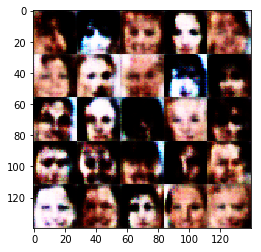

Epoch 1/8... Discriminator Loss: 1.3756... Generator Loss: 0.5569
Epoch 1/8... Discriminator Loss: 0.4414... Generator Loss: 3.5374
Epoch 1/8... Discriminator Loss: 0.7417... Generator Loss: 1.4692
Epoch 1/8... Discriminator Loss: 1.7294... Generator Loss: 0.4187
Epoch 1/8... Discriminator Loss: 2.7799... Generator Loss: 0.1166
Epoch 1/8... Discriminator Loss: 1.3268... Generator Loss: 0.5031
Epoch 1/8... Discriminator Loss: 1.0476... Generator Loss: 2.1691
Epoch 1/8... Discriminator Loss: 1.1119... Generator Loss: 0.7700
Epoch 1/8... Discriminator Loss: 1.3601... Generator Loss: 0.5366
Epoch 1/8... Discriminator Loss: 2.4618... Generator Loss: 0.1544


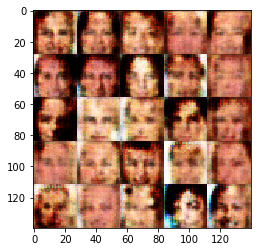

Epoch 1/8... Discriminator Loss: 2.2731... Generator Loss: 0.1977
Epoch 1/8... Discriminator Loss: 2.1222... Generator Loss: 0.2313
Epoch 1/8... Discriminator Loss: 1.0150... Generator Loss: 0.8297
Epoch 1/8... Discriminator Loss: 1.2528... Generator Loss: 0.6126
Epoch 1/8... Discriminator Loss: 1.4400... Generator Loss: 0.4595
Epoch 1/8... Discriminator Loss: 1.0566... Generator Loss: 1.0718
Epoch 1/8... Discriminator Loss: 1.1569... Generator Loss: 0.7016
Epoch 1/8... Discriminator Loss: 1.4454... Generator Loss: 2.5242
Epoch 1/8... Discriminator Loss: 2.2191... Generator Loss: 0.1853
Epoch 1/8... Discriminator Loss: 1.6707... Generator Loss: 0.3414


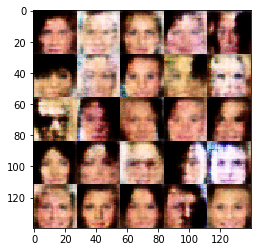

Epoch 1/8... Discriminator Loss: 1.0159... Generator Loss: 0.9349
Epoch 1/8... Discriminator Loss: 0.8971... Generator Loss: 1.5615
Epoch 1/8... Discriminator Loss: 0.8695... Generator Loss: 1.0526
Epoch 1/8... Discriminator Loss: 1.9380... Generator Loss: 0.2572
Epoch 1/8... Discriminator Loss: 1.1264... Generator Loss: 2.8170
Epoch 1/8... Discriminator Loss: 1.0362... Generator Loss: 0.8936
Epoch 1/8... Discriminator Loss: 1.2471... Generator Loss: 0.5932
Epoch 1/8... Discriminator Loss: 0.9678... Generator Loss: 0.8840
Epoch 1/8... Discriminator Loss: 1.5487... Generator Loss: 0.3674
Epoch 1/8... Discriminator Loss: 2.0427... Generator Loss: 0.2580


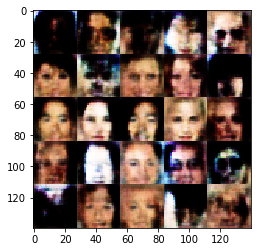

Epoch 1/8... Discriminator Loss: 0.6702... Generator Loss: 2.1132
Epoch 1/8... Discriminator Loss: 1.3189... Generator Loss: 0.4913
Epoch 1/8... Discriminator Loss: 1.1075... Generator Loss: 0.7246
Epoch 1/8... Discriminator Loss: 0.8829... Generator Loss: 1.0012
Epoch 1/8... Discriminator Loss: 0.9890... Generator Loss: 0.9639
Epoch 1/8... Discriminator Loss: 1.7359... Generator Loss: 0.3087
Epoch 1/8... Discriminator Loss: 1.0972... Generator Loss: 0.6916
Epoch 1/8... Discriminator Loss: 0.6967... Generator Loss: 1.7754
Epoch 1/8... Discriminator Loss: 0.8191... Generator Loss: 2.0154
Epoch 1/8... Discriminator Loss: 1.5255... Generator Loss: 2.6242


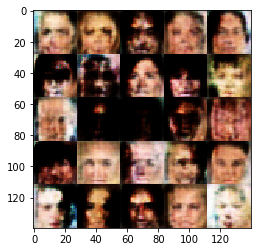

Epoch 1/8... Discriminator Loss: 1.4262... Generator Loss: 0.4607
Epoch 1/8... Discriminator Loss: 1.6904... Generator Loss: 0.3223
Epoch 1/8... Discriminator Loss: 1.3255... Generator Loss: 0.5162
Epoch 1/8... Discriminator Loss: 1.1388... Generator Loss: 0.6553
Epoch 1/8... Discriminator Loss: 1.5674... Generator Loss: 0.3732
Epoch 1/8... Discriminator Loss: 1.7581... Generator Loss: 0.3396
Epoch 1/8... Discriminator Loss: 0.9733... Generator Loss: 0.9915
Epoch 1/8... Discriminator Loss: 1.1078... Generator Loss: 2.3570
Epoch 1/8... Discriminator Loss: 0.9254... Generator Loss: 1.4141
Epoch 1/8... Discriminator Loss: 1.4124... Generator Loss: 0.4416


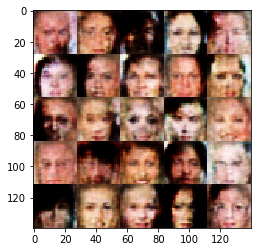

Epoch 1/8... Discriminator Loss: 1.6507... Generator Loss: 2.7155
Epoch 1/8... Discriminator Loss: 1.6887... Generator Loss: 0.3444
Epoch 1/8... Discriminator Loss: 1.0890... Generator Loss: 0.6891
Epoch 1/8... Discriminator Loss: 0.5776... Generator Loss: 2.0815
Epoch 1/8... Discriminator Loss: 1.4856... Generator Loss: 0.4342
Epoch 1/8... Discriminator Loss: 0.6826... Generator Loss: 2.9883
Epoch 1/8... Discriminator Loss: 1.9443... Generator Loss: 0.2523
Epoch 1/8... Discriminator Loss: 1.3499... Generator Loss: 0.4878
Epoch 1/8... Discriminator Loss: 0.8269... Generator Loss: 1.0786
Epoch 1/8... Discriminator Loss: 0.9972... Generator Loss: 0.9621


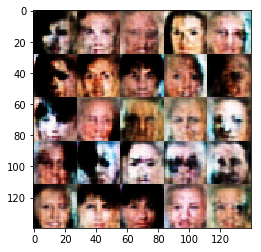

Epoch 1/8... Discriminator Loss: 0.7193... Generator Loss: 1.2736
Epoch 1/8... Discriminator Loss: 1.8665... Generator Loss: 0.2752
Epoch 1/8... Discriminator Loss: 1.4863... Generator Loss: 0.4160
Epoch 1/8... Discriminator Loss: 0.7722... Generator Loss: 1.2770
Epoch 1/8... Discriminator Loss: 0.7325... Generator Loss: 3.4685
Epoch 1/8... Discriminator Loss: 1.4019... Generator Loss: 0.4602
Epoch 1/8... Discriminator Loss: 0.7107... Generator Loss: 2.7013
Epoch 1/8... Discriminator Loss: 0.8677... Generator Loss: 1.5438
Epoch 1/8... Discriminator Loss: 1.5937... Generator Loss: 0.4265
Epoch 1/8... Discriminator Loss: 0.9688... Generator Loss: 1.7901


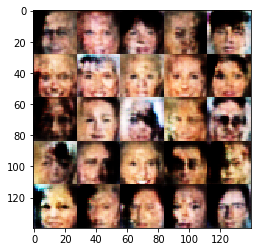

Epoch 1/8... Discriminator Loss: 1.6533... Generator Loss: 0.3527
Epoch 1/8... Discriminator Loss: 1.0651... Generator Loss: 3.4383
Epoch 1/8... Discriminator Loss: 1.0697... Generator Loss: 1.2203
Epoch 1/8... Discriminator Loss: 0.8696... Generator Loss: 1.4688
Epoch 1/8... Discriminator Loss: 1.8693... Generator Loss: 0.2807
Epoch 1/8... Discriminator Loss: 1.2701... Generator Loss: 0.5755
Epoch 1/8... Discriminator Loss: 0.8320... Generator Loss: 1.1848
Epoch 1/8... Discriminator Loss: 0.8819... Generator Loss: 1.7307
Epoch 1/8... Discriminator Loss: 1.8145... Generator Loss: 0.3190
Epoch 1/8... Discriminator Loss: 1.9843... Generator Loss: 0.2542


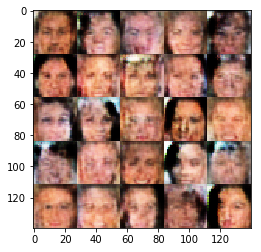

Epoch 1/8... Discriminator Loss: 1.7362... Generator Loss: 0.3327
Epoch 1/8... Discriminator Loss: 1.4182... Generator Loss: 0.4679
Epoch 1/8... Discriminator Loss: 1.8853... Generator Loss: 0.2746
Epoch 1/8... Discriminator Loss: 0.5958... Generator Loss: 1.9034
Epoch 1/8... Discriminator Loss: 1.3370... Generator Loss: 0.5190
Epoch 1/8... Discriminator Loss: 1.1160... Generator Loss: 0.7039
Epoch 1/8... Discriminator Loss: 1.8732... Generator Loss: 2.7560
Epoch 1/8... Discriminator Loss: 0.8759... Generator Loss: 1.3454
Epoch 1/8... Discriminator Loss: 0.7397... Generator Loss: 1.6814
Epoch 1/8... Discriminator Loss: 0.9409... Generator Loss: 1.2077


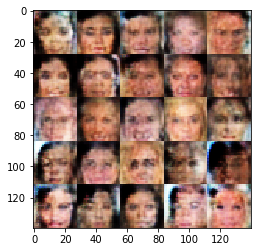

Epoch 1/8... Discriminator Loss: 1.3226... Generator Loss: 2.5790
Epoch 1/8... Discriminator Loss: 0.9657... Generator Loss: 0.9359
Epoch 1/8... Discriminator Loss: 1.2938... Generator Loss: 1.8172
Epoch 1/8... Discriminator Loss: 1.6699... Generator Loss: 0.3451
Epoch 1/8... Discriminator Loss: 0.8037... Generator Loss: 2.2590
Epoch 1/8... Discriminator Loss: 1.0292... Generator Loss: 2.4054
Epoch 1/8... Discriminator Loss: 1.4879... Generator Loss: 0.4021
Epoch 1/8... Discriminator Loss: 1.8628... Generator Loss: 0.2807
Epoch 1/8... Discriminator Loss: 1.8655... Generator Loss: 0.2850
Epoch 1/8... Discriminator Loss: 1.8405... Generator Loss: 0.2686


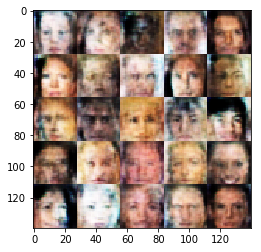

Epoch 1/8... Discriminator Loss: 1.8794... Generator Loss: 0.2888
Epoch 1/8... Discriminator Loss: 1.2098... Generator Loss: 0.6097
Epoch 1/8... Discriminator Loss: 0.9408... Generator Loss: 1.6269
Epoch 1/8... Discriminator Loss: 2.0387... Generator Loss: 0.2453
Epoch 1/8... Discriminator Loss: 1.0797... Generator Loss: 2.1997
Epoch 1/8... Discriminator Loss: 2.1317... Generator Loss: 0.2208
Epoch 1/8... Discriminator Loss: 1.0423... Generator Loss: 2.3441
Epoch 1/8... Discriminator Loss: 1.7397... Generator Loss: 3.5240
Epoch 1/8... Discriminator Loss: 1.8047... Generator Loss: 0.3019
Epoch 1/8... Discriminator Loss: 0.9566... Generator Loss: 1.8560


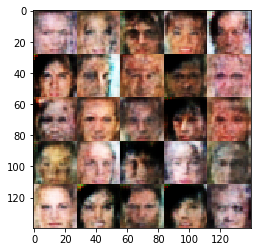

Epoch 1/8... Discriminator Loss: 1.1909... Generator Loss: 0.6008
Epoch 1/8... Discriminator Loss: 1.0042... Generator Loss: 0.8112
Epoch 1/8... Discriminator Loss: 0.8489... Generator Loss: 1.3092
Epoch 1/8... Discriminator Loss: 0.9988... Generator Loss: 0.8678
Epoch 1/8... Discriminator Loss: 1.0114... Generator Loss: 1.0102
Epoch 1/8... Discriminator Loss: 1.8605... Generator Loss: 0.2753
Epoch 1/8... Discriminator Loss: 1.6107... Generator Loss: 2.4411
Epoch 1/8... Discriminator Loss: 1.8051... Generator Loss: 0.3037
Epoch 1/8... Discriminator Loss: 2.1952... Generator Loss: 0.2141
Epoch 1/8... Discriminator Loss: 1.8794... Generator Loss: 0.2862


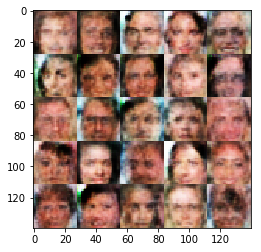

Epoch 1/8... Discriminator Loss: 2.0925... Generator Loss: 0.2333
Epoch 1/8... Discriminator Loss: 0.9047... Generator Loss: 1.1598
Epoch 1/8... Discriminator Loss: 0.9021... Generator Loss: 1.2930
Epoch 1/8... Discriminator Loss: 1.2351... Generator Loss: 0.5703
Epoch 1/8... Discriminator Loss: 1.0511... Generator Loss: 1.6100
Epoch 1/8... Discriminator Loss: 0.8565... Generator Loss: 1.4643
Epoch 1/8... Discriminator Loss: 1.3262... Generator Loss: 2.5651
Epoch 1/8... Discriminator Loss: 0.9194... Generator Loss: 1.3258
Epoch 1/8... Discriminator Loss: 1.3349... Generator Loss: 0.4877
Epoch 1/8... Discriminator Loss: 2.0311... Generator Loss: 0.2401


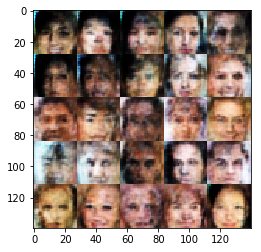

Epoch 1/8... Discriminator Loss: 1.8346... Generator Loss: 0.2853
Epoch 1/8... Discriminator Loss: 1.0296... Generator Loss: 0.8856
Epoch 1/8... Discriminator Loss: 2.4167... Generator Loss: 0.1569
Epoch 1/8... Discriminator Loss: 0.9426... Generator Loss: 2.0205
Epoch 1/8... Discriminator Loss: 0.8121... Generator Loss: 1.3554
Epoch 1/8... Discriminator Loss: 1.2669... Generator Loss: 2.8467
Epoch 1/8... Discriminator Loss: 1.9886... Generator Loss: 0.2544
Epoch 1/8... Discriminator Loss: 1.2407... Generator Loss: 1.9537
Epoch 1/8... Discriminator Loss: 1.3215... Generator Loss: 0.5660
Epoch 1/8... Discriminator Loss: 1.2371... Generator Loss: 0.6148


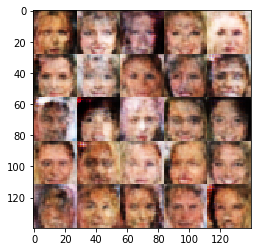

Epoch 1/8... Discriminator Loss: 2.0990... Generator Loss: 0.2179
Epoch 1/8... Discriminator Loss: 1.1597... Generator Loss: 0.6633
Epoch 1/8... Discriminator Loss: 2.0357... Generator Loss: 0.2278
Epoch 1/8... Discriminator Loss: 1.1973... Generator Loss: 0.6262
Epoch 1/8... Discriminator Loss: 2.5176... Generator Loss: 0.1427
Epoch 1/8... Discriminator Loss: 1.1546... Generator Loss: 0.7060
Epoch 1/8... Discriminator Loss: 1.4680... Generator Loss: 0.4438
Epoch 1/8... Discriminator Loss: 1.0605... Generator Loss: 1.8112
Epoch 1/8... Discriminator Loss: 1.5125... Generator Loss: 0.4042
Epoch 1/8... Discriminator Loss: 1.2927... Generator Loss: 0.5581


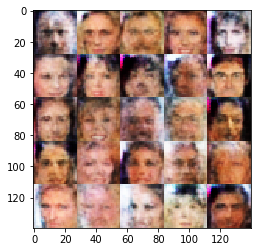

Epoch 1/8... Discriminator Loss: 1.0590... Generator Loss: 1.6588
Epoch 1/8... Discriminator Loss: 1.6236... Generator Loss: 0.3591
Epoch 1/8... Discriminator Loss: 1.5844... Generator Loss: 0.3785
Epoch 1/8... Discriminator Loss: 0.8533... Generator Loss: 1.1145
Epoch 1/8... Discriminator Loss: 0.9755... Generator Loss: 1.0445
Epoch 1/8... Discriminator Loss: 0.9689... Generator Loss: 1.1046
Epoch 1/8... Discriminator Loss: 1.7073... Generator Loss: 0.3267
Epoch 1/8... Discriminator Loss: 0.9473... Generator Loss: 1.1689
Epoch 1/8... Discriminator Loss: 1.0471... Generator Loss: 1.0895
Epoch 1/8... Discriminator Loss: 1.3421... Generator Loss: 0.5612


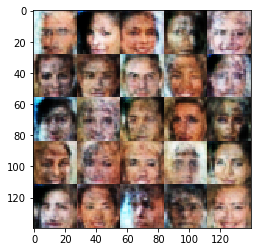

Epoch 1/8... Discriminator Loss: 1.0552... Generator Loss: 1.5450
Epoch 1/8... Discriminator Loss: 1.6954... Generator Loss: 0.3375
Epoch 1/8... Discriminator Loss: 1.1688... Generator Loss: 0.6591
Epoch 1/8... Discriminator Loss: 0.9658... Generator Loss: 2.0552
Epoch 1/8... Discriminator Loss: 0.9720... Generator Loss: 1.1350
Epoch 1/8... Discriminator Loss: 1.7423... Generator Loss: 0.3471
Epoch 1/8... Discriminator Loss: 2.1950... Generator Loss: 0.1884
Epoch 1/8... Discriminator Loss: 2.3720... Generator Loss: 0.1598
Epoch 1/8... Discriminator Loss: 0.9140... Generator Loss: 1.3391
Epoch 1/8... Discriminator Loss: 2.5188... Generator Loss: 0.1309


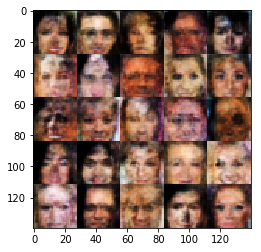

Epoch 1/8... Discriminator Loss: 1.2961... Generator Loss: 0.5212
Epoch 1/8... Discriminator Loss: 1.9727... Generator Loss: 0.2582
Epoch 1/8... Discriminator Loss: 1.7070... Generator Loss: 0.3447
Epoch 1/8... Discriminator Loss: 1.1108... Generator Loss: 2.0036
Epoch 1/8... Discriminator Loss: 1.2849... Generator Loss: 0.5913
Epoch 1/8... Discriminator Loss: 1.0799... Generator Loss: 0.9681
Epoch 1/8... Discriminator Loss: 0.9902... Generator Loss: 1.4862
Epoch 1/8... Discriminator Loss: 1.1494... Generator Loss: 2.0761
Epoch 1/8... Discriminator Loss: 1.6041... Generator Loss: 0.3630
Epoch 1/8... Discriminator Loss: 1.7746... Generator Loss: 0.3053


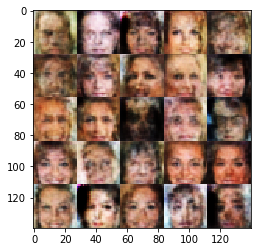

Epoch 1/8... Discriminator Loss: 1.1378... Generator Loss: 2.1078
Epoch 1/8... Discriminator Loss: 1.1476... Generator Loss: 0.7024
Epoch 1/8... Discriminator Loss: 1.2209... Generator Loss: 0.6542
Epoch 1/8... Discriminator Loss: 0.9805... Generator Loss: 1.5094
Epoch 1/8... Discriminator Loss: 1.4160... Generator Loss: 0.4444
Epoch 1/8... Discriminator Loss: 1.0791... Generator Loss: 0.9869
Epoch 1/8... Discriminator Loss: 1.8353... Generator Loss: 0.2900
Epoch 1/8... Discriminator Loss: 1.9992... Generator Loss: 0.2525
Epoch 1/8... Discriminator Loss: 1.6800... Generator Loss: 0.3421
Epoch 1/8... Discriminator Loss: 2.3851... Generator Loss: 0.1599


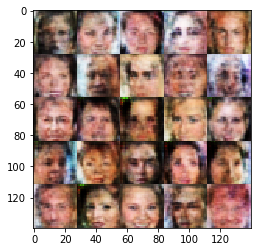

Epoch 1/8... Discriminator Loss: 2.0211... Generator Loss: 0.2429
Epoch 1/8... Discriminator Loss: 1.4497... Generator Loss: 0.4684
Epoch 1/8... Discriminator Loss: 0.9768... Generator Loss: 1.1579
Epoch 1/8... Discriminator Loss: 1.5479... Generator Loss: 0.4218
Epoch 1/8... Discriminator Loss: 1.5982... Generator Loss: 0.3965
Epoch 1/8... Discriminator Loss: 1.1114... Generator Loss: 0.7031
Epoch 1/8... Discriminator Loss: 2.1500... Generator Loss: 0.2077
Epoch 1/8... Discriminator Loss: 1.4464... Generator Loss: 0.4567
Epoch 1/8... Discriminator Loss: 1.7920... Generator Loss: 0.3034
Epoch 1/8... Discriminator Loss: 2.2005... Generator Loss: 0.1978


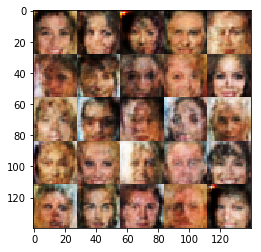

Epoch 1/8... Discriminator Loss: 1.9364... Generator Loss: 0.2703
Epoch 1/8... Discriminator Loss: 1.7156... Generator Loss: 0.3175
Epoch 1/8... Discriminator Loss: 0.9722... Generator Loss: 1.3953
Epoch 1/8... Discriminator Loss: 1.1139... Generator Loss: 0.7929
Epoch 1/8... Discriminator Loss: 1.7417... Generator Loss: 0.3012
Epoch 1/8... Discriminator Loss: 1.0756... Generator Loss: 1.1495
Epoch 1/8... Discriminator Loss: 1.0875... Generator Loss: 0.9745
Epoch 1/8... Discriminator Loss: 1.6283... Generator Loss: 0.3580
Epoch 1/8... Discriminator Loss: 1.6530... Generator Loss: 0.3503
Epoch 1/8... Discriminator Loss: 1.4804... Generator Loss: 0.4553


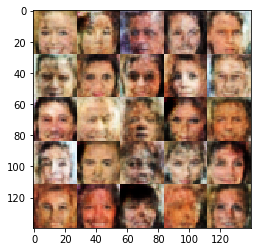

Epoch 1/8... Discriminator Loss: 1.2755... Generator Loss: 0.5973
Epoch 1/8... Discriminator Loss: 1.6680... Generator Loss: 0.3389
Epoch 1/8... Discriminator Loss: 1.9129... Generator Loss: 0.2651
Epoch 1/8... Discriminator Loss: 1.5637... Generator Loss: 0.3862
Epoch 1/8... Discriminator Loss: 1.7918... Generator Loss: 0.3065
Epoch 1/8... Discriminator Loss: 1.0529... Generator Loss: 1.0528
Epoch 1/8... Discriminator Loss: 1.2618... Generator Loss: 0.5705
Epoch 1/8... Discriminator Loss: 1.8453... Generator Loss: 0.2888
Epoch 1/8... Discriminator Loss: 1.8282... Generator Loss: 0.3010
Epoch 1/8... Discriminator Loss: 2.1033... Generator Loss: 0.2043


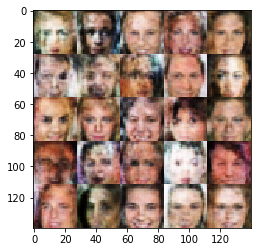

Epoch 1/8... Discriminator Loss: 1.8007... Generator Loss: 0.3075
Epoch 1/8... Discriminator Loss: 0.9383... Generator Loss: 1.2454
Epoch 1/8... Discriminator Loss: 2.4515... Generator Loss: 0.1452
Epoch 1/8... Discriminator Loss: 1.0817... Generator Loss: 1.6867
Epoch 1/8... Discriminator Loss: 1.3128... Generator Loss: 0.5867
Epoch 1/8... Discriminator Loss: 1.9933... Generator Loss: 0.2427
Epoch 1/8... Discriminator Loss: 1.5464... Generator Loss: 0.4092
Epoch 1/8... Discriminator Loss: 1.3501... Generator Loss: 2.0317
Epoch 1/8... Discriminator Loss: 2.4148... Generator Loss: 0.1553
Epoch 1/8... Discriminator Loss: 2.1895... Generator Loss: 0.1903


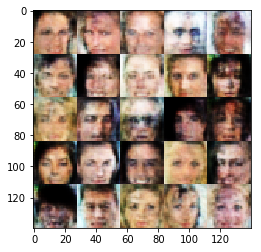

Epoch 1/8... Discriminator Loss: 1.4225... Generator Loss: 0.5054
Epoch 1/8... Discriminator Loss: 1.1818... Generator Loss: 0.6858
Epoch 1/8... Discriminator Loss: 1.1385... Generator Loss: 1.0279
Epoch 1/8... Discriminator Loss: 1.1956... Generator Loss: 0.7590
Epoch 1/8... Discriminator Loss: 1.0914... Generator Loss: 1.7357
Epoch 1/8... Discriminator Loss: 2.3130... Generator Loss: 0.1884
Epoch 1/8... Discriminator Loss: 1.7088... Generator Loss: 0.3218
Epoch 1/8... Discriminator Loss: 1.5009... Generator Loss: 0.4723
Epoch 1/8... Discriminator Loss: 1.3128... Generator Loss: 0.6544
Epoch 1/8... Discriminator Loss: 1.5261... Generator Loss: 0.4488


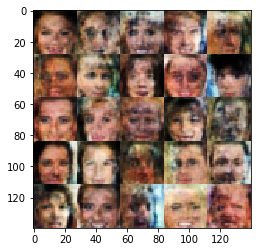

Epoch 1/8... Discriminator Loss: 1.3736... Generator Loss: 0.5713
Epoch 1/8... Discriminator Loss: 1.9037... Generator Loss: 0.2854
Epoch 1/8... Discriminator Loss: 1.2035... Generator Loss: 1.0168
Epoch 1/8... Discriminator Loss: 1.1806... Generator Loss: 1.3286
Epoch 1/8... Discriminator Loss: 1.7190... Generator Loss: 0.3175
Epoch 1/8... Discriminator Loss: 1.4646... Generator Loss: 0.4430
Epoch 1/8... Discriminator Loss: 1.1735... Generator Loss: 0.7864
Epoch 1/8... Discriminator Loss: 1.1947... Generator Loss: 0.6984
Epoch 1/8... Discriminator Loss: 1.2966... Generator Loss: 0.5702
Epoch 1/8... Discriminator Loss: 1.1629... Generator Loss: 1.1552


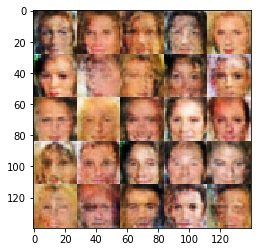

Epoch 1/8... Discriminator Loss: 1.1077... Generator Loss: 0.8621
Epoch 1/8... Discriminator Loss: 1.0357... Generator Loss: 1.4238
Epoch 1/8... Discriminator Loss: 1.6404... Generator Loss: 0.3571
Epoch 1/8... Discriminator Loss: 1.0822... Generator Loss: 1.0600
Epoch 1/8... Discriminator Loss: 1.1075... Generator Loss: 1.1228
Epoch 1/8... Discriminator Loss: 1.2408... Generator Loss: 1.7362
Epoch 1/8... Discriminator Loss: 0.9359... Generator Loss: 1.3909
Epoch 1/8... Discriminator Loss: 1.6859... Generator Loss: 0.3552
Epoch 1/8... Discriminator Loss: 2.0139... Generator Loss: 0.2202
Epoch 1/8... Discriminator Loss: 1.1757... Generator Loss: 0.7270


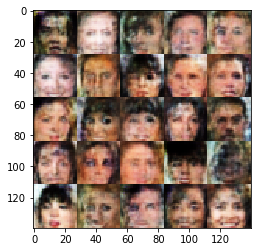

Epoch 1/8... Discriminator Loss: 2.2966... Generator Loss: 0.1750
Epoch 1/8... Discriminator Loss: 1.7630... Generator Loss: 0.3137
Epoch 1/8... Discriminator Loss: 2.0266... Generator Loss: 0.2377
Epoch 1/8... Discriminator Loss: 1.8341... Generator Loss: 0.2900
Epoch 1/8... Discriminator Loss: 1.5135... Generator Loss: 0.4524
Epoch 1/8... Discriminator Loss: 1.4427... Generator Loss: 1.8291
Epoch 1/8... Discriminator Loss: 1.1911... Generator Loss: 1.7729
Epoch 1/8... Discriminator Loss: 1.5475... Generator Loss: 0.3771
Epoch 1/8... Discriminator Loss: 1.1052... Generator Loss: 1.2125
Epoch 1/8... Discriminator Loss: 1.1768... Generator Loss: 0.8088


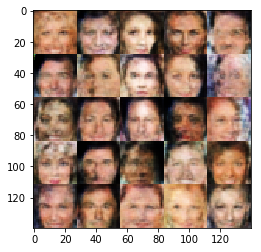

Epoch 1/8... Discriminator Loss: 1.1172... Generator Loss: 1.0005
Epoch 1/8... Discriminator Loss: 1.3345... Generator Loss: 2.1737
Epoch 1/8... Discriminator Loss: 1.1891... Generator Loss: 0.7527
Epoch 1/8... Discriminator Loss: 1.6321... Generator Loss: 0.3611
Epoch 1/8... Discriminator Loss: 1.0608... Generator Loss: 0.8886
Epoch 1/8... Discriminator Loss: 1.1933... Generator Loss: 0.9752
Epoch 2/8... Discriminator Loss: 1.1447... Generator Loss: 1.0245
Epoch 2/8... Discriminator Loss: 1.7573... Generator Loss: 0.3121
Epoch 2/8... Discriminator Loss: 1.9110... Generator Loss: 0.2482
Epoch 2/8... Discriminator Loss: 1.4658... Generator Loss: 0.4422


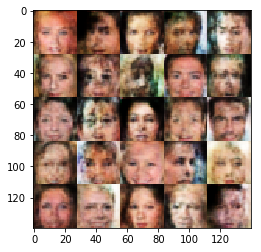

Epoch 2/8... Discriminator Loss: 1.8463... Generator Loss: 0.2983
Epoch 2/8... Discriminator Loss: 1.8087... Generator Loss: 0.2892
Epoch 2/8... Discriminator Loss: 1.2769... Generator Loss: 0.8364
Epoch 2/8... Discriminator Loss: 1.2375... Generator Loss: 0.6419
Epoch 2/8... Discriminator Loss: 2.1739... Generator Loss: 0.1935
Epoch 2/8... Discriminator Loss: 1.6564... Generator Loss: 0.3585
Epoch 2/8... Discriminator Loss: 2.2386... Generator Loss: 0.1841
Epoch 2/8... Discriminator Loss: 1.4966... Generator Loss: 0.4618
Epoch 2/8... Discriminator Loss: 2.0322... Generator Loss: 0.2460
Epoch 2/8... Discriminator Loss: 1.7998... Generator Loss: 0.2820


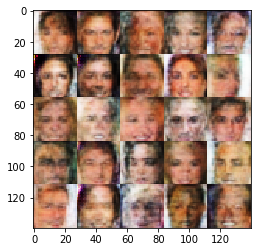

Epoch 2/8... Discriminator Loss: 1.6134... Generator Loss: 0.3542
Epoch 2/8... Discriminator Loss: 1.5841... Generator Loss: 0.3799
Epoch 2/8... Discriminator Loss: 1.5185... Generator Loss: 0.4013
Epoch 2/8... Discriminator Loss: 1.4805... Generator Loss: 0.3994
Epoch 2/8... Discriminator Loss: 1.1846... Generator Loss: 0.6513
Epoch 2/8... Discriminator Loss: 1.0982... Generator Loss: 1.2341
Epoch 2/8... Discriminator Loss: 1.5278... Generator Loss: 0.4138
Epoch 2/8... Discriminator Loss: 1.8254... Generator Loss: 0.2933
Epoch 2/8... Discriminator Loss: 1.2689... Generator Loss: 0.6908
Epoch 2/8... Discriminator Loss: 1.1561... Generator Loss: 0.7505


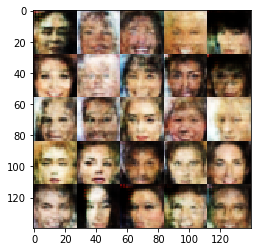

Epoch 2/8... Discriminator Loss: 1.1092... Generator Loss: 1.0932
Epoch 2/8... Discriminator Loss: 1.2152... Generator Loss: 0.6258
Epoch 2/8... Discriminator Loss: 1.0918... Generator Loss: 1.1687
Epoch 2/8... Discriminator Loss: 1.1348... Generator Loss: 1.0333
Epoch 2/8... Discriminator Loss: 2.0074... Generator Loss: 0.2196
Epoch 2/8... Discriminator Loss: 1.0203... Generator Loss: 1.2495
Epoch 2/8... Discriminator Loss: 1.0839... Generator Loss: 0.8678
Epoch 2/8... Discriminator Loss: 1.4069... Generator Loss: 0.5053
Epoch 2/8... Discriminator Loss: 1.1217... Generator Loss: 0.7699
Epoch 2/8... Discriminator Loss: 2.4177... Generator Loss: 0.1535


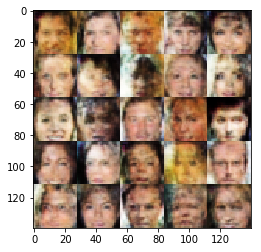

Epoch 2/8... Discriminator Loss: 1.2012... Generator Loss: 0.8019
Epoch 2/8... Discriminator Loss: 1.1364... Generator Loss: 0.7948
Epoch 2/8... Discriminator Loss: 1.5540... Generator Loss: 0.3813
Epoch 2/8... Discriminator Loss: 1.2727... Generator Loss: 1.3994
Epoch 2/8... Discriminator Loss: 1.0359... Generator Loss: 0.9894
Epoch 2/8... Discriminator Loss: 1.4068... Generator Loss: 0.5539
Epoch 2/8... Discriminator Loss: 2.0486... Generator Loss: 0.2304
Epoch 2/8... Discriminator Loss: 1.6583... Generator Loss: 0.3361
Epoch 2/8... Discriminator Loss: 1.2439... Generator Loss: 0.8121
Epoch 2/8... Discriminator Loss: 1.7365... Generator Loss: 0.2995


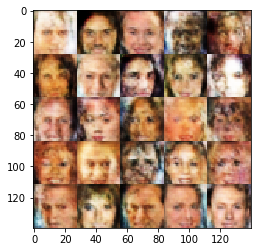

Epoch 2/8... Discriminator Loss: 1.8685... Generator Loss: 0.2645
Epoch 2/8... Discriminator Loss: 2.0636... Generator Loss: 0.2266
Epoch 2/8... Discriminator Loss: 1.7730... Generator Loss: 0.3190
Epoch 2/8... Discriminator Loss: 1.4760... Generator Loss: 0.4307
Epoch 2/8... Discriminator Loss: 1.0728... Generator Loss: 1.4275
Epoch 2/8... Discriminator Loss: 1.9776... Generator Loss: 0.2479
Epoch 2/8... Discriminator Loss: 1.8440... Generator Loss: 0.2919
Epoch 2/8... Discriminator Loss: 1.3661... Generator Loss: 0.5338
Epoch 2/8... Discriminator Loss: 1.1833... Generator Loss: 1.0648
Epoch 2/8... Discriminator Loss: 1.9820... Generator Loss: 0.2346


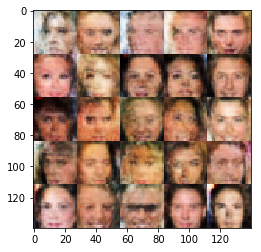

Epoch 2/8... Discriminator Loss: 1.5144... Generator Loss: 0.4023
Epoch 2/8... Discriminator Loss: 1.0724... Generator Loss: 0.7341
Epoch 2/8... Discriminator Loss: 1.4579... Generator Loss: 0.4359
Epoch 2/8... Discriminator Loss: 1.7619... Generator Loss: 0.2942
Epoch 2/8... Discriminator Loss: 1.2511... Generator Loss: 1.8947
Epoch 2/8... Discriminator Loss: 1.1585... Generator Loss: 1.0988
Epoch 2/8... Discriminator Loss: 1.2175... Generator Loss: 1.1590
Epoch 2/8... Discriminator Loss: 1.3022... Generator Loss: 0.7968
Epoch 2/8... Discriminator Loss: 1.3860... Generator Loss: 0.5399
Epoch 2/8... Discriminator Loss: 0.9776... Generator Loss: 1.4305


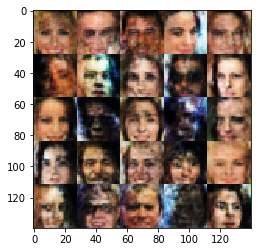

Epoch 2/8... Discriminator Loss: 1.4804... Generator Loss: 0.4366
Epoch 2/8... Discriminator Loss: 1.6316... Generator Loss: 0.3715
Epoch 2/8... Discriminator Loss: 1.2205... Generator Loss: 0.9964
Epoch 2/8... Discriminator Loss: 1.1974... Generator Loss: 1.1593
Epoch 2/8... Discriminator Loss: 1.3491... Generator Loss: 0.5941
Epoch 2/8... Discriminator Loss: 1.1834... Generator Loss: 1.1053
Epoch 2/8... Discriminator Loss: 1.1187... Generator Loss: 0.8459
Epoch 2/8... Discriminator Loss: 1.8008... Generator Loss: 0.2900
Epoch 2/8... Discriminator Loss: 1.2315... Generator Loss: 1.4115
Epoch 2/8... Discriminator Loss: 1.3753... Generator Loss: 0.5095


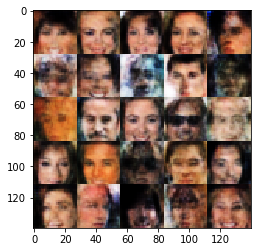

Epoch 2/8... Discriminator Loss: 1.5669... Generator Loss: 0.4320
Epoch 2/8... Discriminator Loss: 1.3864... Generator Loss: 0.5595
Epoch 2/8... Discriminator Loss: 1.4229... Generator Loss: 0.4714
Epoch 2/8... Discriminator Loss: 1.1086... Generator Loss: 1.3573
Epoch 2/8... Discriminator Loss: 1.4846... Generator Loss: 0.4429
Epoch 2/8... Discriminator Loss: 1.8223... Generator Loss: 0.2858
Epoch 2/8... Discriminator Loss: 1.3865... Generator Loss: 0.5294
Epoch 2/8... Discriminator Loss: 1.1604... Generator Loss: 1.5187
Epoch 2/8... Discriminator Loss: 1.1361... Generator Loss: 0.8466
Epoch 2/8... Discriminator Loss: 1.2643... Generator Loss: 0.6048


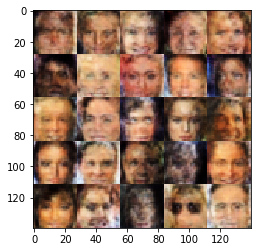

Epoch 2/8... Discriminator Loss: 1.4007... Generator Loss: 0.5012
Epoch 2/8... Discriminator Loss: 1.5252... Generator Loss: 0.4296
Epoch 2/8... Discriminator Loss: 1.9207... Generator Loss: 0.2605
Epoch 2/8... Discriminator Loss: 1.2878... Generator Loss: 0.5203
Epoch 2/8... Discriminator Loss: 1.6460... Generator Loss: 0.3529
Epoch 2/8... Discriminator Loss: 1.2252... Generator Loss: 0.9941
Epoch 2/8... Discriminator Loss: 1.4999... Generator Loss: 0.4193
Epoch 2/8... Discriminator Loss: 1.7944... Generator Loss: 0.2904
Epoch 2/8... Discriminator Loss: 1.2459... Generator Loss: 0.6258
Epoch 2/8... Discriminator Loss: 1.2861... Generator Loss: 1.4092


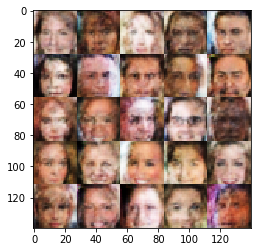

Epoch 2/8... Discriminator Loss: 1.5877... Generator Loss: 0.3619
Epoch 2/8... Discriminator Loss: 1.8185... Generator Loss: 0.2959
Epoch 2/8... Discriminator Loss: 1.6262... Generator Loss: 0.4008
Epoch 2/8... Discriminator Loss: 1.7251... Generator Loss: 0.3157
Epoch 2/8... Discriminator Loss: 1.3079... Generator Loss: 0.5636
Epoch 2/8... Discriminator Loss: 1.1888... Generator Loss: 0.6723
Epoch 2/8... Discriminator Loss: 2.1838... Generator Loss: 0.1891
Epoch 2/8... Discriminator Loss: 1.4325... Generator Loss: 0.4890
Epoch 2/8... Discriminator Loss: 1.5634... Generator Loss: 0.4047
Epoch 2/8... Discriminator Loss: 1.8902... Generator Loss: 0.2598


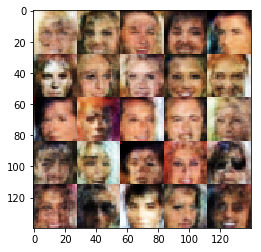

Epoch 2/8... Discriminator Loss: 1.2168... Generator Loss: 0.8005
Epoch 2/8... Discriminator Loss: 1.2617... Generator Loss: 1.3343
Epoch 2/8... Discriminator Loss: 1.2365... Generator Loss: 0.9406
Epoch 2/8... Discriminator Loss: 1.5343... Generator Loss: 0.4105
Epoch 2/8... Discriminator Loss: 1.3418... Generator Loss: 0.5102
Epoch 2/8... Discriminator Loss: 1.6681... Generator Loss: 0.3485
Epoch 2/8... Discriminator Loss: 1.6973... Generator Loss: 0.3765
Epoch 2/8... Discriminator Loss: 1.5851... Generator Loss: 0.4178
Epoch 2/8... Discriminator Loss: 2.1113... Generator Loss: 0.2057
Epoch 2/8... Discriminator Loss: 1.2482... Generator Loss: 0.6577


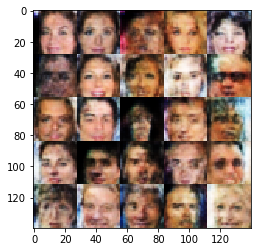

Epoch 2/8... Discriminator Loss: 1.2904... Generator Loss: 1.9793
Epoch 2/8... Discriminator Loss: 1.2880... Generator Loss: 0.6458
Epoch 2/8... Discriminator Loss: 1.5198... Generator Loss: 0.4020
Epoch 2/8... Discriminator Loss: 1.5207... Generator Loss: 0.4078
Epoch 2/8... Discriminator Loss: 1.7912... Generator Loss: 0.2989
Epoch 2/8... Discriminator Loss: 1.1225... Generator Loss: 1.0664
Epoch 2/8... Discriminator Loss: 1.2863... Generator Loss: 0.6340
Epoch 2/8... Discriminator Loss: 1.4832... Generator Loss: 0.4385
Epoch 2/8... Discriminator Loss: 1.1150... Generator Loss: 0.7606
Epoch 2/8... Discriminator Loss: 1.2396... Generator Loss: 0.6443


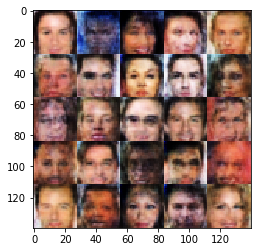

Epoch 2/8... Discriminator Loss: 1.8287... Generator Loss: 0.2950
Epoch 2/8... Discriminator Loss: 1.3956... Generator Loss: 0.5532
Epoch 2/8... Discriminator Loss: 1.3054... Generator Loss: 0.5978
Epoch 2/8... Discriminator Loss: 1.3686... Generator Loss: 1.3610
Epoch 2/8... Discriminator Loss: 1.3053... Generator Loss: 1.3611
Epoch 2/8... Discriminator Loss: 1.2284... Generator Loss: 0.8319
Epoch 2/8... Discriminator Loss: 1.0876... Generator Loss: 1.1648
Epoch 2/8... Discriminator Loss: 1.2007... Generator Loss: 0.9265
Epoch 2/8... Discriminator Loss: 1.1696... Generator Loss: 0.7758
Epoch 2/8... Discriminator Loss: 1.5676... Generator Loss: 0.3807


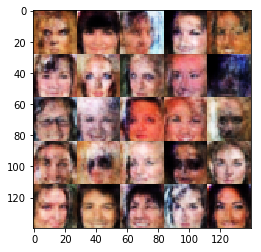

Epoch 2/8... Discriminator Loss: 1.1624... Generator Loss: 0.9670
Epoch 2/8... Discriminator Loss: 1.8468... Generator Loss: 0.2687
Epoch 2/8... Discriminator Loss: 2.2129... Generator Loss: 0.1956
Epoch 2/8... Discriminator Loss: 1.6290... Generator Loss: 0.3549
Epoch 2/8... Discriminator Loss: 1.0865... Generator Loss: 0.8529
Epoch 2/8... Discriminator Loss: 1.1714... Generator Loss: 1.2773
Epoch 2/8... Discriminator Loss: 1.2647... Generator Loss: 0.6057
Epoch 2/8... Discriminator Loss: 1.3995... Generator Loss: 0.5332
Epoch 2/8... Discriminator Loss: 1.6828... Generator Loss: 0.3276
Epoch 2/8... Discriminator Loss: 1.7782... Generator Loss: 0.2911


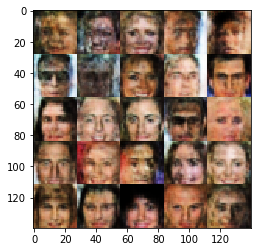

Epoch 2/8... Discriminator Loss: 1.1284... Generator Loss: 1.1933
Epoch 2/8... Discriminator Loss: 1.1862... Generator Loss: 0.8469
Epoch 2/8... Discriminator Loss: 1.3422... Generator Loss: 0.5435
Epoch 2/8... Discriminator Loss: 1.1414... Generator Loss: 0.8863
Epoch 2/8... Discriminator Loss: 1.8422... Generator Loss: 0.2854
Epoch 2/8... Discriminator Loss: 1.0694... Generator Loss: 1.0409
Epoch 2/8... Discriminator Loss: 1.3820... Generator Loss: 0.6275
Epoch 2/8... Discriminator Loss: 1.4538... Generator Loss: 0.5586
Epoch 2/8... Discriminator Loss: 1.2963... Generator Loss: 0.6103
Epoch 2/8... Discriminator Loss: 1.6379... Generator Loss: 0.3480


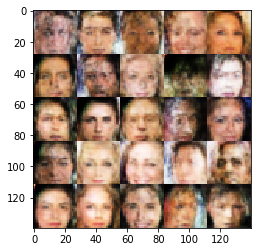

Epoch 2/8... Discriminator Loss: 1.5190... Generator Loss: 0.4266
Epoch 2/8... Discriminator Loss: 1.7655... Generator Loss: 0.2904
Epoch 2/8... Discriminator Loss: 1.1690... Generator Loss: 1.1758
Epoch 2/8... Discriminator Loss: 1.6398... Generator Loss: 0.3528
Epoch 2/8... Discriminator Loss: 1.3826... Generator Loss: 0.5631
Epoch 2/8... Discriminator Loss: 1.3311... Generator Loss: 0.6118
Epoch 2/8... Discriminator Loss: 1.3029... Generator Loss: 0.5918
Epoch 2/8... Discriminator Loss: 1.7748... Generator Loss: 0.3306
Epoch 2/8... Discriminator Loss: 1.7354... Generator Loss: 0.3259
Epoch 2/8... Discriminator Loss: 1.6871... Generator Loss: 0.3460


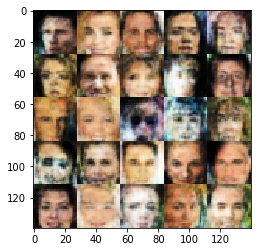

Epoch 2/8... Discriminator Loss: 1.5250... Generator Loss: 0.3921
Epoch 2/8... Discriminator Loss: 1.9718... Generator Loss: 0.2696
Epoch 2/8... Discriminator Loss: 1.9196... Generator Loss: 0.2901
Epoch 2/8... Discriminator Loss: 1.4128... Generator Loss: 0.4968
Epoch 2/8... Discriminator Loss: 1.2119... Generator Loss: 1.0128
Epoch 2/8... Discriminator Loss: 1.2505... Generator Loss: 0.8089
Epoch 2/8... Discriminator Loss: 1.0982... Generator Loss: 1.1320
Epoch 2/8... Discriminator Loss: 1.5828... Generator Loss: 0.3716
Epoch 2/8... Discriminator Loss: 1.7766... Generator Loss: 0.2984
Epoch 2/8... Discriminator Loss: 1.5496... Generator Loss: 0.4265


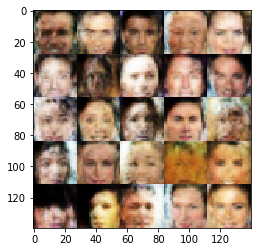

Epoch 2/8... Discriminator Loss: 1.2181... Generator Loss: 0.8207
Epoch 2/8... Discriminator Loss: 1.0667... Generator Loss: 1.0919
Epoch 2/8... Discriminator Loss: 1.4701... Generator Loss: 0.4494
Epoch 2/8... Discriminator Loss: 1.3885... Generator Loss: 0.4948
Epoch 2/8... Discriminator Loss: 1.4258... Generator Loss: 0.4818
Epoch 2/8... Discriminator Loss: 1.5508... Generator Loss: 0.4123
Epoch 2/8... Discriminator Loss: 1.1714... Generator Loss: 0.8544
Epoch 2/8... Discriminator Loss: 1.2325... Generator Loss: 0.6525
Epoch 2/8... Discriminator Loss: 1.4029... Generator Loss: 0.5484
Epoch 2/8... Discriminator Loss: 1.6350... Generator Loss: 0.3710


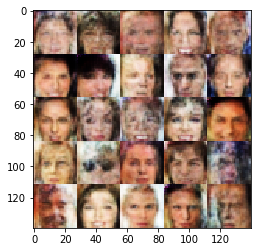

Epoch 2/8... Discriminator Loss: 1.6078... Generator Loss: 0.3725
Epoch 2/8... Discriminator Loss: 1.2580... Generator Loss: 0.8906
Epoch 2/8... Discriminator Loss: 1.5819... Generator Loss: 0.3642
Epoch 2/8... Discriminator Loss: 1.1613... Generator Loss: 0.7311
Epoch 2/8... Discriminator Loss: 1.1617... Generator Loss: 0.7097
Epoch 2/8... Discriminator Loss: 1.4309... Generator Loss: 0.4793
Epoch 2/8... Discriminator Loss: 1.7707... Generator Loss: 0.3216
Epoch 2/8... Discriminator Loss: 1.4458... Generator Loss: 0.4514
Epoch 2/8... Discriminator Loss: 1.5689... Generator Loss: 0.3786
Epoch 2/8... Discriminator Loss: 1.8558... Generator Loss: 0.2860


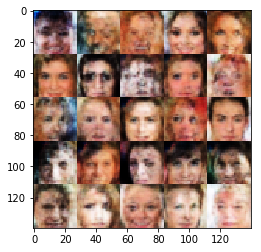

Epoch 2/8... Discriminator Loss: 1.1939... Generator Loss: 0.9180
Epoch 2/8... Discriminator Loss: 1.2667... Generator Loss: 0.7752
Epoch 2/8... Discriminator Loss: 1.2740... Generator Loss: 0.6655
Epoch 2/8... Discriminator Loss: 1.1303... Generator Loss: 0.9201
Epoch 2/8... Discriminator Loss: 1.5323... Generator Loss: 0.4677
Epoch 2/8... Discriminator Loss: 1.4321... Generator Loss: 0.4543
Epoch 2/8... Discriminator Loss: 1.6501... Generator Loss: 0.3409
Epoch 2/8... Discriminator Loss: 1.5104... Generator Loss: 0.4121
Epoch 2/8... Discriminator Loss: 1.7680... Generator Loss: 0.3200
Epoch 2/8... Discriminator Loss: 1.6878... Generator Loss: 0.3397


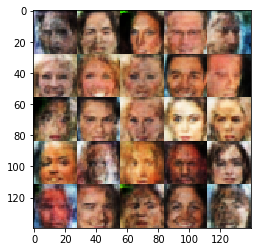

Epoch 2/8... Discriminator Loss: 1.5647... Generator Loss: 0.4399
Epoch 2/8... Discriminator Loss: 1.1822... Generator Loss: 0.8681
Epoch 2/8... Discriminator Loss: 1.3525... Generator Loss: 0.5971
Epoch 2/8... Discriminator Loss: 1.2106... Generator Loss: 1.0094
Epoch 2/8... Discriminator Loss: 1.9381... Generator Loss: 0.2539
Epoch 2/8... Discriminator Loss: 2.0188... Generator Loss: 0.2230
Epoch 2/8... Discriminator Loss: 1.1858... Generator Loss: 1.1314
Epoch 2/8... Discriminator Loss: 1.2337... Generator Loss: 1.3930
Epoch 2/8... Discriminator Loss: 1.1584... Generator Loss: 0.9622
Epoch 2/8... Discriminator Loss: 1.5119... Generator Loss: 0.4467


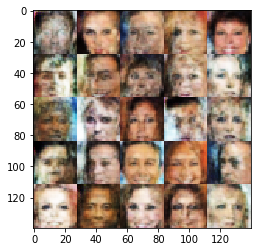

Epoch 2/8... Discriminator Loss: 1.5819... Generator Loss: 2.0969
Epoch 2/8... Discriminator Loss: 1.6019... Generator Loss: 0.4143
Epoch 2/8... Discriminator Loss: 1.7139... Generator Loss: 0.3347
Epoch 2/8... Discriminator Loss: 1.2515... Generator Loss: 1.3128
Epoch 2/8... Discriminator Loss: 1.8503... Generator Loss: 0.2729
Epoch 2/8... Discriminator Loss: 1.8202... Generator Loss: 0.2690
Epoch 2/8... Discriminator Loss: 1.5236... Generator Loss: 0.4243
Epoch 2/8... Discriminator Loss: 1.2885... Generator Loss: 0.5669
Epoch 2/8... Discriminator Loss: 1.4934... Generator Loss: 0.4124
Epoch 2/8... Discriminator Loss: 1.9307... Generator Loss: 0.2571


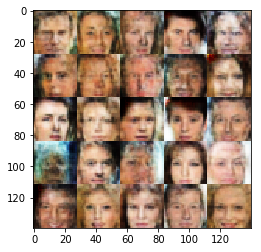

Epoch 2/8... Discriminator Loss: 2.2654... Generator Loss: 0.1763
Epoch 2/8... Discriminator Loss: 1.6105... Generator Loss: 0.3691
Epoch 2/8... Discriminator Loss: 1.2172... Generator Loss: 1.0079
Epoch 2/8... Discriminator Loss: 1.1118... Generator Loss: 0.9427
Epoch 2/8... Discriminator Loss: 1.2150... Generator Loss: 0.7014
Epoch 2/8... Discriminator Loss: 1.1684... Generator Loss: 0.7955
Epoch 2/8... Discriminator Loss: 1.5432... Generator Loss: 0.4191
Epoch 2/8... Discriminator Loss: 1.5046... Generator Loss: 0.4196
Epoch 2/8... Discriminator Loss: 1.8933... Generator Loss: 0.2770
Epoch 2/8... Discriminator Loss: 1.1509... Generator Loss: 1.0545


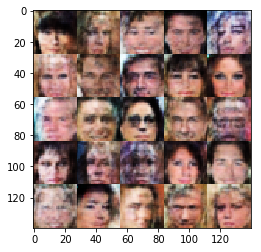

Epoch 2/8... Discriminator Loss: 1.5855... Generator Loss: 0.4097
Epoch 2/8... Discriminator Loss: 1.5992... Generator Loss: 0.3780
Epoch 2/8... Discriminator Loss: 1.5276... Generator Loss: 0.3965
Epoch 2/8... Discriminator Loss: 1.2788... Generator Loss: 1.2891
Epoch 2/8... Discriminator Loss: 1.4793... Generator Loss: 0.4502
Epoch 2/8... Discriminator Loss: 1.2344... Generator Loss: 0.7209
Epoch 2/8... Discriminator Loss: 1.3400... Generator Loss: 1.6186
Epoch 2/8... Discriminator Loss: 1.3613... Generator Loss: 0.6077
Epoch 2/8... Discriminator Loss: 1.6828... Generator Loss: 0.3709
Epoch 2/8... Discriminator Loss: 1.5276... Generator Loss: 0.4353


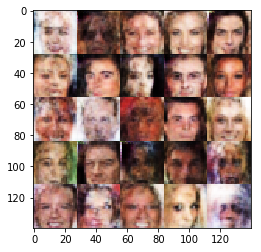

Epoch 2/8... Discriminator Loss: 1.8413... Generator Loss: 0.2994
Epoch 2/8... Discriminator Loss: 1.5540... Generator Loss: 0.4098
Epoch 2/8... Discriminator Loss: 1.4785... Generator Loss: 0.4649
Epoch 2/8... Discriminator Loss: 1.4998... Generator Loss: 0.4483
Epoch 2/8... Discriminator Loss: 1.6130... Generator Loss: 0.3624
Epoch 2/8... Discriminator Loss: 1.6234... Generator Loss: 0.3573
Epoch 2/8... Discriminator Loss: 1.0992... Generator Loss: 1.1335
Epoch 2/8... Discriminator Loss: 1.2220... Generator Loss: 1.0716
Epoch 2/8... Discriminator Loss: 1.6432... Generator Loss: 0.3450
Epoch 2/8... Discriminator Loss: 1.4758... Generator Loss: 0.4682


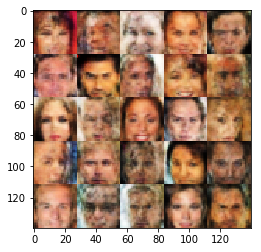

Epoch 2/8... Discriminator Loss: 1.1344... Generator Loss: 0.8505
Epoch 2/8... Discriminator Loss: 1.3348... Generator Loss: 0.6832
Epoch 2/8... Discriminator Loss: 1.4840... Generator Loss: 0.4789
Epoch 2/8... Discriminator Loss: 1.6934... Generator Loss: 0.3373
Epoch 2/8... Discriminator Loss: 1.2823... Generator Loss: 1.1700
Epoch 2/8... Discriminator Loss: 1.2838... Generator Loss: 0.5938
Epoch 2/8... Discriminator Loss: 1.2701... Generator Loss: 0.7906
Epoch 2/8... Discriminator Loss: 1.1685... Generator Loss: 1.3818
Epoch 2/8... Discriminator Loss: 1.6986... Generator Loss: 0.3323
Epoch 2/8... Discriminator Loss: 1.4851... Generator Loss: 0.4477


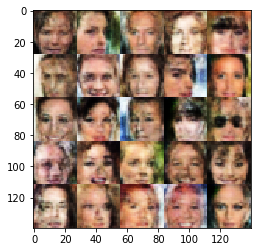

Epoch 2/8... Discriminator Loss: 1.7529... Generator Loss: 0.3003
Epoch 2/8... Discriminator Loss: 1.5017... Generator Loss: 0.4664
Epoch 2/8... Discriminator Loss: 1.7253... Generator Loss: 0.3088
Epoch 2/8... Discriminator Loss: 1.1398... Generator Loss: 1.1612
Epoch 2/8... Discriminator Loss: 1.4615... Generator Loss: 0.4708
Epoch 2/8... Discriminator Loss: 1.4556... Generator Loss: 0.4371
Epoch 2/8... Discriminator Loss: 1.3331... Generator Loss: 0.6096
Epoch 2/8... Discriminator Loss: 1.2950... Generator Loss: 0.7747
Epoch 2/8... Discriminator Loss: 1.3149... Generator Loss: 0.5836
Epoch 2/8... Discriminator Loss: 1.3130... Generator Loss: 0.6007


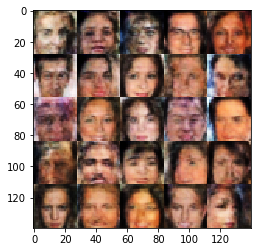

Epoch 2/8... Discriminator Loss: 1.3113... Generator Loss: 0.7543
Epoch 2/8... Discriminator Loss: 1.4488... Generator Loss: 0.4954
Epoch 2/8... Discriminator Loss: 1.2521... Generator Loss: 0.7164
Epoch 2/8... Discriminator Loss: 1.1874... Generator Loss: 0.8609
Epoch 2/8... Discriminator Loss: 1.2126... Generator Loss: 0.9511
Epoch 2/8... Discriminator Loss: 1.2709... Generator Loss: 0.6332
Epoch 2/8... Discriminator Loss: 1.2696... Generator Loss: 1.1789
Epoch 2/8... Discriminator Loss: 1.2911... Generator Loss: 0.7761
Epoch 2/8... Discriminator Loss: 1.4140... Generator Loss: 0.6643
Epoch 2/8... Discriminator Loss: 1.2308... Generator Loss: 0.9818


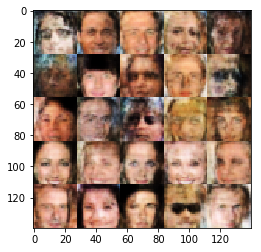

Epoch 2/8... Discriminator Loss: 1.3431... Generator Loss: 1.6346
Epoch 2/8... Discriminator Loss: 1.2078... Generator Loss: 0.8630
Epoch 2/8... Discriminator Loss: 1.3679... Generator Loss: 0.5214
Epoch 2/8... Discriminator Loss: 1.7107... Generator Loss: 0.3395
Epoch 2/8... Discriminator Loss: 1.3274... Generator Loss: 0.6327
Epoch 2/8... Discriminator Loss: 1.4035... Generator Loss: 0.6186
Epoch 2/8... Discriminator Loss: 1.2685... Generator Loss: 0.6315
Epoch 2/8... Discriminator Loss: 1.3149... Generator Loss: 0.8165
Epoch 2/8... Discriminator Loss: 1.1757... Generator Loss: 0.9729
Epoch 2/8... Discriminator Loss: 1.5566... Generator Loss: 0.3932


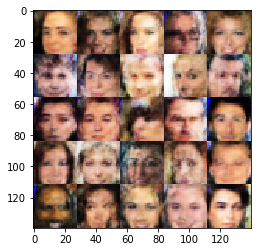

Epoch 2/8... Discriminator Loss: 1.3853... Generator Loss: 0.5928
Epoch 2/8... Discriminator Loss: 1.5080... Generator Loss: 0.4428
Epoch 2/8... Discriminator Loss: 1.4176... Generator Loss: 0.4677
Epoch 2/8... Discriminator Loss: 1.4758... Generator Loss: 0.4531
Epoch 2/8... Discriminator Loss: 1.2274... Generator Loss: 0.9804
Epoch 2/8... Discriminator Loss: 1.3223... Generator Loss: 0.6000
Epoch 2/8... Discriminator Loss: 1.5093... Generator Loss: 0.4223
Epoch 2/8... Discriminator Loss: 1.2127... Generator Loss: 0.9002
Epoch 2/8... Discriminator Loss: 1.1152... Generator Loss: 1.0324
Epoch 2/8... Discriminator Loss: 1.1789... Generator Loss: 1.1970


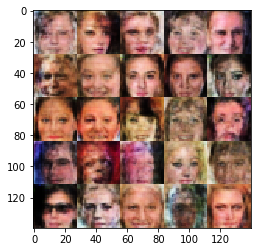

Epoch 2/8... Discriminator Loss: 1.6820... Generator Loss: 0.3401
Epoch 2/8... Discriminator Loss: 1.2779... Generator Loss: 0.6407
Epoch 2/8... Discriminator Loss: 1.2193... Generator Loss: 0.7353
Epoch 2/8... Discriminator Loss: 1.1436... Generator Loss: 1.0894
Epoch 2/8... Discriminator Loss: 1.4710... Generator Loss: 0.4127
Epoch 2/8... Discriminator Loss: 1.5921... Generator Loss: 0.3865
Epoch 2/8... Discriminator Loss: 1.2911... Generator Loss: 0.7420
Epoch 2/8... Discriminator Loss: 1.3767... Generator Loss: 0.5219
Epoch 2/8... Discriminator Loss: 1.3258... Generator Loss: 0.7927
Epoch 2/8... Discriminator Loss: 1.6803... Generator Loss: 0.3362


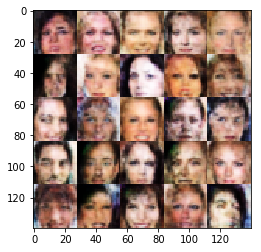

Epoch 2/8... Discriminator Loss: 1.5881... Generator Loss: 0.3951
Epoch 2/8... Discriminator Loss: 1.2330... Generator Loss: 0.9917
Epoch 2/8... Discriminator Loss: 1.5702... Generator Loss: 1.8260
Epoch 3/8... Discriminator Loss: 1.4918... Generator Loss: 0.4279
Epoch 3/8... Discriminator Loss: 1.4576... Generator Loss: 0.4579
Epoch 3/8... Discriminator Loss: 1.2169... Generator Loss: 0.8263
Epoch 3/8... Discriminator Loss: 1.6444... Generator Loss: 0.3490
Epoch 3/8... Discriminator Loss: 1.3021... Generator Loss: 0.9797
Epoch 3/8... Discriminator Loss: 1.5022... Generator Loss: 0.5439
Epoch 3/8... Discriminator Loss: 1.4223... Generator Loss: 0.6219


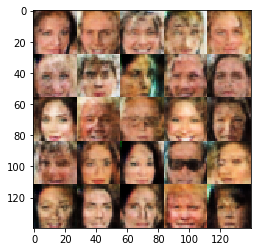

Epoch 3/8... Discriminator Loss: 1.1491... Generator Loss: 1.0693
Epoch 3/8... Discriminator Loss: 1.5266... Generator Loss: 0.5077
Epoch 3/8... Discriminator Loss: 1.7011... Generator Loss: 0.3148
Epoch 3/8... Discriminator Loss: 1.2373... Generator Loss: 1.0966
Epoch 3/8... Discriminator Loss: 1.1948... Generator Loss: 0.8780
Epoch 3/8... Discriminator Loss: 1.3312... Generator Loss: 0.6300
Epoch 3/8... Discriminator Loss: 1.2865... Generator Loss: 0.8579
Epoch 3/8... Discriminator Loss: 1.9013... Generator Loss: 0.2523
Epoch 3/8... Discriminator Loss: 1.3387... Generator Loss: 0.5220
Epoch 3/8... Discriminator Loss: 1.2308... Generator Loss: 0.6931


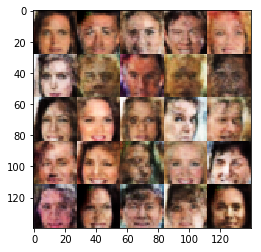

Epoch 3/8... Discriminator Loss: 1.7127... Generator Loss: 0.3352
Epoch 3/8... Discriminator Loss: 1.1966... Generator Loss: 0.8412
Epoch 3/8... Discriminator Loss: 1.2678... Generator Loss: 1.1286
Epoch 3/8... Discriminator Loss: 1.2611... Generator Loss: 1.1904
Epoch 3/8... Discriminator Loss: 1.4287... Generator Loss: 0.5011
Epoch 3/8... Discriminator Loss: 1.2894... Generator Loss: 0.5944
Epoch 3/8... Discriminator Loss: 1.4162... Generator Loss: 0.4799
Epoch 3/8... Discriminator Loss: 1.6253... Generator Loss: 0.3544
Epoch 3/8... Discriminator Loss: 1.2830... Generator Loss: 0.7945
Epoch 3/8... Discriminator Loss: 1.4881... Generator Loss: 0.4492


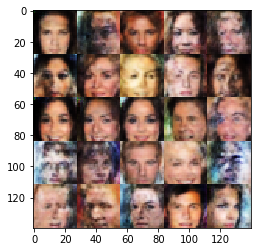

Epoch 3/8... Discriminator Loss: 1.2433... Generator Loss: 0.9438
Epoch 3/8... Discriminator Loss: 1.3072... Generator Loss: 0.6947
Epoch 3/8... Discriminator Loss: 1.3635... Generator Loss: 0.5966
Epoch 3/8... Discriminator Loss: 1.3348... Generator Loss: 0.6129
Epoch 3/8... Discriminator Loss: 1.3080... Generator Loss: 1.4296
Epoch 3/8... Discriminator Loss: 1.5224... Generator Loss: 0.4560
Epoch 3/8... Discriminator Loss: 1.2129... Generator Loss: 0.6909
Epoch 3/8... Discriminator Loss: 1.3843... Generator Loss: 0.6734
Epoch 3/8... Discriminator Loss: 1.2471... Generator Loss: 0.7344
Epoch 3/8... Discriminator Loss: 2.1255... Generator Loss: 0.2082


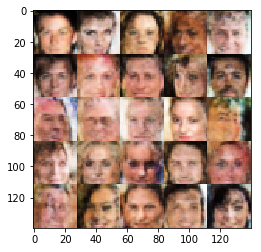

Epoch 3/8... Discriminator Loss: 1.1435... Generator Loss: 1.0985
Epoch 3/8... Discriminator Loss: 1.2272... Generator Loss: 0.8268
Epoch 3/8... Discriminator Loss: 1.2913... Generator Loss: 0.7057
Epoch 3/8... Discriminator Loss: 1.2797... Generator Loss: 0.6497
Epoch 3/8... Discriminator Loss: 1.4743... Generator Loss: 0.5335
Epoch 3/8... Discriminator Loss: 1.3250... Generator Loss: 0.5987
Epoch 3/8... Discriminator Loss: 1.4145... Generator Loss: 1.5548
Epoch 3/8... Discriminator Loss: 1.3458... Generator Loss: 0.6219
Epoch 3/8... Discriminator Loss: 1.4725... Generator Loss: 0.4306
Epoch 3/8... Discriminator Loss: 1.4290... Generator Loss: 0.5348


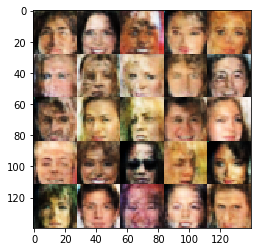

Epoch 3/8... Discriminator Loss: 1.2349... Generator Loss: 1.2768
Epoch 3/8... Discriminator Loss: 1.3457... Generator Loss: 0.6890
Epoch 3/8... Discriminator Loss: 1.7570... Generator Loss: 0.3118
Epoch 3/8... Discriminator Loss: 1.4420... Generator Loss: 0.4944
Epoch 3/8... Discriminator Loss: 1.2715... Generator Loss: 0.6473
Epoch 3/8... Discriminator Loss: 1.3651... Generator Loss: 1.7588
Epoch 3/8... Discriminator Loss: 1.4107... Generator Loss: 0.9862
Epoch 3/8... Discriminator Loss: 1.4658... Generator Loss: 0.4643
Epoch 3/8... Discriminator Loss: 1.2521... Generator Loss: 0.6732
Epoch 3/8... Discriminator Loss: 1.2156... Generator Loss: 0.7692


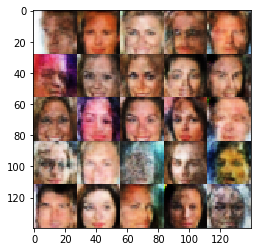

Epoch 3/8... Discriminator Loss: 1.2894... Generator Loss: 1.1562
Epoch 3/8... Discriminator Loss: 1.3297... Generator Loss: 0.5283
Epoch 3/8... Discriminator Loss: 1.7466... Generator Loss: 0.3175
Epoch 3/8... Discriminator Loss: 1.7583... Generator Loss: 0.2920
Epoch 3/8... Discriminator Loss: 1.4565... Generator Loss: 0.5159
Epoch 3/8... Discriminator Loss: 1.2974... Generator Loss: 0.5631
Epoch 3/8... Discriminator Loss: 1.1853... Generator Loss: 1.0651
Epoch 3/8... Discriminator Loss: 1.3538... Generator Loss: 0.5958
Epoch 3/8... Discriminator Loss: 1.4674... Generator Loss: 0.6080
Epoch 3/8... Discriminator Loss: 1.8435... Generator Loss: 0.2784


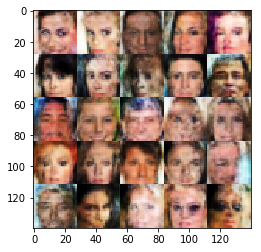

Epoch 3/8... Discriminator Loss: 1.6803... Generator Loss: 0.3613
Epoch 3/8... Discriminator Loss: 1.9269... Generator Loss: 0.2478
Epoch 3/8... Discriminator Loss: 1.2992... Generator Loss: 0.6101
Epoch 3/8... Discriminator Loss: 1.1903... Generator Loss: 1.0111
Epoch 3/8... Discriminator Loss: 1.5319... Generator Loss: 0.5055
Epoch 3/8... Discriminator Loss: 1.7726... Generator Loss: 0.3217
Epoch 3/8... Discriminator Loss: 1.3104... Generator Loss: 0.6176
Epoch 3/8... Discriminator Loss: 1.8639... Generator Loss: 0.2746
Epoch 3/8... Discriminator Loss: 1.4116... Generator Loss: 0.5462
Epoch 3/8... Discriminator Loss: 1.1856... Generator Loss: 0.9099


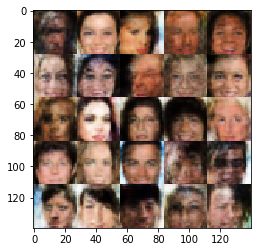

Epoch 3/8... Discriminator Loss: 1.2630... Generator Loss: 0.6940
Epoch 3/8... Discriminator Loss: 1.3169... Generator Loss: 1.3658
Epoch 3/8... Discriminator Loss: 1.3993... Generator Loss: 0.4944
Epoch 3/8... Discriminator Loss: 1.4517... Generator Loss: 0.5278
Epoch 3/8... Discriminator Loss: 1.1987... Generator Loss: 0.8594
Epoch 3/8... Discriminator Loss: 1.4714... Generator Loss: 0.4277
Epoch 3/8... Discriminator Loss: 1.1596... Generator Loss: 0.8484
Epoch 3/8... Discriminator Loss: 1.2904... Generator Loss: 0.8007
Epoch 3/8... Discriminator Loss: 1.5065... Generator Loss: 0.3939
Epoch 3/8... Discriminator Loss: 1.7874... Generator Loss: 0.2928


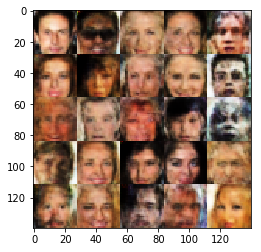

Epoch 3/8... Discriminator Loss: 1.5110... Generator Loss: 1.2400
Epoch 3/8... Discriminator Loss: 1.2773... Generator Loss: 0.9410
Epoch 3/8... Discriminator Loss: 1.3300... Generator Loss: 0.6470
Epoch 3/8... Discriminator Loss: 1.3100... Generator Loss: 0.6814
Epoch 3/8... Discriminator Loss: 1.3596... Generator Loss: 0.5553
Epoch 3/8... Discriminator Loss: 1.6723... Generator Loss: 0.3992
Epoch 3/8... Discriminator Loss: 1.1028... Generator Loss: 1.0030
Epoch 3/8... Discriminator Loss: 1.9215... Generator Loss: 0.2644
Epoch 3/8... Discriminator Loss: 1.4943... Generator Loss: 0.4195
Epoch 3/8... Discriminator Loss: 1.3865... Generator Loss: 0.5334


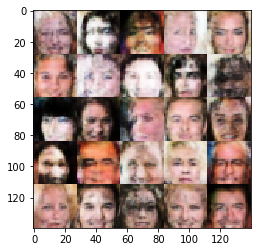

Epoch 3/8... Discriminator Loss: 1.3689... Generator Loss: 0.5183
Epoch 3/8... Discriminator Loss: 1.3168... Generator Loss: 0.9320
Epoch 3/8... Discriminator Loss: 1.4886... Generator Loss: 0.4323
Epoch 3/8... Discriminator Loss: 1.4297... Generator Loss: 0.4702
Epoch 3/8... Discriminator Loss: 1.1214... Generator Loss: 1.2065
Epoch 3/8... Discriminator Loss: 1.2415... Generator Loss: 0.8018
Epoch 3/8... Discriminator Loss: 1.9006... Generator Loss: 0.2708
Epoch 3/8... Discriminator Loss: 1.4156... Generator Loss: 0.5645
Epoch 3/8... Discriminator Loss: 1.6086... Generator Loss: 0.3891
Epoch 3/8... Discriminator Loss: 1.1978... Generator Loss: 0.7688


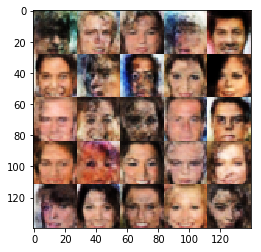

Epoch 3/8... Discriminator Loss: 1.7752... Generator Loss: 0.3034
Epoch 3/8... Discriminator Loss: 1.2713... Generator Loss: 0.8489
Epoch 3/8... Discriminator Loss: 1.3385... Generator Loss: 0.8395
Epoch 3/8... Discriminator Loss: 1.3411... Generator Loss: 0.6119
Epoch 3/8... Discriminator Loss: 1.3073... Generator Loss: 0.6613
Epoch 3/8... Discriminator Loss: 1.7044... Generator Loss: 0.3164
Epoch 3/8... Discriminator Loss: 1.6314... Generator Loss: 0.3694
Epoch 3/8... Discriminator Loss: 1.5864... Generator Loss: 0.3573
Epoch 3/8... Discriminator Loss: 1.4622... Generator Loss: 0.4852
Epoch 3/8... Discriminator Loss: 1.3497... Generator Loss: 0.5696


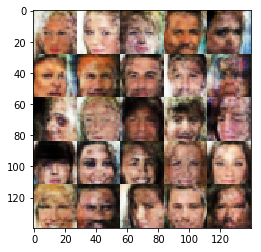

Epoch 3/8... Discriminator Loss: 1.3258... Generator Loss: 1.3370
Epoch 3/8... Discriminator Loss: 1.3129... Generator Loss: 0.7146
Epoch 3/8... Discriminator Loss: 1.1399... Generator Loss: 1.0629
Epoch 3/8... Discriminator Loss: 1.3057... Generator Loss: 0.8849
Epoch 3/8... Discriminator Loss: 1.8174... Generator Loss: 0.2834
Epoch 3/8... Discriminator Loss: 1.6124... Generator Loss: 0.3720
Epoch 3/8... Discriminator Loss: 1.4331... Generator Loss: 0.4759
Epoch 3/8... Discriminator Loss: 1.3485... Generator Loss: 0.9710
Epoch 3/8... Discriminator Loss: 1.3116... Generator Loss: 1.0298
Epoch 3/8... Discriminator Loss: 1.6435... Generator Loss: 0.3412


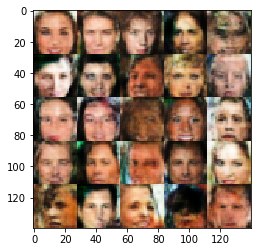

Epoch 3/8... Discriminator Loss: 1.3286... Generator Loss: 0.7519
Epoch 3/8... Discriminator Loss: 1.3683... Generator Loss: 0.5440
Epoch 3/8... Discriminator Loss: 1.1802... Generator Loss: 0.8013
Epoch 3/8... Discriminator Loss: 1.4562... Generator Loss: 0.5017
Epoch 3/8... Discriminator Loss: 1.3996... Generator Loss: 0.5982
Epoch 3/8... Discriminator Loss: 1.3643... Generator Loss: 0.5932
Epoch 3/8... Discriminator Loss: 1.5431... Generator Loss: 0.3910
Epoch 3/8... Discriminator Loss: 1.2107... Generator Loss: 0.8333
Epoch 3/8... Discriminator Loss: 1.1840... Generator Loss: 0.7703
Epoch 3/8... Discriminator Loss: 1.2889... Generator Loss: 1.1864


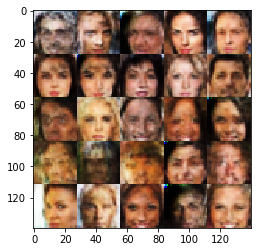

Epoch 3/8... Discriminator Loss: 1.1990... Generator Loss: 0.9352
Epoch 3/8... Discriminator Loss: 1.2811... Generator Loss: 0.8782
Epoch 3/8... Discriminator Loss: 1.2449... Generator Loss: 0.8952
Epoch 3/8... Discriminator Loss: 1.5462... Generator Loss: 0.3818
Epoch 3/8... Discriminator Loss: 1.3622... Generator Loss: 0.5541
Epoch 3/8... Discriminator Loss: 1.3944... Generator Loss: 1.4340
Epoch 3/8... Discriminator Loss: 1.4639... Generator Loss: 0.4404
Epoch 3/8... Discriminator Loss: 1.2918... Generator Loss: 0.6445
Epoch 3/8... Discriminator Loss: 1.4453... Generator Loss: 0.4943
Epoch 3/8... Discriminator Loss: 1.2703... Generator Loss: 0.8663


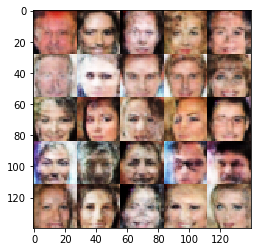

Epoch 3/8... Discriminator Loss: 1.5068... Generator Loss: 0.4250
Epoch 3/8... Discriminator Loss: 1.7929... Generator Loss: 0.3007
Epoch 3/8... Discriminator Loss: 1.2882... Generator Loss: 0.6601
Epoch 3/8... Discriminator Loss: 1.3333... Generator Loss: 0.6478
Epoch 3/8... Discriminator Loss: 1.3497... Generator Loss: 1.2139
Epoch 3/8... Discriminator Loss: 1.3405... Generator Loss: 0.7400
Epoch 3/8... Discriminator Loss: 1.5185... Generator Loss: 0.4253
Epoch 3/8... Discriminator Loss: 1.2843... Generator Loss: 0.6578
Epoch 3/8... Discriminator Loss: 1.3957... Generator Loss: 0.5649
Epoch 3/8... Discriminator Loss: 1.5310... Generator Loss: 0.4202


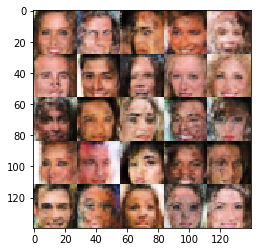

Epoch 3/8... Discriminator Loss: 1.5829... Generator Loss: 0.4094
Epoch 3/8... Discriminator Loss: 1.4829... Generator Loss: 0.4321
Epoch 3/8... Discriminator Loss: 1.3385... Generator Loss: 0.8024
Epoch 3/8... Discriminator Loss: 1.3048... Generator Loss: 1.1801
Epoch 3/8... Discriminator Loss: 1.3766... Generator Loss: 0.5094
Epoch 3/8... Discriminator Loss: 1.6813... Generator Loss: 0.3295
Epoch 3/8... Discriminator Loss: 1.2955... Generator Loss: 0.8275
Epoch 3/8... Discriminator Loss: 1.2855... Generator Loss: 0.6683
Epoch 3/8... Discriminator Loss: 1.4552... Generator Loss: 0.4869
Epoch 3/8... Discriminator Loss: 1.7255... Generator Loss: 0.3142


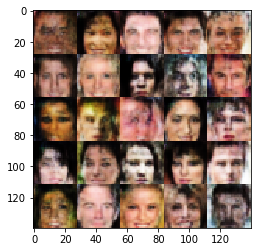

Epoch 3/8... Discriminator Loss: 1.1572... Generator Loss: 0.7234
Epoch 3/8... Discriminator Loss: 1.5767... Generator Loss: 0.3821
Epoch 3/8... Discriminator Loss: 1.5369... Generator Loss: 0.4016
Epoch 3/8... Discriminator Loss: 1.3771... Generator Loss: 0.5816
Epoch 3/8... Discriminator Loss: 1.8488... Generator Loss: 0.2765
Epoch 3/8... Discriminator Loss: 1.5836... Generator Loss: 0.3912
Epoch 3/8... Discriminator Loss: 1.5335... Generator Loss: 0.4368
Epoch 3/8... Discriminator Loss: 1.5563... Generator Loss: 0.3562
Epoch 3/8... Discriminator Loss: 1.1526... Generator Loss: 1.1965
Epoch 3/8... Discriminator Loss: 1.4241... Generator Loss: 0.5604


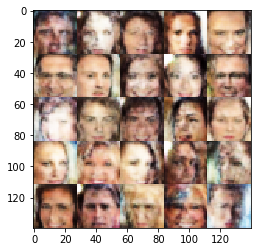

Epoch 3/8... Discriminator Loss: 1.9055... Generator Loss: 0.2567
Epoch 3/8... Discriminator Loss: 1.2361... Generator Loss: 0.8505
Epoch 3/8... Discriminator Loss: 1.1787... Generator Loss: 0.8134
Epoch 3/8... Discriminator Loss: 1.1605... Generator Loss: 0.8876
Epoch 3/8... Discriminator Loss: 1.2604... Generator Loss: 0.8354
Epoch 3/8... Discriminator Loss: 1.2056... Generator Loss: 1.4631
Epoch 3/8... Discriminator Loss: 1.7076... Generator Loss: 0.3270
Epoch 3/8... Discriminator Loss: 1.0027... Generator Loss: 1.1712
Epoch 3/8... Discriminator Loss: 1.8316... Generator Loss: 0.2767
Epoch 3/8... Discriminator Loss: 1.5268... Generator Loss: 0.4711


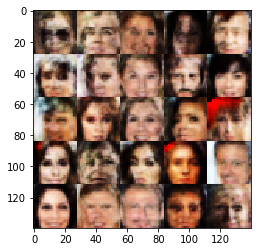

Epoch 3/8... Discriminator Loss: 1.1728... Generator Loss: 0.9423
Epoch 3/8... Discriminator Loss: 1.3649... Generator Loss: 0.5175
Epoch 3/8... Discriminator Loss: 1.4919... Generator Loss: 0.4265
Epoch 3/8... Discriminator Loss: 1.2239... Generator Loss: 0.8028
Epoch 3/8... Discriminator Loss: 1.4158... Generator Loss: 0.5052
Epoch 3/8... Discriminator Loss: 1.2728... Generator Loss: 0.7669
Epoch 3/8... Discriminator Loss: 1.5551... Generator Loss: 0.3991
Epoch 3/8... Discriminator Loss: 1.3315... Generator Loss: 0.5924
Epoch 3/8... Discriminator Loss: 1.2327... Generator Loss: 0.6654
Epoch 3/8... Discriminator Loss: 1.6441... Generator Loss: 0.3749


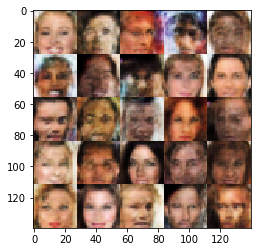

Epoch 3/8... Discriminator Loss: 1.4192... Generator Loss: 0.4865
Epoch 3/8... Discriminator Loss: 1.2863... Generator Loss: 0.6237
Epoch 3/8... Discriminator Loss: 1.1801... Generator Loss: 0.8548
Epoch 3/8... Discriminator Loss: 1.2978... Generator Loss: 0.6208
Epoch 3/8... Discriminator Loss: 1.2251... Generator Loss: 0.9004
Epoch 3/8... Discriminator Loss: 1.3026... Generator Loss: 0.6779
Epoch 3/8... Discriminator Loss: 1.4939... Generator Loss: 0.4211
Epoch 3/8... Discriminator Loss: 1.6111... Generator Loss: 0.3681
Epoch 3/8... Discriminator Loss: 1.3534... Generator Loss: 0.6236
Epoch 3/8... Discriminator Loss: 1.2187... Generator Loss: 0.7867


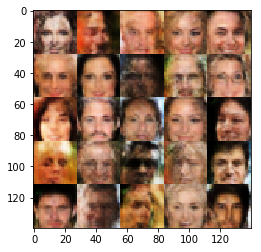

Epoch 3/8... Discriminator Loss: 1.7469... Generator Loss: 0.3220
Epoch 3/8... Discriminator Loss: 1.3359... Generator Loss: 0.5538
Epoch 3/8... Discriminator Loss: 1.5346... Generator Loss: 1.5364
Epoch 3/8... Discriminator Loss: 1.3539... Generator Loss: 0.5083
Epoch 3/8... Discriminator Loss: 1.3155... Generator Loss: 0.5611
Epoch 3/8... Discriminator Loss: 1.2298... Generator Loss: 0.8569
Epoch 3/8... Discriminator Loss: 1.7171... Generator Loss: 0.3482
Epoch 3/8... Discriminator Loss: 1.3528... Generator Loss: 0.5601
Epoch 3/8... Discriminator Loss: 1.6528... Generator Loss: 0.3552
Epoch 3/8... Discriminator Loss: 1.6350... Generator Loss: 0.3940


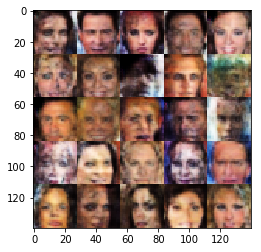

Epoch 3/8... Discriminator Loss: 1.3081... Generator Loss: 0.7790
Epoch 3/8... Discriminator Loss: 1.2581... Generator Loss: 0.8244
Epoch 3/8... Discriminator Loss: 1.2709... Generator Loss: 0.6441
Epoch 3/8... Discriminator Loss: 1.5184... Generator Loss: 0.4293
Epoch 3/8... Discriminator Loss: 1.3435... Generator Loss: 0.9202
Epoch 3/8... Discriminator Loss: 1.3904... Generator Loss: 0.5413
Epoch 3/8... Discriminator Loss: 1.2367... Generator Loss: 0.6528
Epoch 3/8... Discriminator Loss: 1.3902... Generator Loss: 0.5722
Epoch 3/8... Discriminator Loss: 1.4837... Generator Loss: 0.4383
Epoch 3/8... Discriminator Loss: 1.2093... Generator Loss: 0.8816


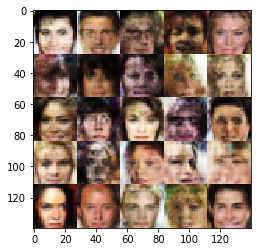

Epoch 3/8... Discriminator Loss: 1.4993... Generator Loss: 0.4340
Epoch 3/8... Discriminator Loss: 1.7759... Generator Loss: 0.3195
Epoch 3/8... Discriminator Loss: 1.4331... Generator Loss: 0.4824
Epoch 3/8... Discriminator Loss: 1.6703... Generator Loss: 0.3577
Epoch 3/8... Discriminator Loss: 1.6936... Generator Loss: 0.3406
Epoch 3/8... Discriminator Loss: 1.2817... Generator Loss: 0.9893
Epoch 3/8... Discriminator Loss: 1.8032... Generator Loss: 0.3085
Epoch 3/8... Discriminator Loss: 1.6980... Generator Loss: 0.3458
Epoch 3/8... Discriminator Loss: 1.1992... Generator Loss: 0.7335
Epoch 3/8... Discriminator Loss: 1.1962... Generator Loss: 1.1622


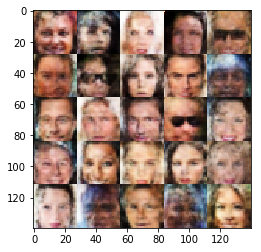

Epoch 3/8... Discriminator Loss: 1.0536... Generator Loss: 1.1606
Epoch 3/8... Discriminator Loss: 1.3977... Generator Loss: 0.6890
Epoch 3/8... Discriminator Loss: 1.7166... Generator Loss: 0.3062
Epoch 3/8... Discriminator Loss: 1.2072... Generator Loss: 0.9574
Epoch 3/8... Discriminator Loss: 1.3603... Generator Loss: 0.5330
Epoch 3/8... Discriminator Loss: 1.2810... Generator Loss: 0.6909
Epoch 3/8... Discriminator Loss: 1.2500... Generator Loss: 0.7072
Epoch 3/8... Discriminator Loss: 1.3768... Generator Loss: 0.6015
Epoch 3/8... Discriminator Loss: 1.2477... Generator Loss: 0.9663
Epoch 3/8... Discriminator Loss: 1.9261... Generator Loss: 0.2572


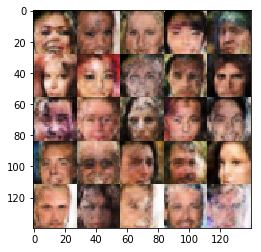

Epoch 3/8... Discriminator Loss: 1.3981... Generator Loss: 0.5398
Epoch 3/8... Discriminator Loss: 1.3987... Generator Loss: 0.5527
Epoch 3/8... Discriminator Loss: 1.4646... Generator Loss: 0.4785
Epoch 3/8... Discriminator Loss: 1.3610... Generator Loss: 0.4924
Epoch 3/8... Discriminator Loss: 1.5334... Generator Loss: 0.4690
Epoch 3/8... Discriminator Loss: 1.3975... Generator Loss: 0.5593
Epoch 3/8... Discriminator Loss: 1.3151... Generator Loss: 0.5826
Epoch 3/8... Discriminator Loss: 1.5778... Generator Loss: 0.3588
Epoch 3/8... Discriminator Loss: 1.3465... Generator Loss: 0.6267
Epoch 3/8... Discriminator Loss: 1.2576... Generator Loss: 0.8559


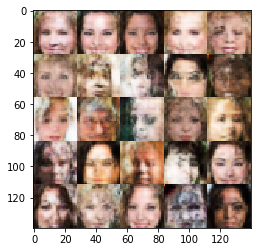

Epoch 3/8... Discriminator Loss: 1.6569... Generator Loss: 0.3581
Epoch 3/8... Discriminator Loss: 1.3780... Generator Loss: 0.5516
Epoch 3/8... Discriminator Loss: 1.3256... Generator Loss: 0.5716
Epoch 3/8... Discriminator Loss: 1.4114... Generator Loss: 0.6219
Epoch 3/8... Discriminator Loss: 1.2527... Generator Loss: 1.0586
Epoch 3/8... Discriminator Loss: 1.5370... Generator Loss: 0.4067
Epoch 3/8... Discriminator Loss: 1.4691... Generator Loss: 0.5152
Epoch 3/8... Discriminator Loss: 1.2114... Generator Loss: 1.1020
Epoch 3/8... Discriminator Loss: 1.3910... Generator Loss: 0.7238
Epoch 3/8... Discriminator Loss: 1.3617... Generator Loss: 0.5520


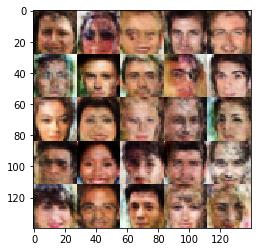

Epoch 3/8... Discriminator Loss: 1.2519... Generator Loss: 0.7179
Epoch 3/8... Discriminator Loss: 1.2756... Generator Loss: 0.8989
Epoch 3/8... Discriminator Loss: 1.5283... Generator Loss: 0.4243
Epoch 3/8... Discriminator Loss: 1.3205... Generator Loss: 0.6342
Epoch 3/8... Discriminator Loss: 1.5886... Generator Loss: 0.3892
Epoch 3/8... Discriminator Loss: 1.6531... Generator Loss: 0.3852
Epoch 3/8... Discriminator Loss: 1.3366... Generator Loss: 0.7114
Epoch 3/8... Discriminator Loss: 1.3831... Generator Loss: 0.5705
Epoch 3/8... Discriminator Loss: 1.4102... Generator Loss: 0.5327
Epoch 3/8... Discriminator Loss: 1.4349... Generator Loss: 0.4656


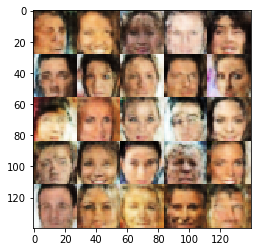

Epoch 3/8... Discriminator Loss: 1.2769... Generator Loss: 0.6989
Epoch 3/8... Discriminator Loss: 1.2884... Generator Loss: 0.9092
Epoch 3/8... Discriminator Loss: 1.6283... Generator Loss: 0.3748
Epoch 3/8... Discriminator Loss: 1.2535... Generator Loss: 0.8146
Epoch 3/8... Discriminator Loss: 1.4969... Generator Loss: 0.4178
Epoch 3/8... Discriminator Loss: 1.2699... Generator Loss: 0.7068
Epoch 3/8... Discriminator Loss: 1.8881... Generator Loss: 0.2670
Epoch 3/8... Discriminator Loss: 1.2437... Generator Loss: 0.8677
Epoch 3/8... Discriminator Loss: 1.2938... Generator Loss: 0.7120
Epoch 3/8... Discriminator Loss: 1.5075... Generator Loss: 0.4372


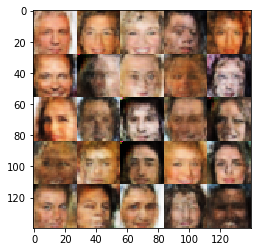

Epoch 3/8... Discriminator Loss: 1.9184... Generator Loss: 0.2689
Epoch 3/8... Discriminator Loss: 1.5319... Generator Loss: 0.4061
Epoch 3/8... Discriminator Loss: 1.2157... Generator Loss: 0.8420
Epoch 3/8... Discriminator Loss: 1.3069... Generator Loss: 0.9725
Epoch 3/8... Discriminator Loss: 1.1913... Generator Loss: 0.9449
Epoch 3/8... Discriminator Loss: 1.3232... Generator Loss: 0.7079
Epoch 3/8... Discriminator Loss: 1.5099... Generator Loss: 0.4226
Epoch 3/8... Discriminator Loss: 1.3878... Generator Loss: 0.6034
Epoch 3/8... Discriminator Loss: 1.2340... Generator Loss: 1.0095
Epoch 3/8... Discriminator Loss: 1.5197... Generator Loss: 0.4282


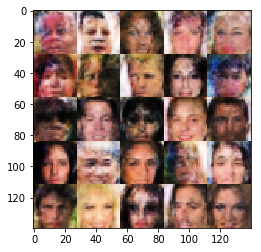

Epoch 3/8... Discriminator Loss: 1.1701... Generator Loss: 1.0033
Epoch 3/8... Discriminator Loss: 1.2825... Generator Loss: 0.6655
Epoch 3/8... Discriminator Loss: 1.1798... Generator Loss: 0.8209
Epoch 3/8... Discriminator Loss: 1.4658... Generator Loss: 0.4706
Epoch 3/8... Discriminator Loss: 1.2021... Generator Loss: 1.0443
Epoch 3/8... Discriminator Loss: 1.2688... Generator Loss: 1.0004
Epoch 3/8... Discriminator Loss: 1.3007... Generator Loss: 0.8852
Epoch 3/8... Discriminator Loss: 1.3858... Generator Loss: 0.6286
Epoch 3/8... Discriminator Loss: 1.3349... Generator Loss: 0.6182
Epoch 3/8... Discriminator Loss: 1.1828... Generator Loss: 1.1078


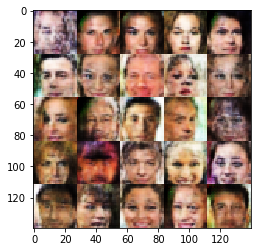

Epoch 3/8... Discriminator Loss: 1.2406... Generator Loss: 0.8201
Epoch 3/8... Discriminator Loss: 1.4967... Generator Loss: 0.4468
Epoch 3/8... Discriminator Loss: 1.6870... Generator Loss: 0.3221
Epoch 3/8... Discriminator Loss: 1.8014... Generator Loss: 0.2899
Epoch 3/8... Discriminator Loss: 1.3671... Generator Loss: 0.9391
Epoch 3/8... Discriminator Loss: 1.2543... Generator Loss: 0.7584
Epoch 3/8... Discriminator Loss: 1.3617... Generator Loss: 0.7205
Epoch 3/8... Discriminator Loss: 1.3403... Generator Loss: 0.9590
Epoch 3/8... Discriminator Loss: 1.6690... Generator Loss: 0.3546
Epoch 4/8... Discriminator Loss: 1.5448... Generator Loss: 0.4085


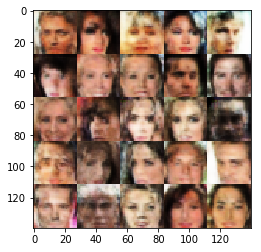

Epoch 4/8... Discriminator Loss: 1.4070... Generator Loss: 0.5568
Epoch 4/8... Discriminator Loss: 1.4583... Generator Loss: 1.4834
Epoch 4/8... Discriminator Loss: 1.8364... Generator Loss: 0.2793
Epoch 4/8... Discriminator Loss: 1.2854... Generator Loss: 0.6500
Epoch 4/8... Discriminator Loss: 1.2015... Generator Loss: 1.0332
Epoch 4/8... Discriminator Loss: 1.7108... Generator Loss: 0.3121
Epoch 4/8... Discriminator Loss: 1.3973... Generator Loss: 0.5666
Epoch 4/8... Discriminator Loss: 1.3963... Generator Loss: 0.5670
Epoch 4/8... Discriminator Loss: 1.1870... Generator Loss: 0.9295
Epoch 4/8... Discriminator Loss: 1.3030... Generator Loss: 0.6373


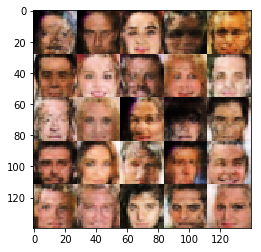

Epoch 4/8... Discriminator Loss: 1.2235... Generator Loss: 0.7101
Epoch 4/8... Discriminator Loss: 1.4952... Generator Loss: 0.5392
Epoch 4/8... Discriminator Loss: 1.5076... Generator Loss: 0.4060
Epoch 4/8... Discriminator Loss: 1.4108... Generator Loss: 0.5017
Epoch 4/8... Discriminator Loss: 1.3343... Generator Loss: 1.1959
Epoch 4/8... Discriminator Loss: 1.5062... Generator Loss: 0.4722
Epoch 4/8... Discriminator Loss: 1.5502... Generator Loss: 0.3998
Epoch 4/8... Discriminator Loss: 1.4188... Generator Loss: 0.5169
Epoch 4/8... Discriminator Loss: 1.5161... Generator Loss: 0.4587
Epoch 4/8... Discriminator Loss: 1.5601... Generator Loss: 0.3723


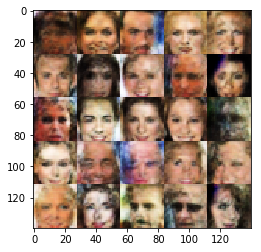

Epoch 4/8... Discriminator Loss: 1.4021... Generator Loss: 0.5444
Epoch 4/8... Discriminator Loss: 1.5842... Generator Loss: 1.6466
Epoch 4/8... Discriminator Loss: 1.3635... Generator Loss: 0.6080
Epoch 4/8... Discriminator Loss: 1.4101... Generator Loss: 0.5422
Epoch 4/8... Discriminator Loss: 1.3787... Generator Loss: 0.5810
Epoch 4/8... Discriminator Loss: 1.2736... Generator Loss: 0.7003
Epoch 4/8... Discriminator Loss: 1.3723... Generator Loss: 0.7634
Epoch 4/8... Discriminator Loss: 1.8457... Generator Loss: 0.2702
Epoch 4/8... Discriminator Loss: 1.3012... Generator Loss: 0.8597
Epoch 4/8... Discriminator Loss: 1.4985... Generator Loss: 0.4640


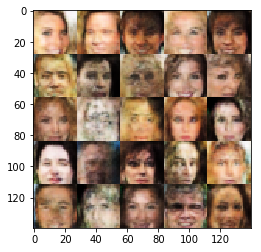

Epoch 4/8... Discriminator Loss: 1.2266... Generator Loss: 0.8067
Epoch 4/8... Discriminator Loss: 1.3732... Generator Loss: 0.8039
Epoch 4/8... Discriminator Loss: 1.2361... Generator Loss: 0.6995
Epoch 4/8... Discriminator Loss: 1.3428... Generator Loss: 1.2906
Epoch 4/8... Discriminator Loss: 1.4494... Generator Loss: 0.4806
Epoch 4/8... Discriminator Loss: 1.3132... Generator Loss: 0.6621
Epoch 4/8... Discriminator Loss: 1.6516... Generator Loss: 0.3644
Epoch 4/8... Discriminator Loss: 1.7291... Generator Loss: 0.3041
Epoch 4/8... Discriminator Loss: 1.3880... Generator Loss: 0.5036
Epoch 4/8... Discriminator Loss: 1.3834... Generator Loss: 0.7255


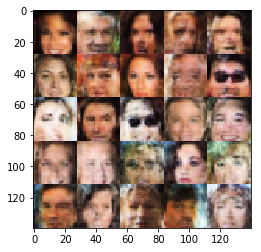

Epoch 4/8... Discriminator Loss: 1.3864... Generator Loss: 0.5386
Epoch 4/8... Discriminator Loss: 1.4944... Generator Loss: 0.4841
Epoch 4/8... Discriminator Loss: 1.2281... Generator Loss: 0.7125
Epoch 4/8... Discriminator Loss: 1.3852... Generator Loss: 0.6101
Epoch 4/8... Discriminator Loss: 1.4171... Generator Loss: 0.5023
Epoch 4/8... Discriminator Loss: 1.2948... Generator Loss: 0.7744
Epoch 4/8... Discriminator Loss: 1.3170... Generator Loss: 0.6297
Epoch 4/8... Discriminator Loss: 1.3340... Generator Loss: 1.0302
Epoch 4/8... Discriminator Loss: 1.7334... Generator Loss: 0.3178
Epoch 4/8... Discriminator Loss: 1.3320... Generator Loss: 0.8861


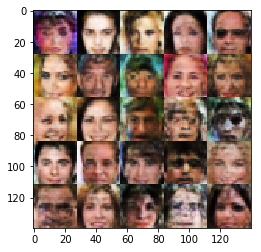

Epoch 4/8... Discriminator Loss: 1.2404... Generator Loss: 1.0223
Epoch 4/8... Discriminator Loss: 1.4005... Generator Loss: 0.5207
Epoch 4/8... Discriminator Loss: 1.2605... Generator Loss: 1.0788
Epoch 4/8... Discriminator Loss: 1.4754... Generator Loss: 0.5374
Epoch 4/8... Discriminator Loss: 1.6543... Generator Loss: 0.3521
Epoch 4/8... Discriminator Loss: 1.6966... Generator Loss: 0.3445
Epoch 4/8... Discriminator Loss: 1.3615... Generator Loss: 1.1276
Epoch 4/8... Discriminator Loss: 1.2136... Generator Loss: 0.7835
Epoch 4/8... Discriminator Loss: 1.6603... Generator Loss: 0.3627
Epoch 4/8... Discriminator Loss: 1.4787... Generator Loss: 0.4774


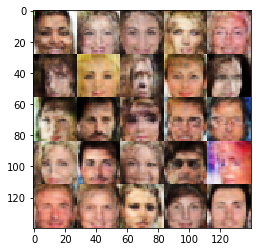

Epoch 4/8... Discriminator Loss: 1.4314... Generator Loss: 0.4986
Epoch 4/8... Discriminator Loss: 1.8087... Generator Loss: 0.2835
Epoch 4/8... Discriminator Loss: 1.4140... Generator Loss: 0.5834
Epoch 4/8... Discriminator Loss: 1.5001... Generator Loss: 0.4425
Epoch 4/8... Discriminator Loss: 1.2264... Generator Loss: 1.0100
Epoch 4/8... Discriminator Loss: 1.5845... Generator Loss: 0.3934
Epoch 4/8... Discriminator Loss: 1.6026... Generator Loss: 0.4066
Epoch 4/8... Discriminator Loss: 1.3256... Generator Loss: 0.6407
Epoch 4/8... Discriminator Loss: 1.2865... Generator Loss: 1.3358
Epoch 4/8... Discriminator Loss: 1.6602... Generator Loss: 0.3738


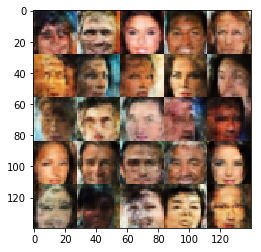

Epoch 4/8... Discriminator Loss: 1.5865... Generator Loss: 0.3727
Epoch 4/8... Discriminator Loss: 1.3637... Generator Loss: 0.6335
Epoch 4/8... Discriminator Loss: 1.2450... Generator Loss: 0.6535
Epoch 4/8... Discriminator Loss: 1.6372... Generator Loss: 0.3648
Epoch 4/8... Discriminator Loss: 1.4694... Generator Loss: 0.4364
Epoch 4/8... Discriminator Loss: 1.3287... Generator Loss: 0.6357
Epoch 4/8... Discriminator Loss: 1.2075... Generator Loss: 0.9422
Epoch 4/8... Discriminator Loss: 1.3982... Generator Loss: 0.8938
Epoch 4/8... Discriminator Loss: 1.9096... Generator Loss: 0.3003
Epoch 4/8... Discriminator Loss: 1.4251... Generator Loss: 0.5226


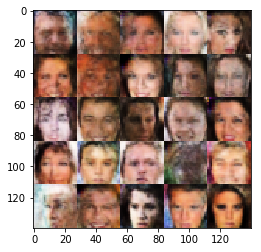

Epoch 4/8... Discriminator Loss: 1.2137... Generator Loss: 0.7089
Epoch 4/8... Discriminator Loss: 1.3844... Generator Loss: 0.5771
Epoch 4/8... Discriminator Loss: 1.3032... Generator Loss: 0.6952
Epoch 4/8... Discriminator Loss: 1.2887... Generator Loss: 1.1514
Epoch 4/8... Discriminator Loss: 1.4640... Generator Loss: 0.6004
Epoch 4/8... Discriminator Loss: 1.4068... Generator Loss: 0.5668
Epoch 4/8... Discriminator Loss: 1.2296... Generator Loss: 0.9275
Epoch 4/8... Discriminator Loss: 1.2589... Generator Loss: 1.1066
Epoch 4/8... Discriminator Loss: 1.4459... Generator Loss: 0.5350
Epoch 4/8... Discriminator Loss: 1.6127... Generator Loss: 0.3901


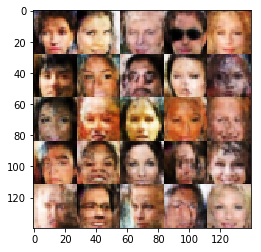

Epoch 4/8... Discriminator Loss: 1.6489... Generator Loss: 0.3874
Epoch 4/8... Discriminator Loss: 1.3108... Generator Loss: 0.6858
Epoch 4/8... Discriminator Loss: 1.3282... Generator Loss: 0.6030
Epoch 4/8... Discriminator Loss: 1.4780... Generator Loss: 0.4826
Epoch 4/8... Discriminator Loss: 1.6769... Generator Loss: 0.3697
Epoch 4/8... Discriminator Loss: 1.5018... Generator Loss: 0.4010
Epoch 4/8... Discriminator Loss: 1.3204... Generator Loss: 0.6377
Epoch 4/8... Discriminator Loss: 1.3421... Generator Loss: 0.5501
Epoch 4/8... Discriminator Loss: 1.4116... Generator Loss: 0.5099
Epoch 4/8... Discriminator Loss: 1.7571... Generator Loss: 0.2958


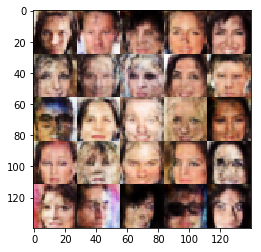

Epoch 4/8... Discriminator Loss: 1.5828... Generator Loss: 1.5815
Epoch 4/8... Discriminator Loss: 1.2591... Generator Loss: 0.7398
Epoch 4/8... Discriminator Loss: 1.4008... Generator Loss: 0.5255
Epoch 4/8... Discriminator Loss: 1.4084... Generator Loss: 0.5371
Epoch 4/8... Discriminator Loss: 1.2634... Generator Loss: 0.7935
Epoch 4/8... Discriminator Loss: 1.5790... Generator Loss: 0.4026
Epoch 4/8... Discriminator Loss: 1.6554... Generator Loss: 0.3680
Epoch 4/8... Discriminator Loss: 1.4645... Generator Loss: 0.5006
Epoch 4/8... Discriminator Loss: 1.8512... Generator Loss: 0.2809
Epoch 4/8... Discriminator Loss: 1.5597... Generator Loss: 0.4168


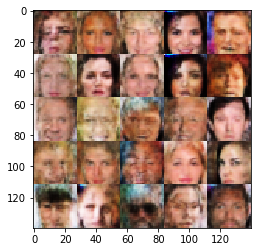

Epoch 4/8... Discriminator Loss: 1.4130... Generator Loss: 0.5030
Epoch 4/8... Discriminator Loss: 1.2576... Generator Loss: 0.8578
Epoch 4/8... Discriminator Loss: 1.5036... Generator Loss: 0.4234
Epoch 4/8... Discriminator Loss: 1.3143... Generator Loss: 0.6909
Epoch 4/8... Discriminator Loss: 1.5039... Generator Loss: 0.4475
Epoch 4/8... Discriminator Loss: 1.4099... Generator Loss: 0.5623
Epoch 4/8... Discriminator Loss: 1.2382... Generator Loss: 0.6952
Epoch 4/8... Discriminator Loss: 1.3361... Generator Loss: 0.6143
Epoch 4/8... Discriminator Loss: 1.3418... Generator Loss: 1.0524
Epoch 4/8... Discriminator Loss: 1.2509... Generator Loss: 0.7975


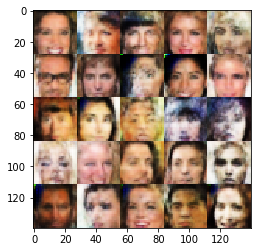

Epoch 4/8... Discriminator Loss: 1.2540... Generator Loss: 0.6748
Epoch 4/8... Discriminator Loss: 1.2539... Generator Loss: 0.7326
Epoch 4/8... Discriminator Loss: 1.2466... Generator Loss: 1.0089
Epoch 4/8... Discriminator Loss: 1.4614... Generator Loss: 0.5008
Epoch 4/8... Discriminator Loss: 1.2761... Generator Loss: 0.7720
Epoch 4/8... Discriminator Loss: 1.5635... Generator Loss: 0.3766
Epoch 4/8... Discriminator Loss: 1.2379... Generator Loss: 0.6416
Epoch 4/8... Discriminator Loss: 1.4817... Generator Loss: 0.4145
Epoch 4/8... Discriminator Loss: 1.4671... Generator Loss: 0.4569
Epoch 4/8... Discriminator Loss: 1.2702... Generator Loss: 1.1945


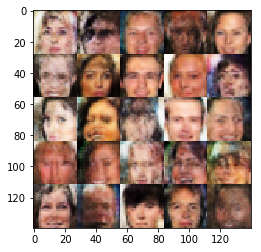

Epoch 4/8... Discriminator Loss: 1.4681... Generator Loss: 0.4976
Epoch 4/8... Discriminator Loss: 1.2324... Generator Loss: 0.8546
Epoch 4/8... Discriminator Loss: 1.2477... Generator Loss: 0.8114
Epoch 4/8... Discriminator Loss: 1.2472... Generator Loss: 0.6614
Epoch 4/8... Discriminator Loss: 1.4024... Generator Loss: 0.5088
Epoch 4/8... Discriminator Loss: 1.7227... Generator Loss: 0.3573
Epoch 4/8... Discriminator Loss: 1.2755... Generator Loss: 0.6612
Epoch 4/8... Discriminator Loss: 1.4021... Generator Loss: 0.6718
Epoch 4/8... Discriminator Loss: 1.4513... Generator Loss: 0.4585
Epoch 4/8... Discriminator Loss: 1.5558... Generator Loss: 0.4026


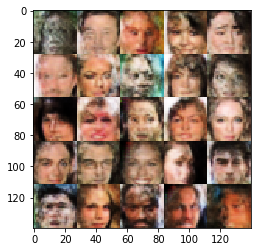

Epoch 4/8... Discriminator Loss: 1.4875... Generator Loss: 0.4710
Epoch 4/8... Discriminator Loss: 1.3088... Generator Loss: 0.9972
Epoch 4/8... Discriminator Loss: 1.1826... Generator Loss: 0.8470
Epoch 4/8... Discriminator Loss: 1.2870... Generator Loss: 0.6757
Epoch 4/8... Discriminator Loss: 1.8783... Generator Loss: 0.2633
Epoch 4/8... Discriminator Loss: 1.6955... Generator Loss: 0.3224
Epoch 4/8... Discriminator Loss: 1.3916... Generator Loss: 0.8385
Epoch 4/8... Discriminator Loss: 1.3762... Generator Loss: 0.6241
Epoch 4/8... Discriminator Loss: 1.5232... Generator Loss: 0.4477
Epoch 4/8... Discriminator Loss: 1.5925... Generator Loss: 0.4280


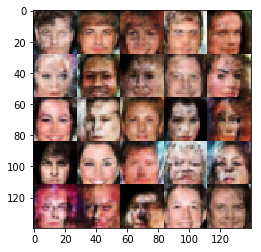

Epoch 4/8... Discriminator Loss: 1.2859... Generator Loss: 0.6843
Epoch 4/8... Discriminator Loss: 1.3239... Generator Loss: 0.7659
Epoch 4/8... Discriminator Loss: 1.2061... Generator Loss: 0.9283
Epoch 4/8... Discriminator Loss: 1.3198... Generator Loss: 0.7864
Epoch 4/8... Discriminator Loss: 1.3715... Generator Loss: 0.5576
Epoch 4/8... Discriminator Loss: 1.4544... Generator Loss: 0.5455
Epoch 4/8... Discriminator Loss: 1.2901... Generator Loss: 0.7636
Epoch 4/8... Discriminator Loss: 1.6080... Generator Loss: 0.4046
Epoch 4/8... Discriminator Loss: 1.6278... Generator Loss: 0.3774
Epoch 4/8... Discriminator Loss: 1.2856... Generator Loss: 0.6558


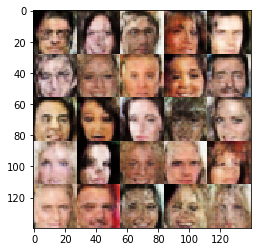

Epoch 4/8... Discriminator Loss: 1.3087... Generator Loss: 0.7606
Epoch 4/8... Discriminator Loss: 1.2767... Generator Loss: 0.6807
Epoch 4/8... Discriminator Loss: 1.3181... Generator Loss: 0.6485
Epoch 4/8... Discriminator Loss: 1.3191... Generator Loss: 0.6350
Epoch 4/8... Discriminator Loss: 1.3231... Generator Loss: 0.6737
Epoch 4/8... Discriminator Loss: 1.3993... Generator Loss: 0.5292
Epoch 4/8... Discriminator Loss: 1.3191... Generator Loss: 0.6053
Epoch 4/8... Discriminator Loss: 1.3986... Generator Loss: 0.4960
Epoch 4/8... Discriminator Loss: 1.2044... Generator Loss: 0.9927
Epoch 4/8... Discriminator Loss: 1.2763... Generator Loss: 0.6829


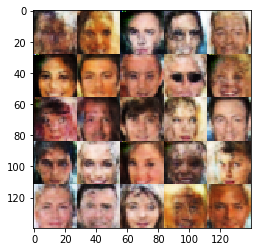

Epoch 4/8... Discriminator Loss: 1.3218... Generator Loss: 0.5929
Epoch 4/8... Discriminator Loss: 1.7895... Generator Loss: 0.2949
Epoch 4/8... Discriminator Loss: 1.2677... Generator Loss: 0.6995
Epoch 4/8... Discriminator Loss: 1.5032... Generator Loss: 0.4813
Epoch 4/8... Discriminator Loss: 1.4496... Generator Loss: 0.4846
Epoch 4/8... Discriminator Loss: 2.1056... Generator Loss: 0.2143
Epoch 4/8... Discriminator Loss: 1.4094... Generator Loss: 0.6332
Epoch 4/8... Discriminator Loss: 1.5188... Generator Loss: 0.5274
Epoch 4/8... Discriminator Loss: 1.3598... Generator Loss: 0.6195
Epoch 4/8... Discriminator Loss: 1.8407... Generator Loss: 0.2868


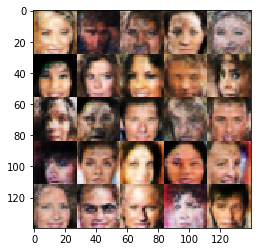

Epoch 4/8... Discriminator Loss: 1.4927... Generator Loss: 0.4399
Epoch 4/8... Discriminator Loss: 1.3386... Generator Loss: 0.6714
Epoch 4/8... Discriminator Loss: 1.3663... Generator Loss: 0.6034
Epoch 4/8... Discriminator Loss: 1.3248... Generator Loss: 0.8303
Epoch 4/8... Discriminator Loss: 1.4628... Generator Loss: 1.0716
Epoch 4/8... Discriminator Loss: 1.7682... Generator Loss: 0.2957
Epoch 4/8... Discriminator Loss: 1.4407... Generator Loss: 0.5608
Epoch 4/8... Discriminator Loss: 1.5020... Generator Loss: 0.4662
Epoch 4/8... Discriminator Loss: 1.3032... Generator Loss: 0.7161
Epoch 4/8... Discriminator Loss: 1.4684... Generator Loss: 0.4716


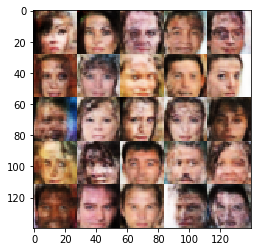

Epoch 4/8... Discriminator Loss: 1.2956... Generator Loss: 0.6052
Epoch 4/8... Discriminator Loss: 1.5072... Generator Loss: 0.4230
Epoch 4/8... Discriminator Loss: 1.4224... Generator Loss: 0.4713
Epoch 4/8... Discriminator Loss: 1.2998... Generator Loss: 0.6585
Epoch 4/8... Discriminator Loss: 1.5669... Generator Loss: 0.4207
Epoch 4/8... Discriminator Loss: 1.4615... Generator Loss: 0.4809
Epoch 4/8... Discriminator Loss: 1.2009... Generator Loss: 0.9393
Epoch 4/8... Discriminator Loss: 1.3348... Generator Loss: 0.6559
Epoch 4/8... Discriminator Loss: 1.2383... Generator Loss: 1.1862
Epoch 4/8... Discriminator Loss: 1.2714... Generator Loss: 0.6219


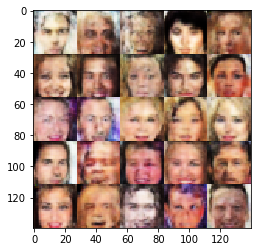

Epoch 4/8... Discriminator Loss: 1.2181... Generator Loss: 0.6407
Epoch 4/8... Discriminator Loss: 1.5022... Generator Loss: 0.4266
Epoch 4/8... Discriminator Loss: 1.2797... Generator Loss: 0.7392
Epoch 4/8... Discriminator Loss: 1.2533... Generator Loss: 0.7369
Epoch 4/8... Discriminator Loss: 1.2850... Generator Loss: 0.6110
Epoch 4/8... Discriminator Loss: 1.2187... Generator Loss: 0.7719
Epoch 4/8... Discriminator Loss: 1.3022... Generator Loss: 0.7349
Epoch 4/8... Discriminator Loss: 1.2660... Generator Loss: 0.6349
Epoch 4/8... Discriminator Loss: 1.4320... Generator Loss: 0.5401
Epoch 4/8... Discriminator Loss: 1.3813... Generator Loss: 0.5686


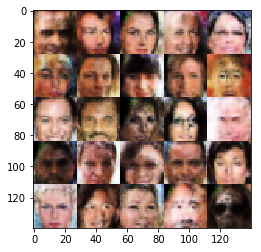

Epoch 4/8... Discriminator Loss: 1.3006... Generator Loss: 0.7650
Epoch 4/8... Discriminator Loss: 1.5148... Generator Loss: 0.4670
Epoch 4/8... Discriminator Loss: 1.8158... Generator Loss: 0.2918
Epoch 4/8... Discriminator Loss: 1.3264... Generator Loss: 0.9130
Epoch 4/8... Discriminator Loss: 1.3170... Generator Loss: 0.7829
Epoch 4/8... Discriminator Loss: 1.2942... Generator Loss: 0.9364
Epoch 4/8... Discriminator Loss: 1.3371... Generator Loss: 0.5567
Epoch 4/8... Discriminator Loss: 1.4122... Generator Loss: 0.5265
Epoch 4/8... Discriminator Loss: 1.3781... Generator Loss: 0.5020
Epoch 4/8... Discriminator Loss: 1.5156... Generator Loss: 0.4532


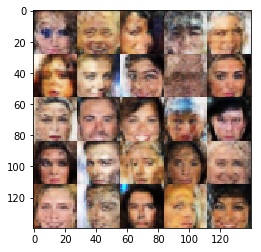

Epoch 4/8... Discriminator Loss: 1.2509... Generator Loss: 1.0354
Epoch 4/8... Discriminator Loss: 1.7012... Generator Loss: 0.3591
Epoch 4/8... Discriminator Loss: 1.6044... Generator Loss: 0.3679
Epoch 4/8... Discriminator Loss: 1.2076... Generator Loss: 0.8947
Epoch 4/8... Discriminator Loss: 1.2658... Generator Loss: 0.6965
Epoch 4/8... Discriminator Loss: 1.2758... Generator Loss: 0.9302
Epoch 4/8... Discriminator Loss: 1.4206... Generator Loss: 0.5833
Epoch 4/8... Discriminator Loss: 1.5029... Generator Loss: 0.4511
Epoch 4/8... Discriminator Loss: 1.5665... Generator Loss: 0.3987
Epoch 4/8... Discriminator Loss: 1.3410... Generator Loss: 0.7693


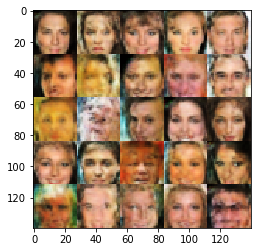

Epoch 4/8... Discriminator Loss: 1.4354... Generator Loss: 0.5247
Epoch 4/8... Discriminator Loss: 1.5975... Generator Loss: 0.3521
Epoch 4/8... Discriminator Loss: 1.1976... Generator Loss: 0.7534
Epoch 4/8... Discriminator Loss: 1.4693... Generator Loss: 0.4769
Epoch 4/8... Discriminator Loss: 1.5901... Generator Loss: 0.4074
Epoch 4/8... Discriminator Loss: 1.3805... Generator Loss: 0.5088
Epoch 4/8... Discriminator Loss: 1.4730... Generator Loss: 0.4721
Epoch 4/8... Discriminator Loss: 1.1698... Generator Loss: 0.9623
Epoch 4/8... Discriminator Loss: 1.6731... Generator Loss: 0.3453
Epoch 4/8... Discriminator Loss: 1.3072... Generator Loss: 0.8089


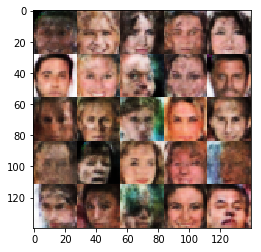

Epoch 4/8... Discriminator Loss: 1.5222... Generator Loss: 0.4531
Epoch 4/8... Discriminator Loss: 1.3698... Generator Loss: 0.6813
Epoch 4/8... Discriminator Loss: 1.4249... Generator Loss: 0.4714
Epoch 4/8... Discriminator Loss: 1.4021... Generator Loss: 0.5421
Epoch 4/8... Discriminator Loss: 1.6698... Generator Loss: 0.3561
Epoch 4/8... Discriminator Loss: 1.2977... Generator Loss: 0.6487
Epoch 4/8... Discriminator Loss: 1.3635... Generator Loss: 0.5416
Epoch 4/8... Discriminator Loss: 1.5066... Generator Loss: 0.4466
Epoch 4/8... Discriminator Loss: 1.3511... Generator Loss: 0.5962
Epoch 4/8... Discriminator Loss: 1.2124... Generator Loss: 0.9047


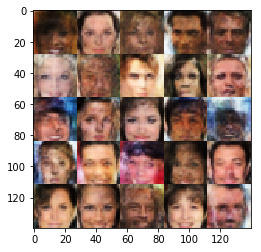

Epoch 4/8... Discriminator Loss: 1.5312... Generator Loss: 0.4611
Epoch 4/8... Discriminator Loss: 1.5918... Generator Loss: 0.3995
Epoch 4/8... Discriminator Loss: 1.4947... Generator Loss: 0.4500
Epoch 4/8... Discriminator Loss: 1.2695... Generator Loss: 0.7204
Epoch 4/8... Discriminator Loss: 1.3906... Generator Loss: 0.5523
Epoch 4/8... Discriminator Loss: 1.3937... Generator Loss: 0.5582
Epoch 4/8... Discriminator Loss: 1.4240... Generator Loss: 0.4826
Epoch 4/8... Discriminator Loss: 1.2061... Generator Loss: 1.1086
Epoch 4/8... Discriminator Loss: 1.3414... Generator Loss: 0.7601
Epoch 4/8... Discriminator Loss: 1.4551... Generator Loss: 0.5021


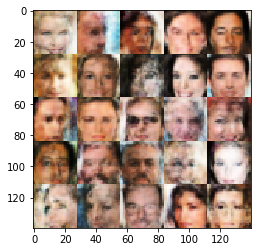

Epoch 4/8... Discriminator Loss: 1.3842... Generator Loss: 0.6602
Epoch 4/8... Discriminator Loss: 1.3989... Generator Loss: 0.5382
Epoch 4/8... Discriminator Loss: 1.4916... Generator Loss: 1.5924
Epoch 4/8... Discriminator Loss: 1.5563... Generator Loss: 0.3917
Epoch 4/8... Discriminator Loss: 1.4539... Generator Loss: 0.4670
Epoch 4/8... Discriminator Loss: 1.4230... Generator Loss: 0.5047
Epoch 4/8... Discriminator Loss: 1.4326... Generator Loss: 0.4537
Epoch 4/8... Discriminator Loss: 1.3858... Generator Loss: 0.5406
Epoch 4/8... Discriminator Loss: 1.2703... Generator Loss: 0.7692
Epoch 4/8... Discriminator Loss: 1.3230... Generator Loss: 0.8896


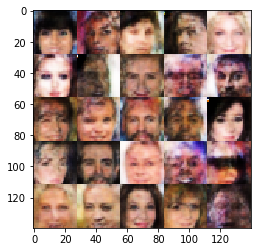

Epoch 4/8... Discriminator Loss: 1.3099... Generator Loss: 1.2991
Epoch 4/8... Discriminator Loss: 1.7482... Generator Loss: 0.3105
Epoch 4/8... Discriminator Loss: 1.3014... Generator Loss: 0.7332
Epoch 4/8... Discriminator Loss: 1.2817... Generator Loss: 0.9632
Epoch 4/8... Discriminator Loss: 1.4203... Generator Loss: 0.4981
Epoch 4/8... Discriminator Loss: 1.2856... Generator Loss: 0.7009
Epoch 4/8... Discriminator Loss: 1.4634... Generator Loss: 1.3002
Epoch 4/8... Discriminator Loss: 1.4822... Generator Loss: 0.4544
Epoch 4/8... Discriminator Loss: 1.2534... Generator Loss: 1.0150
Epoch 4/8... Discriminator Loss: 1.2804... Generator Loss: 0.8704


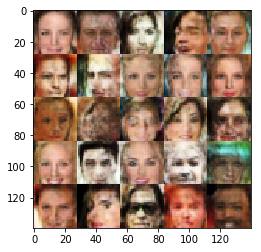

Epoch 4/8... Discriminator Loss: 1.2890... Generator Loss: 0.6344
Epoch 4/8... Discriminator Loss: 1.5667... Generator Loss: 0.4052
Epoch 4/8... Discriminator Loss: 1.3800... Generator Loss: 0.5895
Epoch 4/8... Discriminator Loss: 1.4302... Generator Loss: 0.6929
Epoch 4/8... Discriminator Loss: 1.1943... Generator Loss: 0.9506
Epoch 4/8... Discriminator Loss: 1.3452... Generator Loss: 1.0874
Epoch 4/8... Discriminator Loss: 1.2519... Generator Loss: 0.7197
Epoch 4/8... Discriminator Loss: 1.3292... Generator Loss: 0.7138
Epoch 4/8... Discriminator Loss: 1.6934... Generator Loss: 0.3301
Epoch 4/8... Discriminator Loss: 1.2701... Generator Loss: 0.8028


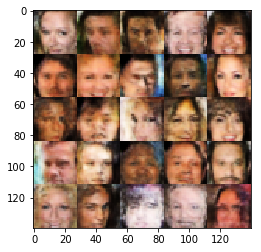

Epoch 4/8... Discriminator Loss: 1.1914... Generator Loss: 0.9232
Epoch 4/8... Discriminator Loss: 1.5218... Generator Loss: 0.4286
Epoch 4/8... Discriminator Loss: 1.4598... Generator Loss: 0.5228
Epoch 4/8... Discriminator Loss: 1.5590... Generator Loss: 0.4174
Epoch 4/8... Discriminator Loss: 1.2349... Generator Loss: 0.9880
Epoch 4/8... Discriminator Loss: 1.4411... Generator Loss: 0.4838
Epoch 4/8... Discriminator Loss: 1.1824... Generator Loss: 0.8262
Epoch 4/8... Discriminator Loss: 1.6455... Generator Loss: 0.3512
Epoch 4/8... Discriminator Loss: 1.2734... Generator Loss: 0.8321
Epoch 4/8... Discriminator Loss: 1.3294... Generator Loss: 0.6641


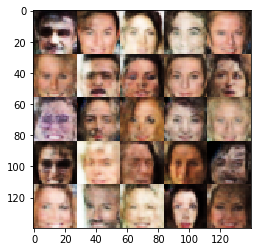

Epoch 4/8... Discriminator Loss: 1.4968... Generator Loss: 0.4377
Epoch 4/8... Discriminator Loss: 1.2042... Generator Loss: 0.7993
Epoch 4/8... Discriminator Loss: 1.3628... Generator Loss: 0.5971
Epoch 4/8... Discriminator Loss: 1.4386... Generator Loss: 0.4828
Epoch 4/8... Discriminator Loss: 1.8291... Generator Loss: 0.2756
Epoch 4/8... Discriminator Loss: 1.6013... Generator Loss: 0.3923
Epoch 4/8... Discriminator Loss: 1.6153... Generator Loss: 0.3610
Epoch 4/8... Discriminator Loss: 1.3834... Generator Loss: 0.5397
Epoch 4/8... Discriminator Loss: 1.6625... Generator Loss: 0.3676
Epoch 4/8... Discriminator Loss: 1.3756... Generator Loss: 0.5324


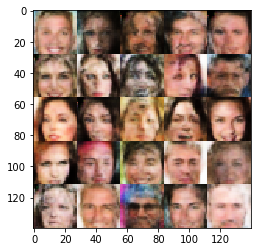

Epoch 4/8... Discriminator Loss: 1.4777... Generator Loss: 0.4286
Epoch 4/8... Discriminator Loss: 1.3530... Generator Loss: 0.6086
Epoch 4/8... Discriminator Loss: 1.2172... Generator Loss: 0.7768
Epoch 4/8... Discriminator Loss: 1.4547... Generator Loss: 0.4452
Epoch 4/8... Discriminator Loss: 1.4525... Generator Loss: 0.4472
Epoch 4/8... Discriminator Loss: 1.4272... Generator Loss: 0.5290
Epoch 5/8... Discriminator Loss: 1.2468... Generator Loss: 1.1217
Epoch 5/8... Discriminator Loss: 1.2770... Generator Loss: 0.6435
Epoch 5/8... Discriminator Loss: 1.3260... Generator Loss: 0.7388
Epoch 5/8... Discriminator Loss: 1.6011... Generator Loss: 0.3957


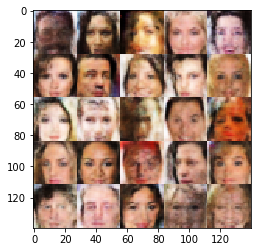

Epoch 5/8... Discriminator Loss: 1.2578... Generator Loss: 1.0014
Epoch 5/8... Discriminator Loss: 1.9229... Generator Loss: 0.2398
Epoch 5/8... Discriminator Loss: 1.4495... Generator Loss: 0.4629
Epoch 5/8... Discriminator Loss: 1.2554... Generator Loss: 0.7342
Epoch 5/8... Discriminator Loss: 1.3397... Generator Loss: 0.6334
Epoch 5/8... Discriminator Loss: 1.4233... Generator Loss: 0.5356
Epoch 5/8... Discriminator Loss: 1.1871... Generator Loss: 0.8712
Epoch 5/8... Discriminator Loss: 1.3430... Generator Loss: 0.7219
Epoch 5/8... Discriminator Loss: 1.5664... Generator Loss: 0.3878
Epoch 5/8... Discriminator Loss: 1.6689... Generator Loss: 0.3427


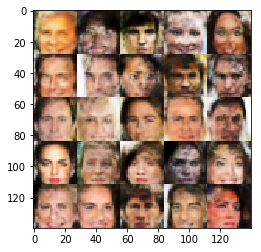

Epoch 5/8... Discriminator Loss: 1.6960... Generator Loss: 0.3301
Epoch 5/8... Discriminator Loss: 1.4537... Generator Loss: 0.5160
Epoch 5/8... Discriminator Loss: 1.2670... Generator Loss: 0.7935
Epoch 5/8... Discriminator Loss: 1.4374... Generator Loss: 0.5045
Epoch 5/8... Discriminator Loss: 1.6257... Generator Loss: 0.4046
Epoch 5/8... Discriminator Loss: 1.1845... Generator Loss: 0.8321
Epoch 5/8... Discriminator Loss: 1.3463... Generator Loss: 0.7053
Epoch 5/8... Discriminator Loss: 1.3008... Generator Loss: 1.0525
Epoch 5/8... Discriminator Loss: 1.2595... Generator Loss: 0.6939
Epoch 5/8... Discriminator Loss: 1.3925... Generator Loss: 0.5683


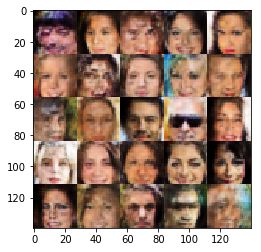

Epoch 5/8... Discriminator Loss: 1.2732... Generator Loss: 0.7061
Epoch 5/8... Discriminator Loss: 1.3779... Generator Loss: 0.5312
Epoch 5/8... Discriminator Loss: 1.3586... Generator Loss: 0.6380
Epoch 5/8... Discriminator Loss: 1.5192... Generator Loss: 0.4193
Epoch 5/8... Discriminator Loss: 1.2624... Generator Loss: 0.7100
Epoch 5/8... Discriminator Loss: 1.1645... Generator Loss: 0.9915
Epoch 5/8... Discriminator Loss: 1.3093... Generator Loss: 1.0520
Epoch 5/8... Discriminator Loss: 1.7465... Generator Loss: 0.3397
Epoch 5/8... Discriminator Loss: 1.3420... Generator Loss: 0.6222
Epoch 5/8... Discriminator Loss: 1.4160... Generator Loss: 0.5950


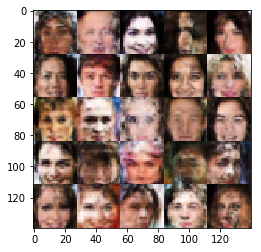

Epoch 5/8... Discriminator Loss: 1.5795... Generator Loss: 0.3829
Epoch 5/8... Discriminator Loss: 1.1664... Generator Loss: 1.4025
Epoch 5/8... Discriminator Loss: 1.5181... Generator Loss: 0.4656
Epoch 5/8... Discriminator Loss: 1.4088... Generator Loss: 0.5254
Epoch 5/8... Discriminator Loss: 1.4193... Generator Loss: 0.4908
Epoch 5/8... Discriminator Loss: 1.4675... Generator Loss: 0.4690
Epoch 5/8... Discriminator Loss: 1.5511... Generator Loss: 0.4224
Epoch 5/8... Discriminator Loss: 1.2513... Generator Loss: 0.7863
Epoch 5/8... Discriminator Loss: 1.2509... Generator Loss: 1.0319
Epoch 5/8... Discriminator Loss: 1.2769... Generator Loss: 0.7239


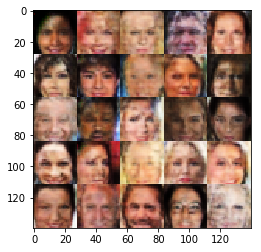

Epoch 5/8... Discriminator Loss: 1.2474... Generator Loss: 0.7643
Epoch 5/8... Discriminator Loss: 1.5361... Generator Loss: 0.4171
Epoch 5/8... Discriminator Loss: 1.2638... Generator Loss: 0.7849
Epoch 5/8... Discriminator Loss: 1.7058... Generator Loss: 0.3425
Epoch 5/8... Discriminator Loss: 1.2423... Generator Loss: 1.0290
Epoch 5/8... Discriminator Loss: 1.6630... Generator Loss: 0.3451
Epoch 5/8... Discriminator Loss: 1.2865... Generator Loss: 0.6195
Epoch 5/8... Discriminator Loss: 1.3213... Generator Loss: 0.6738
Epoch 5/8... Discriminator Loss: 1.2962... Generator Loss: 0.7105
Epoch 5/8... Discriminator Loss: 1.3127... Generator Loss: 1.1413


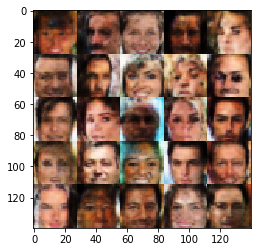

Epoch 5/8... Discriminator Loss: 1.3655... Generator Loss: 0.6442
Epoch 5/8... Discriminator Loss: 1.2864... Generator Loss: 0.8343
Epoch 5/8... Discriminator Loss: 1.4942... Generator Loss: 0.4709
Epoch 5/8... Discriminator Loss: 1.2322... Generator Loss: 1.1404
Epoch 5/8... Discriminator Loss: 1.3703... Generator Loss: 1.3782
Epoch 5/8... Discriminator Loss: 1.3493... Generator Loss: 0.6713
Epoch 5/8... Discriminator Loss: 1.3254... Generator Loss: 0.6612
Epoch 5/8... Discriminator Loss: 1.5429... Generator Loss: 0.3899
Epoch 5/8... Discriminator Loss: 1.3018... Generator Loss: 0.7957
Epoch 5/8... Discriminator Loss: 1.3073... Generator Loss: 0.6662


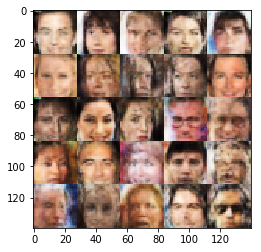

Epoch 5/8... Discriminator Loss: 1.3602... Generator Loss: 0.6686
Epoch 5/8... Discriminator Loss: 1.4391... Generator Loss: 0.5251
Epoch 5/8... Discriminator Loss: 1.7363... Generator Loss: 0.3260
Epoch 5/8... Discriminator Loss: 1.4549... Generator Loss: 0.4775
Epoch 5/8... Discriminator Loss: 1.4300... Generator Loss: 0.4948
Epoch 5/8... Discriminator Loss: 1.6808... Generator Loss: 0.3508
Epoch 5/8... Discriminator Loss: 1.3546... Generator Loss: 0.6085
Epoch 5/8... Discriminator Loss: 1.3052... Generator Loss: 0.6518
Epoch 5/8... Discriminator Loss: 1.6180... Generator Loss: 0.3482
Epoch 5/8... Discriminator Loss: 1.3035... Generator Loss: 1.2716


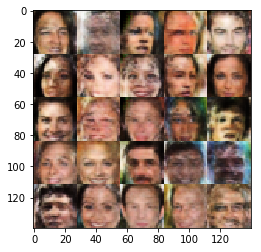

Epoch 5/8... Discriminator Loss: 1.5428... Generator Loss: 0.4194
Epoch 5/8... Discriminator Loss: 1.3810... Generator Loss: 0.5172
Epoch 5/8... Discriminator Loss: 1.5589... Generator Loss: 0.3801
Epoch 5/8... Discriminator Loss: 1.3729... Generator Loss: 0.5806
Epoch 5/8... Discriminator Loss: 1.2462... Generator Loss: 0.8588
Epoch 5/8... Discriminator Loss: 1.3892... Generator Loss: 1.4454
Epoch 5/8... Discriminator Loss: 1.5833... Generator Loss: 0.3925
Epoch 5/8... Discriminator Loss: 1.4246... Generator Loss: 0.5210
Epoch 5/8... Discriminator Loss: 1.2205... Generator Loss: 0.8716
Epoch 5/8... Discriminator Loss: 1.3605... Generator Loss: 0.6078


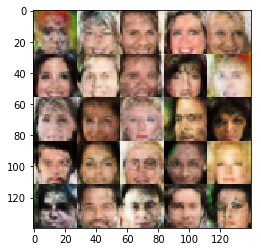

Epoch 5/8... Discriminator Loss: 1.5142... Generator Loss: 0.4030
Epoch 5/8... Discriminator Loss: 1.3670... Generator Loss: 0.8319
Epoch 5/8... Discriminator Loss: 1.3809... Generator Loss: 0.5538
Epoch 5/8... Discriminator Loss: 1.3022... Generator Loss: 0.6918
Epoch 5/8... Discriminator Loss: 1.3149... Generator Loss: 1.0461
Epoch 5/8... Discriminator Loss: 1.4092... Generator Loss: 0.5422
Epoch 5/8... Discriminator Loss: 1.4762... Generator Loss: 0.4752
Epoch 5/8... Discriminator Loss: 1.2976... Generator Loss: 0.8784
Epoch 5/8... Discriminator Loss: 1.4582... Generator Loss: 0.5593
Epoch 5/8... Discriminator Loss: 1.6504... Generator Loss: 0.3460


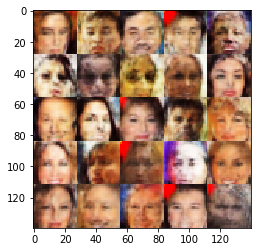

Epoch 5/8... Discriminator Loss: 1.4363... Generator Loss: 0.4643
Epoch 5/8... Discriminator Loss: 1.5872... Generator Loss: 0.3831
Epoch 5/8... Discriminator Loss: 1.4889... Generator Loss: 0.4286
Epoch 5/8... Discriminator Loss: 1.6259... Generator Loss: 0.3708
Epoch 5/8... Discriminator Loss: 1.2178... Generator Loss: 1.0932
Epoch 5/8... Discriminator Loss: 1.4786... Generator Loss: 0.4824
Epoch 5/8... Discriminator Loss: 1.3396... Generator Loss: 0.5488
Epoch 5/8... Discriminator Loss: 1.3918... Generator Loss: 0.5729
Epoch 5/8... Discriminator Loss: 1.7200... Generator Loss: 0.3039
Epoch 5/8... Discriminator Loss: 1.6442... Generator Loss: 0.3798


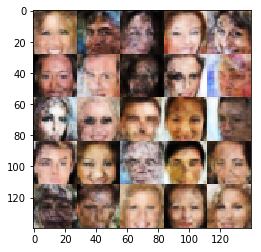

Epoch 5/8... Discriminator Loss: 1.3177... Generator Loss: 0.6705
Epoch 5/8... Discriminator Loss: 1.3319... Generator Loss: 0.8703
Epoch 5/8... Discriminator Loss: 1.4114... Generator Loss: 0.5562
Epoch 5/8... Discriminator Loss: 1.3202... Generator Loss: 0.7625
Epoch 5/8... Discriminator Loss: 1.4203... Generator Loss: 0.5515
Epoch 5/8... Discriminator Loss: 1.4298... Generator Loss: 0.5217
Epoch 5/8... Discriminator Loss: 1.5407... Generator Loss: 0.4088
Epoch 5/8... Discriminator Loss: 1.2446... Generator Loss: 0.8711
Epoch 5/8... Discriminator Loss: 1.3245... Generator Loss: 0.7008
Epoch 5/8... Discriminator Loss: 1.2573... Generator Loss: 1.0179


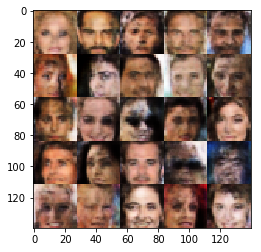

Epoch 5/8... Discriminator Loss: 1.5926... Generator Loss: 0.3951
Epoch 5/8... Discriminator Loss: 1.4899... Generator Loss: 0.4800
Epoch 5/8... Discriminator Loss: 1.6314... Generator Loss: 0.3591
Epoch 5/8... Discriminator Loss: 1.4013... Generator Loss: 0.5525
Epoch 5/8... Discriminator Loss: 1.3076... Generator Loss: 0.5521
Epoch 5/8... Discriminator Loss: 1.4431... Generator Loss: 0.4962
Epoch 5/8... Discriminator Loss: 1.1962... Generator Loss: 0.7930
Epoch 5/8... Discriminator Loss: 1.2755... Generator Loss: 0.6648
Epoch 5/8... Discriminator Loss: 1.2275... Generator Loss: 0.7941
Epoch 5/8... Discriminator Loss: 1.3306... Generator Loss: 1.2298


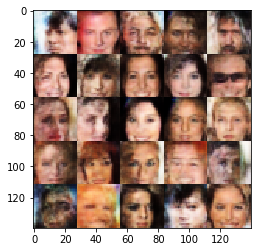

Epoch 5/8... Discriminator Loss: 1.4170... Generator Loss: 0.5056
Epoch 5/8... Discriminator Loss: 1.3723... Generator Loss: 0.6048
Epoch 5/8... Discriminator Loss: 1.3182... Generator Loss: 0.5676
Epoch 5/8... Discriminator Loss: 1.2685... Generator Loss: 0.7633
Epoch 5/8... Discriminator Loss: 1.8748... Generator Loss: 0.2541
Epoch 5/8... Discriminator Loss: 1.1945... Generator Loss: 0.9281
Epoch 5/8... Discriminator Loss: 1.2619... Generator Loss: 1.0496
Epoch 5/8... Discriminator Loss: 1.4722... Generator Loss: 0.5215
Epoch 5/8... Discriminator Loss: 1.5705... Generator Loss: 0.3843
Epoch 5/8... Discriminator Loss: 1.5875... Generator Loss: 0.3683


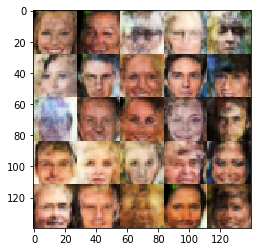

Epoch 5/8... Discriminator Loss: 1.2380... Generator Loss: 0.7730
Epoch 5/8... Discriminator Loss: 1.4003... Generator Loss: 0.4872
Epoch 5/8... Discriminator Loss: 1.3626... Generator Loss: 0.8398
Epoch 5/8... Discriminator Loss: 1.7586... Generator Loss: 0.3051
Epoch 5/8... Discriminator Loss: 1.4525... Generator Loss: 0.4971
Epoch 5/8... Discriminator Loss: 1.4367... Generator Loss: 0.4412
Epoch 5/8... Discriminator Loss: 1.2038... Generator Loss: 1.0364
Epoch 5/8... Discriminator Loss: 1.6800... Generator Loss: 0.3482
Epoch 5/8... Discriminator Loss: 1.3865... Generator Loss: 0.5334
Epoch 5/8... Discriminator Loss: 1.6802... Generator Loss: 0.3428


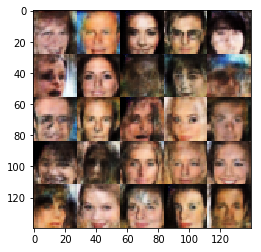

Epoch 5/8... Discriminator Loss: 1.3603... Generator Loss: 0.6572
Epoch 5/8... Discriminator Loss: 1.6497... Generator Loss: 0.3529
Epoch 5/8... Discriminator Loss: 1.3333... Generator Loss: 0.6959
Epoch 5/8... Discriminator Loss: 1.3931... Generator Loss: 0.8435
Epoch 5/8... Discriminator Loss: 1.4028... Generator Loss: 0.4993
Epoch 5/8... Discriminator Loss: 1.4860... Generator Loss: 0.4793
Epoch 5/8... Discriminator Loss: 1.6698... Generator Loss: 0.3475
Epoch 5/8... Discriminator Loss: 1.6103... Generator Loss: 0.3807
Epoch 5/8... Discriminator Loss: 1.2443... Generator Loss: 0.8655
Epoch 5/8... Discriminator Loss: 1.2237... Generator Loss: 1.1176


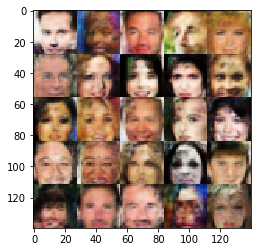

Epoch 5/8... Discriminator Loss: 1.7152... Generator Loss: 0.3342
Epoch 5/8... Discriminator Loss: 1.3498... Generator Loss: 0.6483
Epoch 5/8... Discriminator Loss: 1.3394... Generator Loss: 0.8668
Epoch 5/8... Discriminator Loss: 1.3082... Generator Loss: 0.6963
Epoch 5/8... Discriminator Loss: 1.1908... Generator Loss: 0.7695
Epoch 5/8... Discriminator Loss: 1.4334... Generator Loss: 0.5362
Epoch 5/8... Discriminator Loss: 1.7225... Generator Loss: 0.3370
Epoch 5/8... Discriminator Loss: 1.1125... Generator Loss: 0.9455
Epoch 5/8... Discriminator Loss: 1.2506... Generator Loss: 1.5024
Epoch 5/8... Discriminator Loss: 1.2736... Generator Loss: 0.9441


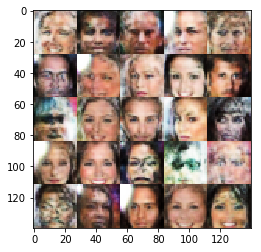

Epoch 5/8... Discriminator Loss: 1.3593... Generator Loss: 0.6854
Epoch 5/8... Discriminator Loss: 1.2611... Generator Loss: 1.2064
Epoch 5/8... Discriminator Loss: 1.2700... Generator Loss: 0.7319
Epoch 5/8... Discriminator Loss: 1.7884... Generator Loss: 0.3059
Epoch 5/8... Discriminator Loss: 1.3114... Generator Loss: 0.6399
Epoch 5/8... Discriminator Loss: 1.2083... Generator Loss: 0.8265
Epoch 5/8... Discriminator Loss: 1.4572... Generator Loss: 0.5707
Epoch 5/8... Discriminator Loss: 1.6687... Generator Loss: 0.3305
Epoch 5/8... Discriminator Loss: 1.3642... Generator Loss: 0.5540
Epoch 5/8... Discriminator Loss: 1.3756... Generator Loss: 0.6460


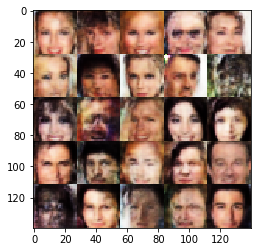

Epoch 5/8... Discriminator Loss: 1.6993... Generator Loss: 0.3255
Epoch 5/8... Discriminator Loss: 1.2744... Generator Loss: 0.8047
Epoch 5/8... Discriminator Loss: 2.0486... Generator Loss: 0.2230
Epoch 5/8... Discriminator Loss: 1.5071... Generator Loss: 0.4031
Epoch 5/8... Discriminator Loss: 1.1590... Generator Loss: 1.0430
Epoch 5/8... Discriminator Loss: 1.3036... Generator Loss: 0.7484
Epoch 5/8... Discriminator Loss: 1.2570... Generator Loss: 0.8508
Epoch 5/8... Discriminator Loss: 1.3937... Generator Loss: 0.5553
Epoch 5/8... Discriminator Loss: 1.6543... Generator Loss: 0.3625
Epoch 5/8... Discriminator Loss: 1.3583... Generator Loss: 0.5787


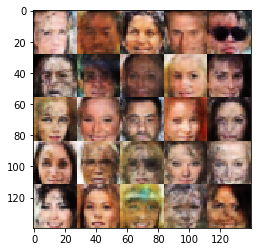

Epoch 5/8... Discriminator Loss: 1.2838... Generator Loss: 0.8257
Epoch 5/8... Discriminator Loss: 1.1794... Generator Loss: 0.7548
Epoch 5/8... Discriminator Loss: 1.2460... Generator Loss: 0.6492
Epoch 5/8... Discriminator Loss: 1.3857... Generator Loss: 0.5539
Epoch 5/8... Discriminator Loss: 1.2801... Generator Loss: 1.1673
Epoch 5/8... Discriminator Loss: 1.2182... Generator Loss: 0.8658
Epoch 5/8... Discriminator Loss: 1.3451... Generator Loss: 0.5870
Epoch 5/8... Discriminator Loss: 1.2726... Generator Loss: 0.7365
Epoch 5/8... Discriminator Loss: 1.3823... Generator Loss: 1.1163
Epoch 5/8... Discriminator Loss: 1.3501... Generator Loss: 0.5525


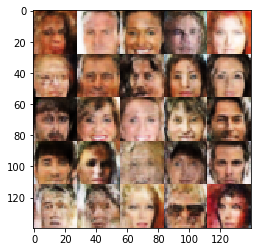

Epoch 5/8... Discriminator Loss: 1.3804... Generator Loss: 0.5607
Epoch 5/8... Discriminator Loss: 1.3721... Generator Loss: 0.5780
Epoch 5/8... Discriminator Loss: 1.2882... Generator Loss: 0.9211
Epoch 5/8... Discriminator Loss: 1.2742... Generator Loss: 0.6769
Epoch 5/8... Discriminator Loss: 1.1734... Generator Loss: 1.1726
Epoch 5/8... Discriminator Loss: 1.3209... Generator Loss: 0.5973
Epoch 5/8... Discriminator Loss: 1.2266... Generator Loss: 0.7627
Epoch 5/8... Discriminator Loss: 1.2343... Generator Loss: 0.7261
Epoch 5/8... Discriminator Loss: 1.3685... Generator Loss: 0.5204
Epoch 5/8... Discriminator Loss: 1.3175... Generator Loss: 0.6135


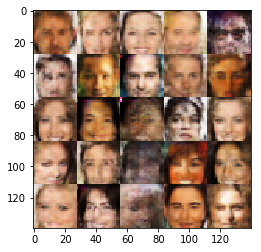

Epoch 5/8... Discriminator Loss: 1.3294... Generator Loss: 0.6807
Epoch 5/8... Discriminator Loss: 1.2321... Generator Loss: 0.8281
Epoch 5/8... Discriminator Loss: 1.2799... Generator Loss: 0.6163
Epoch 5/8... Discriminator Loss: 1.3770... Generator Loss: 0.6983
Epoch 5/8... Discriminator Loss: 1.2148... Generator Loss: 0.7166
Epoch 5/8... Discriminator Loss: 1.3512... Generator Loss: 1.0221
Epoch 5/8... Discriminator Loss: 1.1849... Generator Loss: 1.2713
Epoch 5/8... Discriminator Loss: 1.3284... Generator Loss: 0.6414
Epoch 5/8... Discriminator Loss: 1.2541... Generator Loss: 0.8352
Epoch 5/8... Discriminator Loss: 1.2931... Generator Loss: 0.6768


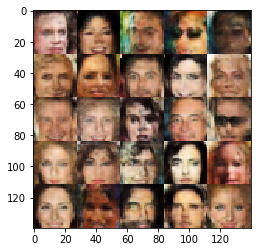

Epoch 5/8... Discriminator Loss: 1.2913... Generator Loss: 0.9562
Epoch 5/8... Discriminator Loss: 1.2966... Generator Loss: 0.5893
Epoch 5/8... Discriminator Loss: 1.3509... Generator Loss: 0.6114
Epoch 5/8... Discriminator Loss: 1.2426... Generator Loss: 1.1007
Epoch 5/8... Discriminator Loss: 1.4323... Generator Loss: 0.5093
Epoch 5/8... Discriminator Loss: 1.4717... Generator Loss: 0.4443
Epoch 5/8... Discriminator Loss: 1.3403... Generator Loss: 0.6546
Epoch 5/8... Discriminator Loss: 1.4579... Generator Loss: 0.5139
Epoch 5/8... Discriminator Loss: 1.3089... Generator Loss: 0.8844
Epoch 5/8... Discriminator Loss: 1.2891... Generator Loss: 0.6623


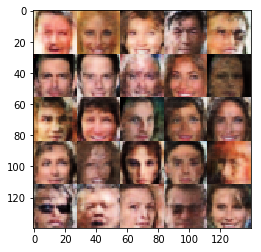

Epoch 5/8... Discriminator Loss: 1.4833... Generator Loss: 0.4478
Epoch 5/8... Discriminator Loss: 1.4222... Generator Loss: 0.5595
Epoch 5/8... Discriminator Loss: 1.4032... Generator Loss: 0.5039
Epoch 5/8... Discriminator Loss: 1.6771... Generator Loss: 0.3402
Epoch 5/8... Discriminator Loss: 1.4889... Generator Loss: 0.4701
Epoch 5/8... Discriminator Loss: 1.3928... Generator Loss: 0.5622
Epoch 5/8... Discriminator Loss: 1.2291... Generator Loss: 0.7255
Epoch 5/8... Discriminator Loss: 1.2583... Generator Loss: 0.8063
Epoch 5/8... Discriminator Loss: 1.7265... Generator Loss: 0.3653
Epoch 5/8... Discriminator Loss: 1.5378... Generator Loss: 0.4431


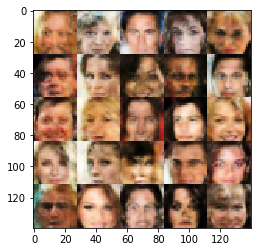

Epoch 5/8... Discriminator Loss: 1.3047... Generator Loss: 0.6787
Epoch 5/8... Discriminator Loss: 1.3322... Generator Loss: 0.5601
Epoch 5/8... Discriminator Loss: 1.2857... Generator Loss: 0.7451
Epoch 5/8... Discriminator Loss: 1.1849... Generator Loss: 0.9669
Epoch 5/8... Discriminator Loss: 1.2732... Generator Loss: 0.8252
Epoch 5/8... Discriminator Loss: 1.1897... Generator Loss: 0.7463
Epoch 5/8... Discriminator Loss: 1.5733... Generator Loss: 0.4081
Epoch 5/8... Discriminator Loss: 1.2293... Generator Loss: 0.9944
Epoch 5/8... Discriminator Loss: 1.2609... Generator Loss: 1.0103
Epoch 5/8... Discriminator Loss: 1.3947... Generator Loss: 0.7094


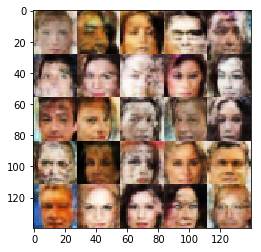

Epoch 5/8... Discriminator Loss: 1.2985... Generator Loss: 0.6066
Epoch 5/8... Discriminator Loss: 1.2915... Generator Loss: 0.7626
Epoch 5/8... Discriminator Loss: 1.4093... Generator Loss: 0.5440
Epoch 5/8... Discriminator Loss: 1.2240... Generator Loss: 0.7990
Epoch 5/8... Discriminator Loss: 1.3149... Generator Loss: 0.6241
Epoch 5/8... Discriminator Loss: 1.4663... Generator Loss: 0.5536
Epoch 5/8... Discriminator Loss: 1.3881... Generator Loss: 1.0382
Epoch 5/8... Discriminator Loss: 1.5112... Generator Loss: 0.4657
Epoch 5/8... Discriminator Loss: 1.3506... Generator Loss: 0.8267
Epoch 5/8... Discriminator Loss: 1.5065... Generator Loss: 0.4835


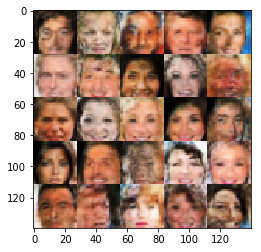

Epoch 5/8... Discriminator Loss: 1.7282... Generator Loss: 0.3072
Epoch 5/8... Discriminator Loss: 1.6354... Generator Loss: 0.3793
Epoch 5/8... Discriminator Loss: 1.4770... Generator Loss: 0.5192
Epoch 5/8... Discriminator Loss: 1.3900... Generator Loss: 0.5838
Epoch 5/8... Discriminator Loss: 1.4327... Generator Loss: 0.4706
Epoch 5/8... Discriminator Loss: 1.6024... Generator Loss: 0.3665
Epoch 5/8... Discriminator Loss: 1.5962... Generator Loss: 0.4384
Epoch 5/8... Discriminator Loss: 1.2056... Generator Loss: 0.7754
Epoch 5/8... Discriminator Loss: 1.4283... Generator Loss: 0.5545
Epoch 5/8... Discriminator Loss: 1.5549... Generator Loss: 0.4049


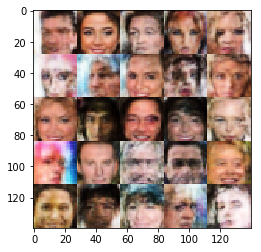

Epoch 5/8... Discriminator Loss: 1.2100... Generator Loss: 0.8117
Epoch 5/8... Discriminator Loss: 1.5360... Generator Loss: 0.5244
Epoch 5/8... Discriminator Loss: 1.5407... Generator Loss: 0.3846
Epoch 5/8... Discriminator Loss: 1.5643... Generator Loss: 0.3887
Epoch 5/8... Discriminator Loss: 1.3693... Generator Loss: 0.5482
Epoch 5/8... Discriminator Loss: 1.3318... Generator Loss: 0.5798
Epoch 5/8... Discriminator Loss: 1.1421... Generator Loss: 0.9178
Epoch 5/8... Discriminator Loss: 1.2242... Generator Loss: 0.7611
Epoch 5/8... Discriminator Loss: 1.3254... Generator Loss: 0.6147
Epoch 5/8... Discriminator Loss: 1.2552... Generator Loss: 1.1058


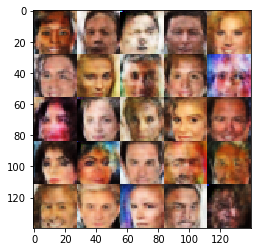

Epoch 5/8... Discriminator Loss: 1.5795... Generator Loss: 0.3921
Epoch 5/8... Discriminator Loss: 1.4692... Generator Loss: 0.4648
Epoch 5/8... Discriminator Loss: 1.7171... Generator Loss: 0.3320
Epoch 5/8... Discriminator Loss: 1.5253... Generator Loss: 0.4503
Epoch 5/8... Discriminator Loss: 1.3593... Generator Loss: 0.6500
Epoch 5/8... Discriminator Loss: 1.6690... Generator Loss: 0.3584
Epoch 5/8... Discriminator Loss: 1.4558... Generator Loss: 0.5195
Epoch 5/8... Discriminator Loss: 1.3065... Generator Loss: 0.5812
Epoch 5/8... Discriminator Loss: 1.6050... Generator Loss: 0.3888
Epoch 5/8... Discriminator Loss: 1.3815... Generator Loss: 0.5686


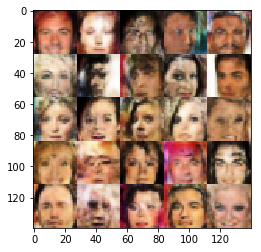

Epoch 5/8... Discriminator Loss: 1.2497... Generator Loss: 0.7654
Epoch 5/8... Discriminator Loss: 1.3011... Generator Loss: 0.6526
Epoch 5/8... Discriminator Loss: 1.4317... Generator Loss: 0.5013
Epoch 5/8... Discriminator Loss: 1.2694... Generator Loss: 0.6504
Epoch 5/8... Discriminator Loss: 1.5378... Generator Loss: 0.4250
Epoch 5/8... Discriminator Loss: 1.3083... Generator Loss: 0.8652
Epoch 5/8... Discriminator Loss: 1.3070... Generator Loss: 0.7725
Epoch 5/8... Discriminator Loss: 1.3351... Generator Loss: 0.7216
Epoch 5/8... Discriminator Loss: 1.2877... Generator Loss: 0.6523
Epoch 5/8... Discriminator Loss: 1.2977... Generator Loss: 0.6661


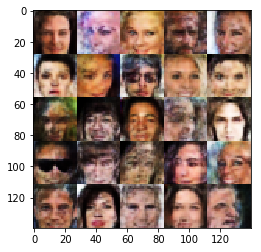

Epoch 5/8... Discriminator Loss: 1.4857... Generator Loss: 0.5248
Epoch 5/8... Discriminator Loss: 1.2237... Generator Loss: 0.9969
Epoch 5/8... Discriminator Loss: 1.2333... Generator Loss: 1.2786
Epoch 5/8... Discriminator Loss: 1.2253... Generator Loss: 0.8780
Epoch 5/8... Discriminator Loss: 1.3621... Generator Loss: 0.6148
Epoch 5/8... Discriminator Loss: 1.6474... Generator Loss: 0.3783
Epoch 5/8... Discriminator Loss: 1.2918... Generator Loss: 0.6335
Epoch 5/8... Discriminator Loss: 1.2210... Generator Loss: 1.0799
Epoch 5/8... Discriminator Loss: 1.2450... Generator Loss: 0.8678
Epoch 5/8... Discriminator Loss: 1.5183... Generator Loss: 0.4343


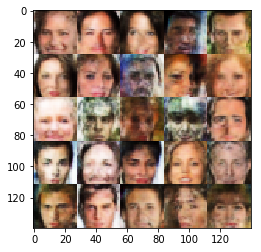

Epoch 5/8... Discriminator Loss: 1.3684... Generator Loss: 0.8195
Epoch 5/8... Discriminator Loss: 1.4953... Generator Loss: 0.4107
Epoch 5/8... Discriminator Loss: 1.3784... Generator Loss: 0.6351
Epoch 5/8... Discriminator Loss: 1.3330... Generator Loss: 1.1397
Epoch 5/8... Discriminator Loss: 1.3432... Generator Loss: 0.6292
Epoch 5/8... Discriminator Loss: 1.6017... Generator Loss: 0.3721
Epoch 5/8... Discriminator Loss: 1.4469... Generator Loss: 0.4884
Epoch 5/8... Discriminator Loss: 1.3261... Generator Loss: 0.5849
Epoch 5/8... Discriminator Loss: 1.4827... Generator Loss: 0.4428
Epoch 5/8... Discriminator Loss: 1.3351... Generator Loss: 0.6352


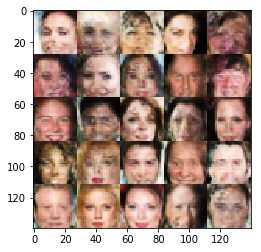

Epoch 5/8... Discriminator Loss: 1.2691... Generator Loss: 0.9451
Epoch 5/8... Discriminator Loss: 1.3512... Generator Loss: 0.6589
Epoch 6/8... Discriminator Loss: 1.3123... Generator Loss: 0.8303
Epoch 6/8... Discriminator Loss: 1.3700... Generator Loss: 0.7427
Epoch 6/8... Discriminator Loss: 1.3401... Generator Loss: 0.7080
Epoch 6/8... Discriminator Loss: 1.4536... Generator Loss: 0.5330
Epoch 6/8... Discriminator Loss: 1.4649... Generator Loss: 0.4760
Epoch 6/8... Discriminator Loss: 1.4066... Generator Loss: 0.6016
Epoch 6/8... Discriminator Loss: 1.4771... Generator Loss: 0.4874
Epoch 6/8... Discriminator Loss: 1.3094... Generator Loss: 0.7747


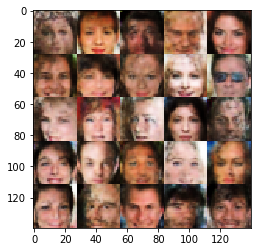

Epoch 6/8... Discriminator Loss: 1.5345... Generator Loss: 0.4202
Epoch 6/8... Discriminator Loss: 1.4668... Generator Loss: 0.4428
Epoch 6/8... Discriminator Loss: 1.3420... Generator Loss: 0.7248
Epoch 6/8... Discriminator Loss: 1.4863... Generator Loss: 0.5012
Epoch 6/8... Discriminator Loss: 1.3558... Generator Loss: 0.6822
Epoch 6/8... Discriminator Loss: 1.2725... Generator Loss: 0.7279
Epoch 6/8... Discriminator Loss: 1.3400... Generator Loss: 0.6218
Epoch 6/8... Discriminator Loss: 1.4525... Generator Loss: 0.5273
Epoch 6/8... Discriminator Loss: 1.7183... Generator Loss: 0.3189
Epoch 6/8... Discriminator Loss: 1.3319... Generator Loss: 1.0199


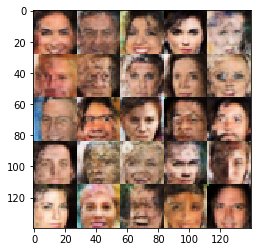

Epoch 6/8... Discriminator Loss: 1.2701... Generator Loss: 0.6201
Epoch 6/8... Discriminator Loss: 1.4617... Generator Loss: 0.4831
Epoch 6/8... Discriminator Loss: 1.4837... Generator Loss: 0.5049
Epoch 6/8... Discriminator Loss: 1.3815... Generator Loss: 0.6167
Epoch 6/8... Discriminator Loss: 1.5927... Generator Loss: 0.3969
Epoch 6/8... Discriminator Loss: 1.2888... Generator Loss: 0.8349
Epoch 6/8... Discriminator Loss: 1.4504... Generator Loss: 0.5250
Epoch 6/8... Discriminator Loss: 1.3742... Generator Loss: 0.5943
Epoch 6/8... Discriminator Loss: 1.2616... Generator Loss: 0.7987
Epoch 6/8... Discriminator Loss: 1.4105... Generator Loss: 0.5009


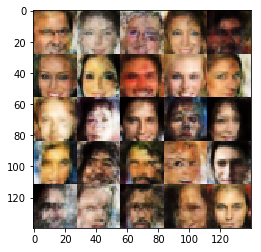

Epoch 6/8... Discriminator Loss: 1.5653... Generator Loss: 0.4120
Epoch 6/8... Discriminator Loss: 1.3917... Generator Loss: 0.5824
Epoch 6/8... Discriminator Loss: 1.2523... Generator Loss: 0.7150
Epoch 6/8... Discriminator Loss: 1.2338... Generator Loss: 0.6933
Epoch 6/8... Discriminator Loss: 1.3250... Generator Loss: 0.6832
Epoch 6/8... Discriminator Loss: 1.4163... Generator Loss: 0.5058
Epoch 6/8... Discriminator Loss: 1.6047... Generator Loss: 0.3888
Epoch 6/8... Discriminator Loss: 1.3495... Generator Loss: 0.6892
Epoch 6/8... Discriminator Loss: 1.4578... Generator Loss: 0.5112
Epoch 6/8... Discriminator Loss: 1.3695... Generator Loss: 0.5818


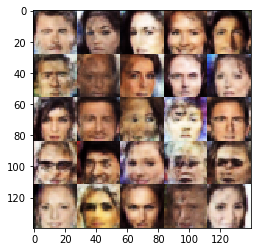

Epoch 6/8... Discriminator Loss: 1.4299... Generator Loss: 0.5175
Epoch 6/8... Discriminator Loss: 1.3976... Generator Loss: 0.5322
Epoch 6/8... Discriminator Loss: 1.2623... Generator Loss: 0.7288
Epoch 6/8... Discriminator Loss: 1.5687... Generator Loss: 0.3967
Epoch 6/8... Discriminator Loss: 1.4010... Generator Loss: 0.5856
Epoch 6/8... Discriminator Loss: 1.7235... Generator Loss: 0.3231
Epoch 6/8... Discriminator Loss: 1.2811... Generator Loss: 0.6666
Epoch 6/8... Discriminator Loss: 1.3381... Generator Loss: 0.7266
Epoch 6/8... Discriminator Loss: 1.3793... Generator Loss: 0.5624
Epoch 6/8... Discriminator Loss: 1.2669... Generator Loss: 0.6393


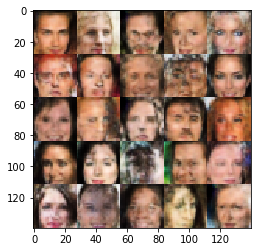

Epoch 6/8... Discriminator Loss: 1.4103... Generator Loss: 0.5708
Epoch 6/8... Discriminator Loss: 1.2743... Generator Loss: 0.7982
Epoch 6/8... Discriminator Loss: 1.3299... Generator Loss: 0.8055
Epoch 6/8... Discriminator Loss: 1.4908... Generator Loss: 0.4885
Epoch 6/8... Discriminator Loss: 1.3592... Generator Loss: 0.7513
Epoch 6/8... Discriminator Loss: 1.5722... Generator Loss: 0.4902
Epoch 6/8... Discriminator Loss: 1.4319... Generator Loss: 0.4945
Epoch 6/8... Discriminator Loss: 1.2767... Generator Loss: 0.7469
Epoch 6/8... Discriminator Loss: 1.4276... Generator Loss: 0.4925
Epoch 6/8... Discriminator Loss: 1.4250... Generator Loss: 0.5993


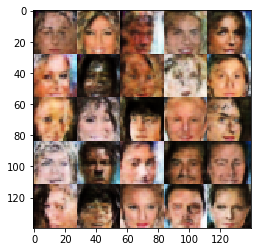

Epoch 6/8... Discriminator Loss: 1.4512... Generator Loss: 0.4757
Epoch 6/8... Discriminator Loss: 1.3142... Generator Loss: 0.6787
Epoch 6/8... Discriminator Loss: 1.4240... Generator Loss: 0.5463
Epoch 6/8... Discriminator Loss: 1.4010... Generator Loss: 0.5480
Epoch 6/8... Discriminator Loss: 1.2394... Generator Loss: 0.7765
Epoch 6/8... Discriminator Loss: 1.4297... Generator Loss: 0.5428
Epoch 6/8... Discriminator Loss: 1.4681... Generator Loss: 0.4349
Epoch 6/8... Discriminator Loss: 1.2123... Generator Loss: 0.7879
Epoch 6/8... Discriminator Loss: 1.6210... Generator Loss: 0.3979
Epoch 6/8... Discriminator Loss: 1.2749... Generator Loss: 0.7873


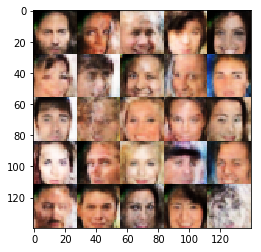

Epoch 6/8... Discriminator Loss: 1.3527... Generator Loss: 0.5835
Epoch 6/8... Discriminator Loss: 1.3357... Generator Loss: 0.8928
Epoch 6/8... Discriminator Loss: 1.3546... Generator Loss: 0.5389
Epoch 6/8... Discriminator Loss: 1.2039... Generator Loss: 0.8387
Epoch 6/8... Discriminator Loss: 1.3465... Generator Loss: 0.6142
Epoch 6/8... Discriminator Loss: 1.3776... Generator Loss: 0.9655
Epoch 6/8... Discriminator Loss: 1.3351... Generator Loss: 0.6413
Epoch 6/8... Discriminator Loss: 1.4282... Generator Loss: 0.5242
Epoch 6/8... Discriminator Loss: 1.5913... Generator Loss: 0.3905
Epoch 6/8... Discriminator Loss: 1.3446... Generator Loss: 0.6311


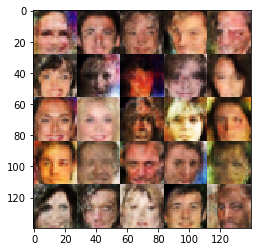

Epoch 6/8... Discriminator Loss: 1.4343... Generator Loss: 0.4705
Epoch 6/8... Discriminator Loss: 1.2563... Generator Loss: 0.7372
Epoch 6/8... Discriminator Loss: 1.2670... Generator Loss: 0.9130
Epoch 6/8... Discriminator Loss: 1.2387... Generator Loss: 0.7972
Epoch 6/8... Discriminator Loss: 1.2913... Generator Loss: 0.7773
Epoch 6/8... Discriminator Loss: 1.2676... Generator Loss: 0.9695
Epoch 6/8... Discriminator Loss: 1.2317... Generator Loss: 0.9769
Epoch 6/8... Discriminator Loss: 1.3407... Generator Loss: 0.5823
Epoch 6/8... Discriminator Loss: 1.1578... Generator Loss: 0.7403
Epoch 6/8... Discriminator Loss: 1.1557... Generator Loss: 0.8344


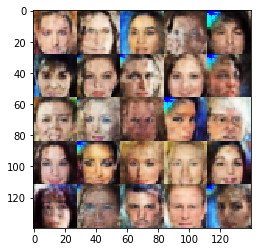

Epoch 6/8... Discriminator Loss: 1.4366... Generator Loss: 0.5429
Epoch 6/8... Discriminator Loss: 1.6100... Generator Loss: 0.4433
Epoch 6/8... Discriminator Loss: 1.3654... Generator Loss: 1.0164
Epoch 6/8... Discriminator Loss: 1.3073... Generator Loss: 0.5948
Epoch 6/8... Discriminator Loss: 1.3210... Generator Loss: 0.5633
Epoch 6/8... Discriminator Loss: 1.2682... Generator Loss: 0.9040
Epoch 6/8... Discriminator Loss: 1.2993... Generator Loss: 0.8220
Epoch 6/8... Discriminator Loss: 1.4360... Generator Loss: 0.4841
Epoch 6/8... Discriminator Loss: 1.5791... Generator Loss: 0.3850
Epoch 6/8... Discriminator Loss: 1.3539... Generator Loss: 1.4172


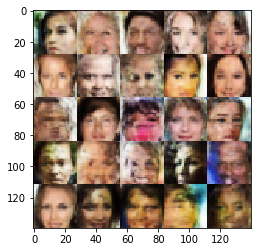

Epoch 6/8... Discriminator Loss: 1.2429... Generator Loss: 0.7398
Epoch 6/8... Discriminator Loss: 1.3985... Generator Loss: 0.5024
Epoch 6/8... Discriminator Loss: 1.2840... Generator Loss: 0.6257
Epoch 6/8... Discriminator Loss: 1.5699... Generator Loss: 0.3821
Epoch 6/8... Discriminator Loss: 1.1972... Generator Loss: 1.0020
Epoch 6/8... Discriminator Loss: 1.4554... Generator Loss: 0.4626
Epoch 6/8... Discriminator Loss: 1.5753... Generator Loss: 0.4390
Epoch 6/8... Discriminator Loss: 1.3588... Generator Loss: 0.5797
Epoch 6/8... Discriminator Loss: 1.9267... Generator Loss: 0.2561
Epoch 6/8... Discriminator Loss: 1.2320... Generator Loss: 0.7917


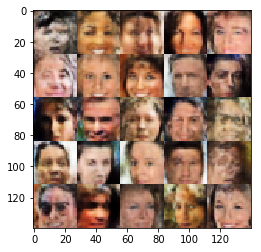

Epoch 6/8... Discriminator Loss: 1.3552... Generator Loss: 0.5672
Epoch 6/8... Discriminator Loss: 1.2081... Generator Loss: 0.8511
Epoch 6/8... Discriminator Loss: 1.5212... Generator Loss: 0.4510
Epoch 6/8... Discriminator Loss: 1.2134... Generator Loss: 0.9833
Epoch 6/8... Discriminator Loss: 1.4247... Generator Loss: 0.5009
Epoch 6/8... Discriminator Loss: 1.3673... Generator Loss: 0.6408
Epoch 6/8... Discriminator Loss: 1.2931... Generator Loss: 0.6163
Epoch 6/8... Discriminator Loss: 1.3999... Generator Loss: 0.6613
Epoch 6/8... Discriminator Loss: 1.2320... Generator Loss: 1.1567
Epoch 6/8... Discriminator Loss: 1.3774... Generator Loss: 0.6387


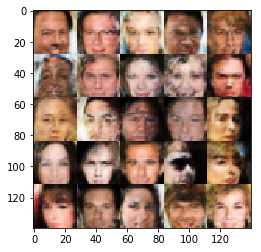

Epoch 6/8... Discriminator Loss: 1.6121... Generator Loss: 0.3820
Epoch 6/8... Discriminator Loss: 1.2521... Generator Loss: 1.0740
Epoch 6/8... Discriminator Loss: 1.3372... Generator Loss: 0.6633
Epoch 6/8... Discriminator Loss: 1.3500... Generator Loss: 0.6389
Epoch 6/8... Discriminator Loss: 1.1162... Generator Loss: 1.1092
Epoch 6/8... Discriminator Loss: 1.2771... Generator Loss: 0.6881
Epoch 6/8... Discriminator Loss: 1.3838... Generator Loss: 0.5411
Epoch 6/8... Discriminator Loss: 1.2556... Generator Loss: 0.8823
Epoch 6/8... Discriminator Loss: 1.3765... Generator Loss: 0.5475
Epoch 6/8... Discriminator Loss: 1.3932... Generator Loss: 0.7131


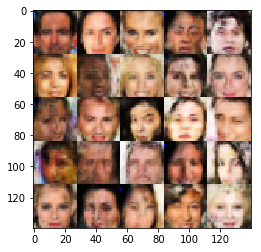

Epoch 6/8... Discriminator Loss: 1.3001... Generator Loss: 0.6092
Epoch 6/8... Discriminator Loss: 1.3278... Generator Loss: 0.6330
Epoch 6/8... Discriminator Loss: 1.3019... Generator Loss: 0.6465
Epoch 6/8... Discriminator Loss: 1.3089... Generator Loss: 0.6889
Epoch 6/8... Discriminator Loss: 1.2206... Generator Loss: 0.8767
Epoch 6/8... Discriminator Loss: 1.3807... Generator Loss: 0.5545
Epoch 6/8... Discriminator Loss: 1.4245... Generator Loss: 0.6189
Epoch 6/8... Discriminator Loss: 1.3544... Generator Loss: 0.5908
Epoch 6/8... Discriminator Loss: 1.2037... Generator Loss: 0.9366
Epoch 6/8... Discriminator Loss: 1.4484... Generator Loss: 0.5481


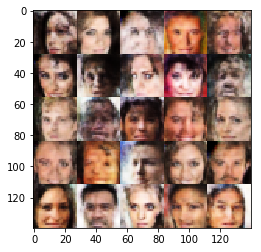

Epoch 6/8... Discriminator Loss: 1.2392... Generator Loss: 0.8571
Epoch 6/8... Discriminator Loss: 1.2146... Generator Loss: 0.7223
Epoch 6/8... Discriminator Loss: 1.3085... Generator Loss: 0.6982
Epoch 6/8... Discriminator Loss: 1.3156... Generator Loss: 0.6568
Epoch 6/8... Discriminator Loss: 1.3572... Generator Loss: 0.6036
Epoch 6/8... Discriminator Loss: 1.2855... Generator Loss: 0.8770
Epoch 6/8... Discriminator Loss: 1.4723... Generator Loss: 0.4781
Epoch 6/8... Discriminator Loss: 1.2503... Generator Loss: 1.1079
Epoch 6/8... Discriminator Loss: 1.5512... Generator Loss: 0.4419
Epoch 6/8... Discriminator Loss: 1.5770... Generator Loss: 0.3994


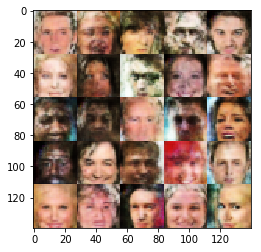

Epoch 6/8... Discriminator Loss: 1.3437... Generator Loss: 0.6222
Epoch 6/8... Discriminator Loss: 1.4171... Generator Loss: 0.4815
Epoch 6/8... Discriminator Loss: 1.2060... Generator Loss: 0.8078
Epoch 6/8... Discriminator Loss: 1.7031... Generator Loss: 0.3234
Epoch 6/8... Discriminator Loss: 1.3670... Generator Loss: 0.5549
Epoch 6/8... Discriminator Loss: 1.2844... Generator Loss: 0.6253
Epoch 6/8... Discriminator Loss: 1.3622... Generator Loss: 0.7478
Epoch 6/8... Discriminator Loss: 1.3097... Generator Loss: 1.4359
Epoch 6/8... Discriminator Loss: 1.5827... Generator Loss: 0.4088
Epoch 6/8... Discriminator Loss: 1.2863... Generator Loss: 0.7001


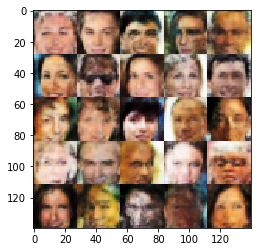

Epoch 6/8... Discriminator Loss: 1.2585... Generator Loss: 0.8526
Epoch 6/8... Discriminator Loss: 1.4945... Generator Loss: 0.4571
Epoch 6/8... Discriminator Loss: 1.2799... Generator Loss: 0.9015
Epoch 6/8... Discriminator Loss: 1.8912... Generator Loss: 0.2527
Epoch 6/8... Discriminator Loss: 1.3240... Generator Loss: 0.7972
Epoch 6/8... Discriminator Loss: 1.5288... Generator Loss: 0.3933
Epoch 6/8... Discriminator Loss: 1.7805... Generator Loss: 0.3069
Epoch 6/8... Discriminator Loss: 1.2830... Generator Loss: 0.9335
Epoch 6/8... Discriminator Loss: 1.3054... Generator Loss: 0.8940
Epoch 6/8... Discriminator Loss: 1.4064... Generator Loss: 0.5493


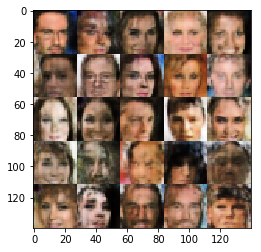

Epoch 6/8... Discriminator Loss: 1.3709... Generator Loss: 0.6606
Epoch 6/8... Discriminator Loss: 1.4260... Generator Loss: 0.5091
Epoch 6/8... Discriminator Loss: 1.2617... Generator Loss: 0.6306
Epoch 6/8... Discriminator Loss: 1.3092... Generator Loss: 0.7886
Epoch 6/8... Discriminator Loss: 1.3577... Generator Loss: 1.1354
Epoch 6/8... Discriminator Loss: 1.3766... Generator Loss: 0.8688
Epoch 6/8... Discriminator Loss: 1.3791... Generator Loss: 0.5538
Epoch 6/8... Discriminator Loss: 1.3111... Generator Loss: 0.5894
Epoch 6/8... Discriminator Loss: 1.2745... Generator Loss: 0.7196
Epoch 6/8... Discriminator Loss: 1.2219... Generator Loss: 0.8379


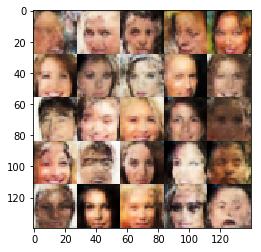

Epoch 6/8... Discriminator Loss: 1.5543... Generator Loss: 0.4122
Epoch 6/8... Discriminator Loss: 1.3814... Generator Loss: 0.7263
Epoch 6/8... Discriminator Loss: 1.3085... Generator Loss: 0.8241
Epoch 6/8... Discriminator Loss: 1.3620... Generator Loss: 0.5811
Epoch 6/8... Discriminator Loss: 1.4060... Generator Loss: 0.4962
Epoch 6/8... Discriminator Loss: 1.3366... Generator Loss: 0.6817
Epoch 6/8... Discriminator Loss: 1.3017... Generator Loss: 0.8570
Epoch 6/8... Discriminator Loss: 1.4284... Generator Loss: 0.4806
Epoch 6/8... Discriminator Loss: 1.4653... Generator Loss: 0.5047
Epoch 6/8... Discriminator Loss: 1.4669... Generator Loss: 0.4639


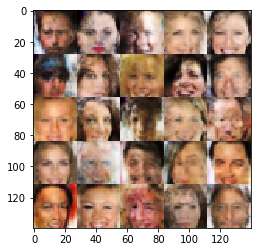

Epoch 6/8... Discriminator Loss: 1.2422... Generator Loss: 0.7403
Epoch 6/8... Discriminator Loss: 1.3603... Generator Loss: 0.5774
Epoch 6/8... Discriminator Loss: 1.3716... Generator Loss: 0.6625
Epoch 6/8... Discriminator Loss: 1.2205... Generator Loss: 0.9210
Epoch 6/8... Discriminator Loss: 1.3005... Generator Loss: 0.6133
Epoch 6/8... Discriminator Loss: 1.3945... Generator Loss: 1.3922
Epoch 6/8... Discriminator Loss: 1.3597... Generator Loss: 0.5993
Epoch 6/8... Discriminator Loss: 1.4927... Generator Loss: 0.4585
Epoch 6/8... Discriminator Loss: 1.5121... Generator Loss: 0.4186
Epoch 6/8... Discriminator Loss: 1.3357... Generator Loss: 0.6202


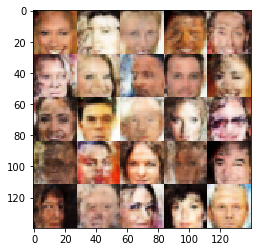

Epoch 6/8... Discriminator Loss: 1.3037... Generator Loss: 0.7468
Epoch 6/8... Discriminator Loss: 1.1613... Generator Loss: 1.0461
Epoch 6/8... Discriminator Loss: 1.3772... Generator Loss: 0.5756
Epoch 6/8... Discriminator Loss: 1.4168... Generator Loss: 0.5060
Epoch 6/8... Discriminator Loss: 1.3686... Generator Loss: 0.7327
Epoch 6/8... Discriminator Loss: 1.3502... Generator Loss: 0.7739
Epoch 6/8... Discriminator Loss: 1.3562... Generator Loss: 0.5706
Epoch 6/8... Discriminator Loss: 1.5492... Generator Loss: 0.4408
Epoch 6/8... Discriminator Loss: 1.1484... Generator Loss: 0.8990
Epoch 6/8... Discriminator Loss: 1.3652... Generator Loss: 0.5903


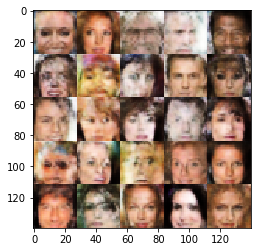

Epoch 6/8... Discriminator Loss: 1.3548... Generator Loss: 0.5465
Epoch 6/8... Discriminator Loss: 1.4134... Generator Loss: 0.4961
Epoch 6/8... Discriminator Loss: 1.7112... Generator Loss: 0.3238
Epoch 6/8... Discriminator Loss: 1.3339... Generator Loss: 0.7600
Epoch 6/8... Discriminator Loss: 1.4159... Generator Loss: 0.5712
Epoch 6/8... Discriminator Loss: 1.4429... Generator Loss: 0.4807
Epoch 6/8... Discriminator Loss: 1.2474... Generator Loss: 0.6977
Epoch 6/8... Discriminator Loss: 1.3029... Generator Loss: 0.7004
Epoch 6/8... Discriminator Loss: 1.6314... Generator Loss: 1.8579
Epoch 6/8... Discriminator Loss: 1.2654... Generator Loss: 1.0675


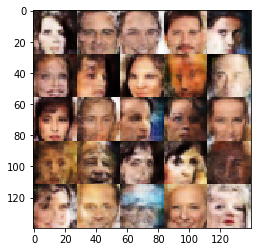

Epoch 6/8... Discriminator Loss: 1.4113... Generator Loss: 0.7165
Epoch 6/8... Discriminator Loss: 1.3863... Generator Loss: 0.5090
Epoch 6/8... Discriminator Loss: 1.2999... Generator Loss: 1.0310
Epoch 6/8... Discriminator Loss: 1.1822... Generator Loss: 0.8278
Epoch 6/8... Discriminator Loss: 1.5745... Generator Loss: 0.4034
Epoch 6/8... Discriminator Loss: 1.3113... Generator Loss: 0.5898
Epoch 6/8... Discriminator Loss: 1.3096... Generator Loss: 0.7919
Epoch 6/8... Discriminator Loss: 1.2389... Generator Loss: 1.1970
Epoch 6/8... Discriminator Loss: 1.2654... Generator Loss: 1.0222
Epoch 6/8... Discriminator Loss: 1.3283... Generator Loss: 0.6984


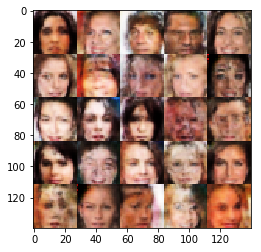

Epoch 6/8... Discriminator Loss: 1.7093... Generator Loss: 0.3260
Epoch 6/8... Discriminator Loss: 1.3089... Generator Loss: 0.5944
Epoch 6/8... Discriminator Loss: 1.2727... Generator Loss: 0.6865
Epoch 6/8... Discriminator Loss: 1.6241... Generator Loss: 0.3616
Epoch 6/8... Discriminator Loss: 1.3447... Generator Loss: 0.5555
Epoch 6/8... Discriminator Loss: 1.2486... Generator Loss: 0.9623
Epoch 6/8... Discriminator Loss: 1.1966... Generator Loss: 0.9762
Epoch 6/8... Discriminator Loss: 1.3372... Generator Loss: 0.8587
Epoch 6/8... Discriminator Loss: 1.5885... Generator Loss: 0.3714
Epoch 6/8... Discriminator Loss: 1.4175... Generator Loss: 0.4548


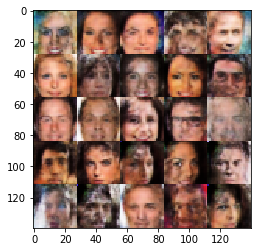

Epoch 6/8... Discriminator Loss: 1.3822... Generator Loss: 0.5897
Epoch 6/8... Discriminator Loss: 1.3018... Generator Loss: 0.5570
Epoch 6/8... Discriminator Loss: 1.5773... Generator Loss: 0.3661
Epoch 6/8... Discriminator Loss: 1.5364... Generator Loss: 0.4382
Epoch 6/8... Discriminator Loss: 1.2592... Generator Loss: 0.8333
Epoch 6/8... Discriminator Loss: 1.4700... Generator Loss: 0.4362
Epoch 6/8... Discriminator Loss: 1.3753... Generator Loss: 0.5840
Epoch 6/8... Discriminator Loss: 1.6802... Generator Loss: 0.3364
Epoch 6/8... Discriminator Loss: 1.2684... Generator Loss: 0.6591
Epoch 6/8... Discriminator Loss: 1.3406... Generator Loss: 0.6974


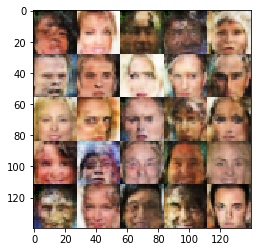

Epoch 6/8... Discriminator Loss: 1.3544... Generator Loss: 0.5768
Epoch 6/8... Discriminator Loss: 1.6154... Generator Loss: 0.3773
Epoch 6/8... Discriminator Loss: 1.4346... Generator Loss: 0.4834
Epoch 6/8... Discriminator Loss: 1.4116... Generator Loss: 0.5982
Epoch 6/8... Discriminator Loss: 1.3561... Generator Loss: 0.6124
Epoch 6/8... Discriminator Loss: 1.2482... Generator Loss: 0.6907
Epoch 6/8... Discriminator Loss: 1.3389... Generator Loss: 0.5841
Epoch 6/8... Discriminator Loss: 1.3747... Generator Loss: 0.5241
Epoch 6/8... Discriminator Loss: 1.2641... Generator Loss: 0.9199
Epoch 6/8... Discriminator Loss: 1.3835... Generator Loss: 0.7465


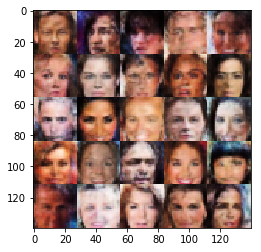

Epoch 6/8... Discriminator Loss: 1.3603... Generator Loss: 1.0688
Epoch 6/8... Discriminator Loss: 1.3450... Generator Loss: 0.6959
Epoch 6/8... Discriminator Loss: 1.6544... Generator Loss: 0.3669
Epoch 6/8... Discriminator Loss: 1.7820... Generator Loss: 0.2930
Epoch 6/8... Discriminator Loss: 1.7449... Generator Loss: 0.3367
Epoch 6/8... Discriminator Loss: 1.5132... Generator Loss: 0.4579
Epoch 6/8... Discriminator Loss: 1.7163... Generator Loss: 0.3294
Epoch 6/8... Discriminator Loss: 1.6376... Generator Loss: 0.3747
Epoch 6/8... Discriminator Loss: 1.3119... Generator Loss: 0.7060
Epoch 6/8... Discriminator Loss: 1.5031... Generator Loss: 0.4512


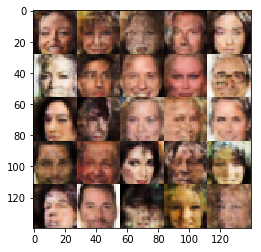

Epoch 6/8... Discriminator Loss: 1.6189... Generator Loss: 0.3813
Epoch 6/8... Discriminator Loss: 1.3417... Generator Loss: 0.5835
Epoch 6/8... Discriminator Loss: 1.3175... Generator Loss: 0.9587
Epoch 6/8... Discriminator Loss: 1.8084... Generator Loss: 0.2886
Epoch 6/8... Discriminator Loss: 1.3863... Generator Loss: 0.5399
Epoch 6/8... Discriminator Loss: 1.3335... Generator Loss: 0.5831
Epoch 6/8... Discriminator Loss: 1.5301... Generator Loss: 0.4779
Epoch 6/8... Discriminator Loss: 1.5191... Generator Loss: 0.4202
Epoch 6/8... Discriminator Loss: 1.2673... Generator Loss: 1.0571
Epoch 6/8... Discriminator Loss: 1.3507... Generator Loss: 1.1035


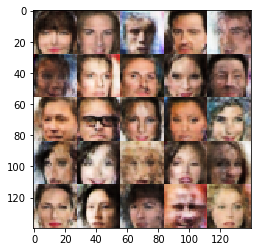

Epoch 6/8... Discriminator Loss: 1.4919... Generator Loss: 0.4430
Epoch 6/8... Discriminator Loss: 1.3233... Generator Loss: 0.7159
Epoch 6/8... Discriminator Loss: 1.3547... Generator Loss: 0.7193
Epoch 6/8... Discriminator Loss: 1.2431... Generator Loss: 0.8099
Epoch 6/8... Discriminator Loss: 1.4356... Generator Loss: 0.4822
Epoch 6/8... Discriminator Loss: 1.3661... Generator Loss: 0.6693
Epoch 6/8... Discriminator Loss: 1.3354... Generator Loss: 0.7226
Epoch 6/8... Discriminator Loss: 1.3316... Generator Loss: 0.6124
Epoch 6/8... Discriminator Loss: 1.4339... Generator Loss: 0.5340
Epoch 6/8... Discriminator Loss: 1.7953... Generator Loss: 0.2809


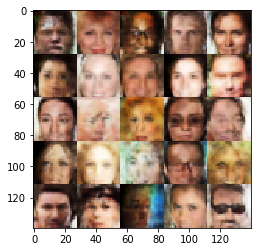

Epoch 6/8... Discriminator Loss: 1.3612... Generator Loss: 0.7343
Epoch 6/8... Discriminator Loss: 1.4828... Generator Loss: 0.4842
Epoch 6/8... Discriminator Loss: 1.5092... Generator Loss: 0.4823
Epoch 6/8... Discriminator Loss: 1.3057... Generator Loss: 0.6513
Epoch 6/8... Discriminator Loss: 1.3805... Generator Loss: 0.5074
Epoch 6/8... Discriminator Loss: 1.2512... Generator Loss: 0.8326
Epoch 6/8... Discriminator Loss: 2.1043... Generator Loss: 0.1983
Epoch 6/8... Discriminator Loss: 1.2416... Generator Loss: 1.0291
Epoch 6/8... Discriminator Loss: 1.5843... Generator Loss: 0.3987
Epoch 6/8... Discriminator Loss: 1.4438... Generator Loss: 0.7460


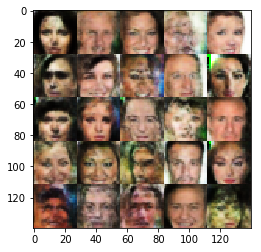

Epoch 6/8... Discriminator Loss: 1.3302... Generator Loss: 0.7148
Epoch 6/8... Discriminator Loss: 1.2657... Generator Loss: 0.6337
Epoch 6/8... Discriminator Loss: 1.4812... Generator Loss: 0.5309
Epoch 6/8... Discriminator Loss: 1.4829... Generator Loss: 0.4715
Epoch 6/8... Discriminator Loss: 1.2827... Generator Loss: 0.6041
Epoch 6/8... Discriminator Loss: 1.3277... Generator Loss: 1.2133
Epoch 6/8... Discriminator Loss: 1.2111... Generator Loss: 0.8004
Epoch 6/8... Discriminator Loss: 1.3512... Generator Loss: 0.6210
Epoch 6/8... Discriminator Loss: 1.2400... Generator Loss: 0.7941
Epoch 6/8... Discriminator Loss: 1.2772... Generator Loss: 0.8347


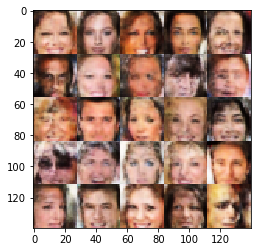

Epoch 6/8... Discriminator Loss: 1.3202... Generator Loss: 0.5880
Epoch 6/8... Discriminator Loss: 1.2996... Generator Loss: 0.6585
Epoch 6/8... Discriminator Loss: 1.3210... Generator Loss: 0.6320
Epoch 6/8... Discriminator Loss: 1.3998... Generator Loss: 0.9384
Epoch 6/8... Discriminator Loss: 1.3358... Generator Loss: 0.6271
Epoch 6/8... Discriminator Loss: 1.2378... Generator Loss: 0.9451
Epoch 6/8... Discriminator Loss: 1.4988... Generator Loss: 0.4260
Epoch 6/8... Discriminator Loss: 1.4583... Generator Loss: 0.6257
Epoch 6/8... Discriminator Loss: 1.4766... Generator Loss: 0.4520
Epoch 7/8... Discriminator Loss: 1.2381... Generator Loss: 1.1732


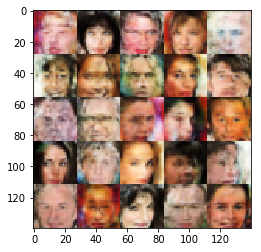

Epoch 7/8... Discriminator Loss: 1.5275... Generator Loss: 0.4018
Epoch 7/8... Discriminator Loss: 1.4656... Generator Loss: 0.4434
Epoch 7/8... Discriminator Loss: 1.5061... Generator Loss: 0.4304
Epoch 7/8... Discriminator Loss: 1.3731... Generator Loss: 0.6127
Epoch 7/8... Discriminator Loss: 1.3027... Generator Loss: 0.7089
Epoch 7/8... Discriminator Loss: 1.3354... Generator Loss: 0.6032
Epoch 7/8... Discriminator Loss: 1.5441... Generator Loss: 0.4328
Epoch 7/8... Discriminator Loss: 1.4982... Generator Loss: 0.4542
Epoch 7/8... Discriminator Loss: 1.2977... Generator Loss: 0.6607
Epoch 7/8... Discriminator Loss: 1.5624... Generator Loss: 0.3813


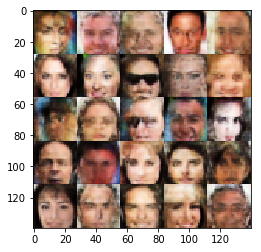

Epoch 7/8... Discriminator Loss: 1.2282... Generator Loss: 0.8658
Epoch 7/8... Discriminator Loss: 1.4905... Generator Loss: 0.4296
Epoch 7/8... Discriminator Loss: 1.5859... Generator Loss: 0.3624
Epoch 7/8... Discriminator Loss: 1.3761... Generator Loss: 0.5271
Epoch 7/8... Discriminator Loss: 1.2531... Generator Loss: 0.6497
Epoch 7/8... Discriminator Loss: 1.4852... Generator Loss: 0.4620
Epoch 7/8... Discriminator Loss: 1.3317... Generator Loss: 0.6958
Epoch 7/8... Discriminator Loss: 1.2606... Generator Loss: 0.9655
Epoch 7/8... Discriminator Loss: 1.3293... Generator Loss: 0.9101
Epoch 7/8... Discriminator Loss: 1.2707... Generator Loss: 0.7212


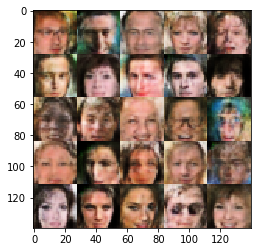

Epoch 7/8... Discriminator Loss: 1.2621... Generator Loss: 1.0194
Epoch 7/8... Discriminator Loss: 1.4086... Generator Loss: 0.4824
Epoch 7/8... Discriminator Loss: 1.2248... Generator Loss: 0.9082
Epoch 7/8... Discriminator Loss: 1.3817... Generator Loss: 0.5567
Epoch 7/8... Discriminator Loss: 1.2729... Generator Loss: 0.7594
Epoch 7/8... Discriminator Loss: 1.5627... Generator Loss: 0.4203
Epoch 7/8... Discriminator Loss: 1.5394... Generator Loss: 0.4283
Epoch 7/8... Discriminator Loss: 1.2508... Generator Loss: 0.7890
Epoch 7/8... Discriminator Loss: 1.4506... Generator Loss: 0.5456
Epoch 7/8... Discriminator Loss: 1.1618... Generator Loss: 0.9192


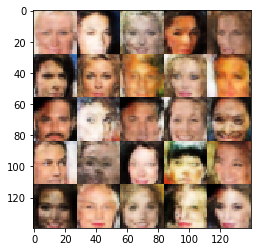

Epoch 7/8... Discriminator Loss: 1.3652... Generator Loss: 0.6583
Epoch 7/8... Discriminator Loss: 1.3805... Generator Loss: 0.5673
Epoch 7/8... Discriminator Loss: 1.2427... Generator Loss: 0.7920
Epoch 7/8... Discriminator Loss: 1.4330... Generator Loss: 0.5579
Epoch 7/8... Discriminator Loss: 1.4335... Generator Loss: 0.5316
Epoch 7/8... Discriminator Loss: 1.5534... Generator Loss: 0.4211
Epoch 7/8... Discriminator Loss: 1.3112... Generator Loss: 1.3108
Epoch 7/8... Discriminator Loss: 1.3947... Generator Loss: 0.6912
Epoch 7/8... Discriminator Loss: 1.4204... Generator Loss: 0.5091
Epoch 7/8... Discriminator Loss: 1.3241... Generator Loss: 0.5952


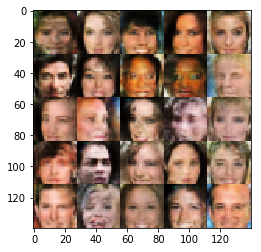

Epoch 7/8... Discriminator Loss: 1.2632... Generator Loss: 0.8375
Epoch 7/8... Discriminator Loss: 1.5223... Generator Loss: 0.4041
Epoch 7/8... Discriminator Loss: 1.2302... Generator Loss: 0.7340
Epoch 7/8... Discriminator Loss: 1.3036... Generator Loss: 0.6916
Epoch 7/8... Discriminator Loss: 1.6256... Generator Loss: 0.4105
Epoch 7/8... Discriminator Loss: 1.4858... Generator Loss: 0.5466
Epoch 7/8... Discriminator Loss: 1.2874... Generator Loss: 1.2169
Epoch 7/8... Discriminator Loss: 1.3067... Generator Loss: 0.6484
Epoch 7/8... Discriminator Loss: 1.3775... Generator Loss: 0.5503
Epoch 7/8... Discriminator Loss: 1.3457... Generator Loss: 0.5773


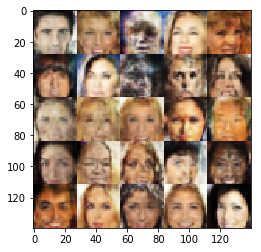

Epoch 7/8... Discriminator Loss: 1.2782... Generator Loss: 0.8288
Epoch 7/8... Discriminator Loss: 1.2850... Generator Loss: 1.0055
Epoch 7/8... Discriminator Loss: 1.3878... Generator Loss: 0.5881
Epoch 7/8... Discriminator Loss: 1.4204... Generator Loss: 0.5574
Epoch 7/8... Discriminator Loss: 1.4411... Generator Loss: 0.4956
Epoch 7/8... Discriminator Loss: 1.3575... Generator Loss: 0.5805
Epoch 7/8... Discriminator Loss: 1.3019... Generator Loss: 0.8767
Epoch 7/8... Discriminator Loss: 1.4251... Generator Loss: 0.5566
Epoch 7/8... Discriminator Loss: 1.3327... Generator Loss: 0.5333
Epoch 7/8... Discriminator Loss: 1.3095... Generator Loss: 1.0282


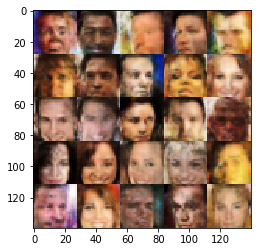

Epoch 7/8... Discriminator Loss: 1.3949... Generator Loss: 0.5474
Epoch 7/8... Discriminator Loss: 1.2858... Generator Loss: 0.7867
Epoch 7/8... Discriminator Loss: 1.4512... Generator Loss: 0.4937
Epoch 7/8... Discriminator Loss: 1.2314... Generator Loss: 0.7404
Epoch 7/8... Discriminator Loss: 1.4769... Generator Loss: 0.4480
Epoch 7/8... Discriminator Loss: 1.6931... Generator Loss: 0.3483
Epoch 7/8... Discriminator Loss: 1.2106... Generator Loss: 0.7380
Epoch 7/8... Discriminator Loss: 1.4727... Generator Loss: 0.4809
Epoch 7/8... Discriminator Loss: 1.4504... Generator Loss: 0.5286
Epoch 7/8... Discriminator Loss: 1.2534... Generator Loss: 0.9333


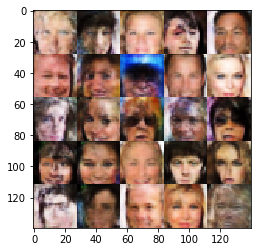

Epoch 7/8... Discriminator Loss: 1.3641... Generator Loss: 0.5768
Epoch 7/8... Discriminator Loss: 1.3231... Generator Loss: 0.6006
Epoch 7/8... Discriminator Loss: 1.2944... Generator Loss: 0.6981
Epoch 7/8... Discriminator Loss: 1.2927... Generator Loss: 0.6224
Epoch 7/8... Discriminator Loss: 1.3774... Generator Loss: 0.7099
Epoch 7/8... Discriminator Loss: 1.3121... Generator Loss: 0.6269
Epoch 7/8... Discriminator Loss: 1.6215... Generator Loss: 0.3631
Epoch 7/8... Discriminator Loss: 1.4083... Generator Loss: 0.5604
Epoch 7/8... Discriminator Loss: 1.3985... Generator Loss: 0.4876
Epoch 7/8... Discriminator Loss: 1.5228... Generator Loss: 0.4227


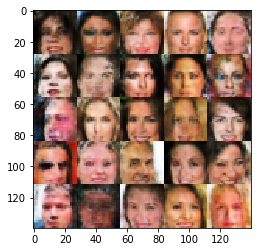

Epoch 7/8... Discriminator Loss: 1.3239... Generator Loss: 0.6668
Epoch 7/8... Discriminator Loss: 1.2733... Generator Loss: 0.7921
Epoch 7/8... Discriminator Loss: 1.3987... Generator Loss: 0.5468
Epoch 7/8... Discriminator Loss: 1.3455... Generator Loss: 0.6421
Epoch 7/8... Discriminator Loss: 1.2540... Generator Loss: 0.7799
Epoch 7/8... Discriminator Loss: 1.6778... Generator Loss: 0.3251
Epoch 7/8... Discriminator Loss: 1.4169... Generator Loss: 0.6191
Epoch 7/8... Discriminator Loss: 1.2968... Generator Loss: 0.7476
Epoch 7/8... Discriminator Loss: 1.4403... Generator Loss: 0.4709
Epoch 7/8... Discriminator Loss: 1.3112... Generator Loss: 0.9634


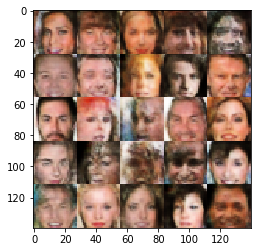

Epoch 7/8... Discriminator Loss: 1.2209... Generator Loss: 0.7093
Epoch 7/8... Discriminator Loss: 1.6229... Generator Loss: 0.4043
Epoch 7/8... Discriminator Loss: 1.6489... Generator Loss: 0.3717
Epoch 7/8... Discriminator Loss: 1.6576... Generator Loss: 0.3648
Epoch 7/8... Discriminator Loss: 1.4807... Generator Loss: 0.4636
Epoch 7/8... Discriminator Loss: 1.3561... Generator Loss: 0.5770
Epoch 7/8... Discriminator Loss: 1.2864... Generator Loss: 0.5796
Epoch 7/8... Discriminator Loss: 1.3365... Generator Loss: 0.5634
Epoch 7/8... Discriminator Loss: 1.3164... Generator Loss: 0.6870
Epoch 7/8... Discriminator Loss: 1.3053... Generator Loss: 0.8367


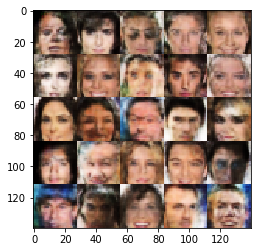

Epoch 7/8... Discriminator Loss: 1.4845... Generator Loss: 1.3137
Epoch 7/8... Discriminator Loss: 1.6556... Generator Loss: 0.3938
Epoch 7/8... Discriminator Loss: 1.4463... Generator Loss: 0.5351
Epoch 7/8... Discriminator Loss: 1.5841... Generator Loss: 0.3849
Epoch 7/8... Discriminator Loss: 1.3266... Generator Loss: 0.6216
Epoch 7/8... Discriminator Loss: 1.2293... Generator Loss: 0.8001
Epoch 7/8... Discriminator Loss: 1.3646... Generator Loss: 0.5979
Epoch 7/8... Discriminator Loss: 1.4230... Generator Loss: 0.5176
Epoch 7/8... Discriminator Loss: 1.4356... Generator Loss: 0.4757
Epoch 7/8... Discriminator Loss: 1.3048... Generator Loss: 0.6342


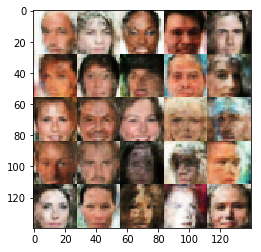

Epoch 7/8... Discriminator Loss: 1.3956... Generator Loss: 0.6063
Epoch 7/8... Discriminator Loss: 1.4472... Generator Loss: 1.2289
Epoch 7/8... Discriminator Loss: 1.4032... Generator Loss: 0.5360
Epoch 7/8... Discriminator Loss: 1.4723... Generator Loss: 0.4696
Epoch 7/8... Discriminator Loss: 1.3614... Generator Loss: 0.6392
Epoch 7/8... Discriminator Loss: 1.4682... Generator Loss: 0.4648
Epoch 7/8... Discriminator Loss: 1.3049... Generator Loss: 0.6625
Epoch 7/8... Discriminator Loss: 1.3408... Generator Loss: 0.6617
Epoch 7/8... Discriminator Loss: 1.5422... Generator Loss: 0.4068
Epoch 7/8... Discriminator Loss: 1.2968... Generator Loss: 0.7687


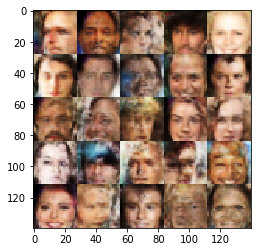

Epoch 7/8... Discriminator Loss: 1.4147... Generator Loss: 0.4883
Epoch 7/8... Discriminator Loss: 1.4996... Generator Loss: 0.4831
Epoch 7/8... Discriminator Loss: 1.5172... Generator Loss: 0.4041
Epoch 7/8... Discriminator Loss: 1.3366... Generator Loss: 0.7747
Epoch 7/8... Discriminator Loss: 1.3748... Generator Loss: 0.6333
Epoch 7/8... Discriminator Loss: 1.3243... Generator Loss: 1.1361
Epoch 7/8... Discriminator Loss: 1.4997... Generator Loss: 0.4706
Epoch 7/8... Discriminator Loss: 1.4326... Generator Loss: 0.5002
Epoch 7/8... Discriminator Loss: 1.4219... Generator Loss: 0.5613
Epoch 7/8... Discriminator Loss: 1.4890... Generator Loss: 0.4327


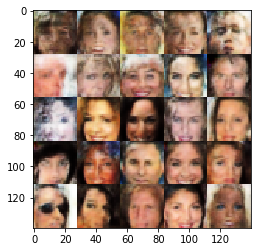

Epoch 7/8... Discriminator Loss: 1.3528... Generator Loss: 0.9117
Epoch 7/8... Discriminator Loss: 1.3452... Generator Loss: 0.5330
Epoch 7/8... Discriminator Loss: 1.5992... Generator Loss: 0.3998
Epoch 7/8... Discriminator Loss: 1.4313... Generator Loss: 0.4909
Epoch 7/8... Discriminator Loss: 1.4927... Generator Loss: 0.4597
Epoch 7/8... Discriminator Loss: 1.2844... Generator Loss: 0.7527
Epoch 7/8... Discriminator Loss: 1.5360... Generator Loss: 0.4656
Epoch 7/8... Discriminator Loss: 1.2722... Generator Loss: 0.7025
Epoch 7/8... Discriminator Loss: 1.2954... Generator Loss: 0.8352
Epoch 7/8... Discriminator Loss: 1.5739... Generator Loss: 0.3746


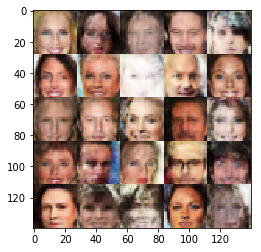

Epoch 7/8... Discriminator Loss: 1.3656... Generator Loss: 0.5821
Epoch 7/8... Discriminator Loss: 1.3801... Generator Loss: 0.5560
Epoch 7/8... Discriminator Loss: 1.2998... Generator Loss: 0.7859
Epoch 7/8... Discriminator Loss: 1.2539... Generator Loss: 0.6664
Epoch 7/8... Discriminator Loss: 1.3859... Generator Loss: 0.5616
Epoch 7/8... Discriminator Loss: 1.2575... Generator Loss: 0.8201
Epoch 7/8... Discriminator Loss: 1.4226... Generator Loss: 0.5583
Epoch 7/8... Discriminator Loss: 1.3459... Generator Loss: 0.8414
Epoch 7/8... Discriminator Loss: 1.4145... Generator Loss: 0.5452
Epoch 7/8... Discriminator Loss: 1.1828... Generator Loss: 0.9665


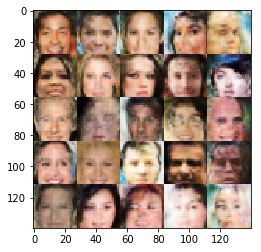

Epoch 7/8... Discriminator Loss: 1.3041... Generator Loss: 0.6958
Epoch 7/8... Discriminator Loss: 1.2595... Generator Loss: 0.8532
Epoch 7/8... Discriminator Loss: 1.3443... Generator Loss: 0.6151
Epoch 7/8... Discriminator Loss: 1.2672... Generator Loss: 0.6410
Epoch 7/8... Discriminator Loss: 1.3140... Generator Loss: 0.7209
Epoch 7/8... Discriminator Loss: 1.3551... Generator Loss: 0.5752
Epoch 7/8... Discriminator Loss: 1.3554... Generator Loss: 0.6313
Epoch 7/8... Discriminator Loss: 1.3891... Generator Loss: 0.8558
Epoch 7/8... Discriminator Loss: 1.3912... Generator Loss: 0.5402
Epoch 7/8... Discriminator Loss: 1.2705... Generator Loss: 0.6718


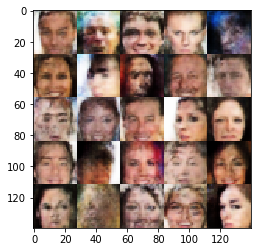

Epoch 7/8... Discriminator Loss: 1.6539... Generator Loss: 0.3511
Epoch 7/8... Discriminator Loss: 1.3368... Generator Loss: 0.6075
Epoch 7/8... Discriminator Loss: 1.2859... Generator Loss: 0.7871
Epoch 7/8... Discriminator Loss: 1.5656... Generator Loss: 0.4000
Epoch 7/8... Discriminator Loss: 1.3607... Generator Loss: 0.6185
Epoch 7/8... Discriminator Loss: 1.4485... Generator Loss: 0.4575
Epoch 7/8... Discriminator Loss: 1.3025... Generator Loss: 0.6650
Epoch 7/8... Discriminator Loss: 1.3512... Generator Loss: 0.6158
Epoch 7/8... Discriminator Loss: 1.2190... Generator Loss: 0.7033
Epoch 7/8... Discriminator Loss: 1.4173... Generator Loss: 0.4854


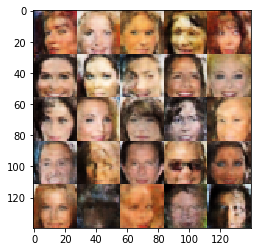

Epoch 7/8... Discriminator Loss: 1.3168... Generator Loss: 0.7209
Epoch 7/8... Discriminator Loss: 1.2040... Generator Loss: 0.8533
Epoch 7/8... Discriminator Loss: 1.3680... Generator Loss: 0.5742
Epoch 7/8... Discriminator Loss: 1.2358... Generator Loss: 0.7348
Epoch 7/8... Discriminator Loss: 1.2771... Generator Loss: 0.6978
Epoch 7/8... Discriminator Loss: 1.5291... Generator Loss: 0.4275
Epoch 7/8... Discriminator Loss: 1.4426... Generator Loss: 0.4811
Epoch 7/8... Discriminator Loss: 1.2838... Generator Loss: 0.8166
Epoch 7/8... Discriminator Loss: 1.2519... Generator Loss: 0.6678
Epoch 7/8... Discriminator Loss: 1.2976... Generator Loss: 1.1439


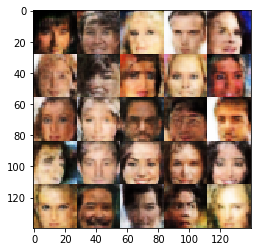

Epoch 7/8... Discriminator Loss: 1.3357... Generator Loss: 0.9875
Epoch 7/8... Discriminator Loss: 1.2840... Generator Loss: 0.6744
Epoch 7/8... Discriminator Loss: 1.3062... Generator Loss: 0.7077
Epoch 7/8... Discriminator Loss: 1.3062... Generator Loss: 0.6973
Epoch 7/8... Discriminator Loss: 1.3259... Generator Loss: 0.7199
Epoch 7/8... Discriminator Loss: 1.3670... Generator Loss: 0.5964
Epoch 7/8... Discriminator Loss: 1.2700... Generator Loss: 0.8414
Epoch 7/8... Discriminator Loss: 1.2657... Generator Loss: 0.8824
Epoch 7/8... Discriminator Loss: 1.6271... Generator Loss: 0.4262
Epoch 7/8... Discriminator Loss: 1.3795... Generator Loss: 0.5621


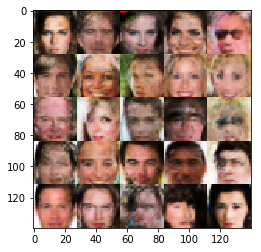

Epoch 7/8... Discriminator Loss: 1.3246... Generator Loss: 0.7720
Epoch 7/8... Discriminator Loss: 1.6050... Generator Loss: 0.3758
Epoch 7/8... Discriminator Loss: 1.5330... Generator Loss: 0.4573
Epoch 7/8... Discriminator Loss: 1.4198... Generator Loss: 0.5219
Epoch 7/8... Discriminator Loss: 1.4802... Generator Loss: 0.4888
Epoch 7/8... Discriminator Loss: 1.6981... Generator Loss: 0.3258
Epoch 7/8... Discriminator Loss: 1.3328... Generator Loss: 0.6580
Epoch 7/8... Discriminator Loss: 1.2233... Generator Loss: 0.6925
Epoch 7/8... Discriminator Loss: 1.3184... Generator Loss: 0.8410
Epoch 7/8... Discriminator Loss: 1.3487... Generator Loss: 0.7445


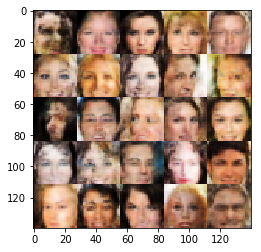

Epoch 7/8... Discriminator Loss: 1.2734... Generator Loss: 0.9105
Epoch 7/8... Discriminator Loss: 1.5188... Generator Loss: 0.4254
Epoch 7/8... Discriminator Loss: 1.4778... Generator Loss: 0.4420
Epoch 7/8... Discriminator Loss: 1.2648... Generator Loss: 0.8439
Epoch 7/8... Discriminator Loss: 1.4741... Generator Loss: 0.4472
Epoch 7/8... Discriminator Loss: 1.5467... Generator Loss: 0.3871
Epoch 7/8... Discriminator Loss: 1.4037... Generator Loss: 0.5523
Epoch 7/8... Discriminator Loss: 1.5242... Generator Loss: 0.4377
Epoch 7/8... Discriminator Loss: 1.2627... Generator Loss: 0.7420
Epoch 7/8... Discriminator Loss: 1.3156... Generator Loss: 0.7782


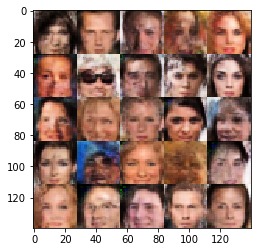

Epoch 7/8... Discriminator Loss: 1.4767... Generator Loss: 0.9344
Epoch 7/8... Discriminator Loss: 1.5183... Generator Loss: 0.4845
Epoch 7/8... Discriminator Loss: 1.3815... Generator Loss: 0.5819
Epoch 7/8... Discriminator Loss: 1.3035... Generator Loss: 0.6551
Epoch 7/8... Discriminator Loss: 1.3841... Generator Loss: 0.5110
Epoch 7/8... Discriminator Loss: 1.3111... Generator Loss: 0.7282
Epoch 7/8... Discriminator Loss: 1.3938... Generator Loss: 0.6327
Epoch 7/8... Discriminator Loss: 1.4353... Generator Loss: 0.4819
Epoch 7/8... Discriminator Loss: 1.4788... Generator Loss: 0.4934
Epoch 7/8... Discriminator Loss: 1.1628... Generator Loss: 0.9496


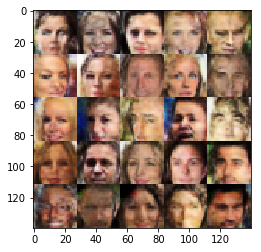

Epoch 7/8... Discriminator Loss: 1.2889... Generator Loss: 0.6389
Epoch 7/8... Discriminator Loss: 1.5202... Generator Loss: 0.4716
Epoch 7/8... Discriminator Loss: 1.3610... Generator Loss: 0.5507
Epoch 7/8... Discriminator Loss: 1.3440... Generator Loss: 0.6486
Epoch 7/8... Discriminator Loss: 1.3094... Generator Loss: 0.6482
Epoch 7/8... Discriminator Loss: 1.5832... Generator Loss: 0.3770
Epoch 7/8... Discriminator Loss: 1.6456... Generator Loss: 0.3739
Epoch 7/8... Discriminator Loss: 1.5024... Generator Loss: 0.5010
Epoch 7/8... Discriminator Loss: 1.3987... Generator Loss: 0.5493
Epoch 7/8... Discriminator Loss: 1.7164... Generator Loss: 0.3455


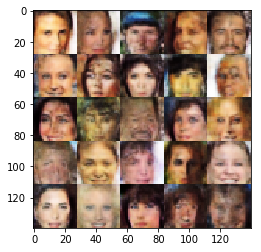

Epoch 7/8... Discriminator Loss: 1.3788... Generator Loss: 0.5484
Epoch 7/8... Discriminator Loss: 1.3368... Generator Loss: 0.5948
Epoch 7/8... Discriminator Loss: 1.2643... Generator Loss: 0.7400
Epoch 7/8... Discriminator Loss: 1.6805... Generator Loss: 0.3524
Epoch 7/8... Discriminator Loss: 1.3295... Generator Loss: 0.6978
Epoch 7/8... Discriminator Loss: 1.2559... Generator Loss: 0.8157
Epoch 7/8... Discriminator Loss: 1.4113... Generator Loss: 0.5325
Epoch 7/8... Discriminator Loss: 1.2756... Generator Loss: 0.8201
Epoch 7/8... Discriminator Loss: 1.3723... Generator Loss: 0.6130
Epoch 7/8... Discriminator Loss: 1.2697... Generator Loss: 0.7771


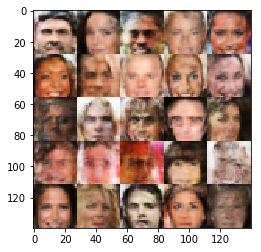

Epoch 7/8... Discriminator Loss: 1.2980... Generator Loss: 0.9400
Epoch 7/8... Discriminator Loss: 1.2279... Generator Loss: 0.9093
Epoch 7/8... Discriminator Loss: 1.4439... Generator Loss: 0.5019
Epoch 7/8... Discriminator Loss: 1.3036... Generator Loss: 0.6916
Epoch 7/8... Discriminator Loss: 1.4203... Generator Loss: 0.4917
Epoch 7/8... Discriminator Loss: 1.6327... Generator Loss: 0.3724
Epoch 7/8... Discriminator Loss: 1.6500... Generator Loss: 0.3920
Epoch 7/8... Discriminator Loss: 1.3451... Generator Loss: 1.2814
Epoch 7/8... Discriminator Loss: 1.6437... Generator Loss: 0.3568
Epoch 7/8... Discriminator Loss: 1.3402... Generator Loss: 0.5144


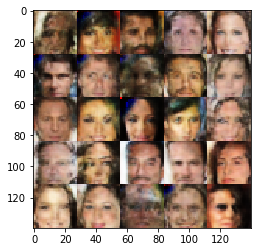

Epoch 7/8... Discriminator Loss: 1.3832... Generator Loss: 1.0629
Epoch 7/8... Discriminator Loss: 1.3547... Generator Loss: 0.8150
Epoch 7/8... Discriminator Loss: 1.4463... Generator Loss: 0.5304
Epoch 7/8... Discriminator Loss: 1.4025... Generator Loss: 0.5729
Epoch 7/8... Discriminator Loss: 1.4231... Generator Loss: 0.5306
Epoch 7/8... Discriminator Loss: 1.4598... Generator Loss: 0.4603
Epoch 7/8... Discriminator Loss: 1.3091... Generator Loss: 0.8235
Epoch 7/8... Discriminator Loss: 1.2772... Generator Loss: 0.6938
Epoch 7/8... Discriminator Loss: 1.3750... Generator Loss: 0.9826
Epoch 7/8... Discriminator Loss: 1.2601... Generator Loss: 0.8616


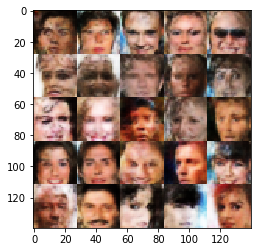

Epoch 7/8... Discriminator Loss: 1.2785... Generator Loss: 0.7895
Epoch 7/8... Discriminator Loss: 1.5472... Generator Loss: 0.4252
Epoch 7/8... Discriminator Loss: 1.4489... Generator Loss: 0.5390
Epoch 7/8... Discriminator Loss: 1.2593... Generator Loss: 0.7116
Epoch 7/8... Discriminator Loss: 1.4704... Generator Loss: 0.5466
Epoch 7/8... Discriminator Loss: 1.3245... Generator Loss: 0.5452
Epoch 7/8... Discriminator Loss: 1.4240... Generator Loss: 0.5732
Epoch 7/8... Discriminator Loss: 1.2424... Generator Loss: 0.9307
Epoch 7/8... Discriminator Loss: 1.3738... Generator Loss: 0.6300
Epoch 7/8... Discriminator Loss: 1.2725... Generator Loss: 0.9661


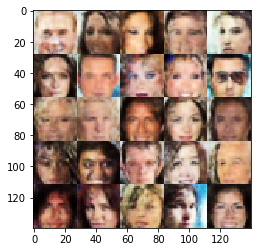

Epoch 7/8... Discriminator Loss: 1.3793... Generator Loss: 0.5696
Epoch 7/8... Discriminator Loss: 1.2970... Generator Loss: 0.6045
Epoch 7/8... Discriminator Loss: 1.4500... Generator Loss: 0.4763
Epoch 7/8... Discriminator Loss: 1.7964... Generator Loss: 0.3001
Epoch 7/8... Discriminator Loss: 1.3343... Generator Loss: 0.6481
Epoch 7/8... Discriminator Loss: 1.3484... Generator Loss: 0.5728
Epoch 7/8... Discriminator Loss: 1.2444... Generator Loss: 0.8104
Epoch 7/8... Discriminator Loss: 1.3833... Generator Loss: 0.5222
Epoch 7/8... Discriminator Loss: 1.3350... Generator Loss: 0.5684
Epoch 7/8... Discriminator Loss: 1.2960... Generator Loss: 0.6880


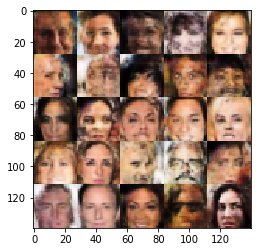

Epoch 7/8... Discriminator Loss: 1.2934... Generator Loss: 0.7459
Epoch 7/8... Discriminator Loss: 1.2964... Generator Loss: 0.6274
Epoch 7/8... Discriminator Loss: 1.5093... Generator Loss: 0.4028
Epoch 7/8... Discriminator Loss: 1.3768... Generator Loss: 0.6745
Epoch 7/8... Discriminator Loss: 1.4018... Generator Loss: 0.5897
Epoch 7/8... Discriminator Loss: 1.4882... Generator Loss: 0.4388
Epoch 7/8... Discriminator Loss: 1.5058... Generator Loss: 0.4740
Epoch 7/8... Discriminator Loss: 1.3513... Generator Loss: 0.8807
Epoch 7/8... Discriminator Loss: 1.2267... Generator Loss: 0.9707
Epoch 7/8... Discriminator Loss: 1.2995... Generator Loss: 0.6703


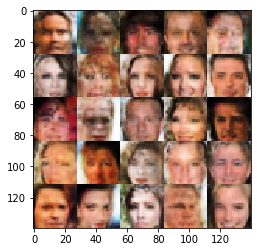

Epoch 7/8... Discriminator Loss: 1.3271... Generator Loss: 0.6348
Epoch 7/8... Discriminator Loss: 1.4025... Generator Loss: 0.5079
Epoch 7/8... Discriminator Loss: 1.3583... Generator Loss: 0.7614
Epoch 7/8... Discriminator Loss: 1.6230... Generator Loss: 0.3741
Epoch 7/8... Discriminator Loss: 1.3160... Generator Loss: 0.8077
Epoch 7/8... Discriminator Loss: 1.4891... Generator Loss: 0.5059
Epoch 7/8... Discriminator Loss: 1.2744... Generator Loss: 0.7337
Epoch 7/8... Discriminator Loss: 1.3201... Generator Loss: 0.5947
Epoch 7/8... Discriminator Loss: 1.5001... Generator Loss: 0.4495
Epoch 7/8... Discriminator Loss: 1.3317... Generator Loss: 0.6846


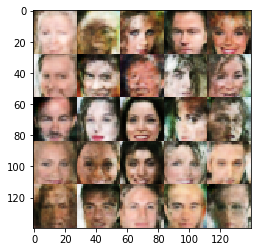

Epoch 7/8... Discriminator Loss: 1.4526... Generator Loss: 0.5056
Epoch 7/8... Discriminator Loss: 1.5172... Generator Loss: 0.4221
Epoch 7/8... Discriminator Loss: 1.3030... Generator Loss: 0.5773
Epoch 7/8... Discriminator Loss: 1.5773... Generator Loss: 0.4290
Epoch 7/8... Discriminator Loss: 1.6073... Generator Loss: 0.3852
Epoch 7/8... Discriminator Loss: 1.4116... Generator Loss: 0.5977
Epoch 7/8... Discriminator Loss: 1.3109... Generator Loss: 0.7080
Epoch 7/8... Discriminator Loss: 1.5470... Generator Loss: 0.4158
Epoch 7/8... Discriminator Loss: 1.4161... Generator Loss: 0.6010
Epoch 7/8... Discriminator Loss: 1.3493... Generator Loss: 0.8176


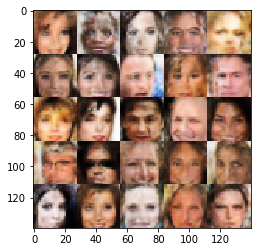

Epoch 7/8... Discriminator Loss: 1.3342... Generator Loss: 0.5824
Epoch 7/8... Discriminator Loss: 1.5419... Generator Loss: 0.4214
Epoch 7/8... Discriminator Loss: 1.4186... Generator Loss: 0.5219
Epoch 7/8... Discriminator Loss: 1.3058... Generator Loss: 0.5992
Epoch 7/8... Discriminator Loss: 1.3141... Generator Loss: 0.7110
Epoch 8/8... Discriminator Loss: 1.6378... Generator Loss: 0.3645
Epoch 8/8... Discriminator Loss: 1.5057... Generator Loss: 0.4297
Epoch 8/8... Discriminator Loss: 1.3885... Generator Loss: 0.5930
Epoch 8/8... Discriminator Loss: 1.2879... Generator Loss: 0.6655
Epoch 8/8... Discriminator Loss: 1.4997... Generator Loss: 0.4203


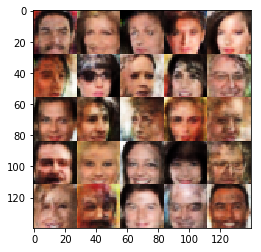

Epoch 8/8... Discriminator Loss: 1.2962... Generator Loss: 0.7943
Epoch 8/8... Discriminator Loss: 1.4129... Generator Loss: 0.5470
Epoch 8/8... Discriminator Loss: 1.2786... Generator Loss: 0.6041
Epoch 8/8... Discriminator Loss: 1.2610... Generator Loss: 0.6992
Epoch 8/8... Discriminator Loss: 1.3396... Generator Loss: 0.5570
Epoch 8/8... Discriminator Loss: 1.3774... Generator Loss: 0.6448
Epoch 8/8... Discriminator Loss: 1.3841... Generator Loss: 0.5975
Epoch 8/8... Discriminator Loss: 1.4628... Generator Loss: 1.2909
Epoch 8/8... Discriminator Loss: 1.3190... Generator Loss: 0.6477
Epoch 8/8... Discriminator Loss: 1.3551... Generator Loss: 0.5979


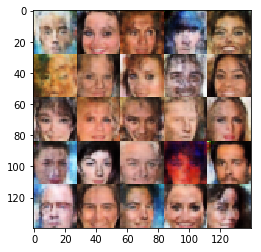

Epoch 8/8... Discriminator Loss: 1.2784... Generator Loss: 0.7084
Epoch 8/8... Discriminator Loss: 1.6924... Generator Loss: 0.3486
Epoch 8/8... Discriminator Loss: 1.3284... Generator Loss: 0.7437
Epoch 8/8... Discriminator Loss: 1.3982... Generator Loss: 0.5075
Epoch 8/8... Discriminator Loss: 1.6305... Generator Loss: 0.3520
Epoch 8/8... Discriminator Loss: 1.4676... Generator Loss: 0.4702
Epoch 8/8... Discriminator Loss: 1.5574... Generator Loss: 0.3926
Epoch 8/8... Discriminator Loss: 1.3249... Generator Loss: 0.6541
Epoch 8/8... Discriminator Loss: 1.3392... Generator Loss: 0.6334
Epoch 8/8... Discriminator Loss: 1.2327... Generator Loss: 0.6798


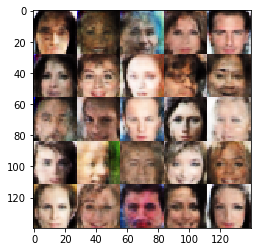

Epoch 8/8... Discriminator Loss: 1.3630... Generator Loss: 0.8624
Epoch 8/8... Discriminator Loss: 1.3873... Generator Loss: 0.5195
Epoch 8/8... Discriminator Loss: 1.2936... Generator Loss: 0.7036
Epoch 8/8... Discriminator Loss: 1.3724... Generator Loss: 0.5191
Epoch 8/8... Discriminator Loss: 1.3909... Generator Loss: 0.5763
Epoch 8/8... Discriminator Loss: 1.2955... Generator Loss: 0.5983
Epoch 8/8... Discriminator Loss: 1.2654... Generator Loss: 0.8337
Epoch 8/8... Discriminator Loss: 1.3296... Generator Loss: 0.5528
Epoch 8/8... Discriminator Loss: 1.5306... Generator Loss: 0.4013
Epoch 8/8... Discriminator Loss: 1.4256... Generator Loss: 0.5545


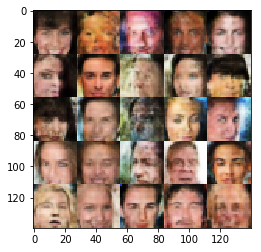

Epoch 8/8... Discriminator Loss: 1.3497... Generator Loss: 0.6215
Epoch 8/8... Discriminator Loss: 1.2575... Generator Loss: 1.2273
Epoch 8/8... Discriminator Loss: 1.4268... Generator Loss: 0.4921
Epoch 8/8... Discriminator Loss: 1.4032... Generator Loss: 0.5130
Epoch 8/8... Discriminator Loss: 1.2450... Generator Loss: 0.6238
Epoch 8/8... Discriminator Loss: 1.5369... Generator Loss: 0.4566
Epoch 8/8... Discriminator Loss: 1.3483... Generator Loss: 0.4975
Epoch 8/8... Discriminator Loss: 1.4101... Generator Loss: 0.5273
Epoch 8/8... Discriminator Loss: 1.5556... Generator Loss: 0.4106
Epoch 8/8... Discriminator Loss: 1.3814... Generator Loss: 0.6243


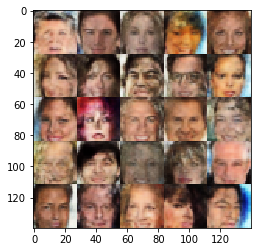

Epoch 8/8... Discriminator Loss: 1.3203... Generator Loss: 0.7695
Epoch 8/8... Discriminator Loss: 1.3467... Generator Loss: 0.5712
Epoch 8/8... Discriminator Loss: 1.4222... Generator Loss: 0.9928
Epoch 8/8... Discriminator Loss: 1.4424... Generator Loss: 0.7154
Epoch 8/8... Discriminator Loss: 1.3603... Generator Loss: 0.6385
Epoch 8/8... Discriminator Loss: 1.3057... Generator Loss: 0.6609
Epoch 8/8... Discriminator Loss: 1.5187... Generator Loss: 0.4172
Epoch 8/8... Discriminator Loss: 1.5055... Generator Loss: 0.4378
Epoch 8/8... Discriminator Loss: 1.3717... Generator Loss: 0.5351
Epoch 8/8... Discriminator Loss: 1.6952... Generator Loss: 0.3284


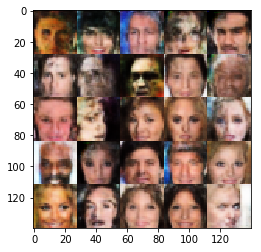

Epoch 8/8... Discriminator Loss: 1.5260... Generator Loss: 0.3997
Epoch 8/8... Discriminator Loss: 1.3889... Generator Loss: 0.5774
Epoch 8/8... Discriminator Loss: 1.2880... Generator Loss: 0.7202
Epoch 8/8... Discriminator Loss: 1.2367... Generator Loss: 0.7548
Epoch 8/8... Discriminator Loss: 1.3438... Generator Loss: 0.5868
Epoch 8/8... Discriminator Loss: 1.3690... Generator Loss: 0.5765
Epoch 8/8... Discriminator Loss: 1.3511... Generator Loss: 0.8443
Epoch 8/8... Discriminator Loss: 1.2528... Generator Loss: 0.6870
Epoch 8/8... Discriminator Loss: 1.2498... Generator Loss: 0.7020
Epoch 8/8... Discriminator Loss: 1.3259... Generator Loss: 0.6311


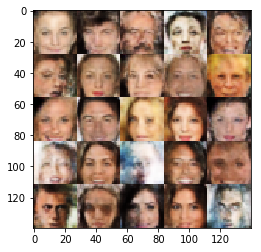

Epoch 8/8... Discriminator Loss: 1.3035... Generator Loss: 0.6095
Epoch 8/8... Discriminator Loss: 1.3701... Generator Loss: 0.6990
Epoch 8/8... Discriminator Loss: 1.4409... Generator Loss: 0.4963
Epoch 8/8... Discriminator Loss: 1.2675... Generator Loss: 0.7333
Epoch 8/8... Discriminator Loss: 1.2870... Generator Loss: 0.9563
Epoch 8/8... Discriminator Loss: 1.3555... Generator Loss: 0.6154
Epoch 8/8... Discriminator Loss: 1.3133... Generator Loss: 0.6224
Epoch 8/8... Discriminator Loss: 1.3729... Generator Loss: 0.5011
Epoch 8/8... Discriminator Loss: 1.4485... Generator Loss: 0.4887
Epoch 8/8... Discriminator Loss: 1.3821... Generator Loss: 1.0568


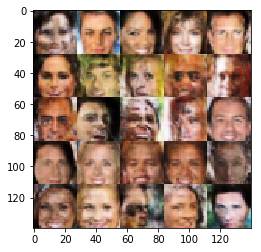

Epoch 8/8... Discriminator Loss: 1.4584... Generator Loss: 0.4778
Epoch 8/8... Discriminator Loss: 1.3418... Generator Loss: 0.7485
Epoch 8/8... Discriminator Loss: 1.3460... Generator Loss: 0.5366
Epoch 8/8... Discriminator Loss: 1.3025... Generator Loss: 0.6797
Epoch 8/8... Discriminator Loss: 1.2775... Generator Loss: 0.7465
Epoch 8/8... Discriminator Loss: 1.2509... Generator Loss: 1.0976
Epoch 8/8... Discriminator Loss: 1.2141... Generator Loss: 0.6743
Epoch 8/8... Discriminator Loss: 1.4347... Generator Loss: 0.5697
Epoch 8/8... Discriminator Loss: 1.3689... Generator Loss: 0.5978
Epoch 8/8... Discriminator Loss: 1.3054... Generator Loss: 0.5824


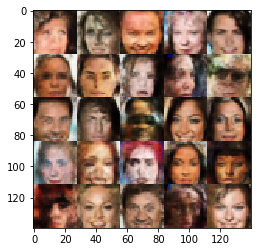

Epoch 8/8... Discriminator Loss: 1.5125... Generator Loss: 0.4439
Epoch 8/8... Discriminator Loss: 1.2768... Generator Loss: 0.6176
Epoch 8/8... Discriminator Loss: 1.2335... Generator Loss: 1.0205
Epoch 8/8... Discriminator Loss: 1.3900... Generator Loss: 0.6469
Epoch 8/8... Discriminator Loss: 1.3707... Generator Loss: 0.7161
Epoch 8/8... Discriminator Loss: 1.3598... Generator Loss: 0.5746
Epoch 8/8... Discriminator Loss: 1.6931... Generator Loss: 0.3407
Epoch 8/8... Discriminator Loss: 1.3654... Generator Loss: 0.6281
Epoch 8/8... Discriminator Loss: 1.2938... Generator Loss: 0.6501
Epoch 8/8... Discriminator Loss: 1.3247... Generator Loss: 0.5661


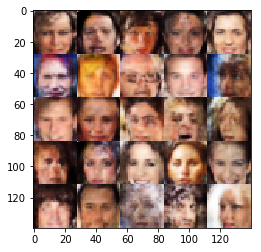

Epoch 8/8... Discriminator Loss: 1.3203... Generator Loss: 1.0589
Epoch 8/8... Discriminator Loss: 1.4160... Generator Loss: 0.5071
Epoch 8/8... Discriminator Loss: 1.3889... Generator Loss: 0.5766
Epoch 8/8... Discriminator Loss: 1.2446... Generator Loss: 0.7823
Epoch 8/8... Discriminator Loss: 1.4718... Generator Loss: 0.4853
Epoch 8/8... Discriminator Loss: 1.2987... Generator Loss: 0.7652
Epoch 8/8... Discriminator Loss: 1.6045... Generator Loss: 0.3711
Epoch 8/8... Discriminator Loss: 1.3594... Generator Loss: 0.6025
Epoch 8/8... Discriminator Loss: 1.5132... Generator Loss: 0.4309
Epoch 8/8... Discriminator Loss: 1.2290... Generator Loss: 0.7043


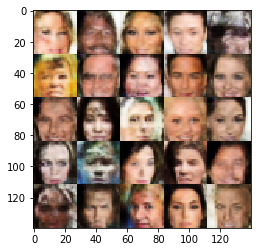

Epoch 8/8... Discriminator Loss: 1.4144... Generator Loss: 0.7694
Epoch 8/8... Discriminator Loss: 1.4242... Generator Loss: 0.5423
Epoch 8/8... Discriminator Loss: 1.3180... Generator Loss: 0.5794
Epoch 8/8... Discriminator Loss: 1.4841... Generator Loss: 0.4662
Epoch 8/8... Discriminator Loss: 1.4399... Generator Loss: 0.5218
Epoch 8/8... Discriminator Loss: 1.2587... Generator Loss: 0.7522
Epoch 8/8... Discriminator Loss: 1.2838... Generator Loss: 0.8034
Epoch 8/8... Discriminator Loss: 1.3252... Generator Loss: 0.6355
Epoch 8/8... Discriminator Loss: 1.2565... Generator Loss: 0.8384
Epoch 8/8... Discriminator Loss: 1.4958... Generator Loss: 0.4305


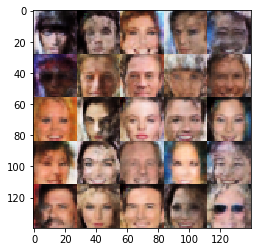

Epoch 8/8... Discriminator Loss: 1.4643... Generator Loss: 0.4801
Epoch 8/8... Discriminator Loss: 1.3712... Generator Loss: 0.6052
Epoch 8/8... Discriminator Loss: 1.3928... Generator Loss: 0.5778
Epoch 8/8... Discriminator Loss: 1.2628... Generator Loss: 1.0000
Epoch 8/8... Discriminator Loss: 1.3367... Generator Loss: 0.7376
Epoch 8/8... Discriminator Loss: 1.4013... Generator Loss: 0.6468
Epoch 8/8... Discriminator Loss: 1.2846... Generator Loss: 0.6544
Epoch 8/8... Discriminator Loss: 1.2713... Generator Loss: 0.6794
Epoch 8/8... Discriminator Loss: 1.4617... Generator Loss: 0.4875
Epoch 8/8... Discriminator Loss: 1.3519... Generator Loss: 0.6311


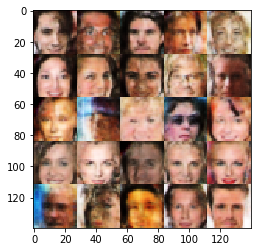

Epoch 8/8... Discriminator Loss: 1.3392... Generator Loss: 0.5990
Epoch 8/8... Discriminator Loss: 1.2554... Generator Loss: 0.7876
Epoch 8/8... Discriminator Loss: 1.4641... Generator Loss: 0.4771
Epoch 8/8... Discriminator Loss: 1.6604... Generator Loss: 0.3454
Epoch 8/8... Discriminator Loss: 1.3970... Generator Loss: 0.5715
Epoch 8/8... Discriminator Loss: 1.4787... Generator Loss: 0.4839
Epoch 8/8... Discriminator Loss: 1.2850... Generator Loss: 0.7969
Epoch 8/8... Discriminator Loss: 1.4227... Generator Loss: 0.5012
Epoch 8/8... Discriminator Loss: 1.2694... Generator Loss: 0.8910
Epoch 8/8... Discriminator Loss: 1.3733... Generator Loss: 1.0157


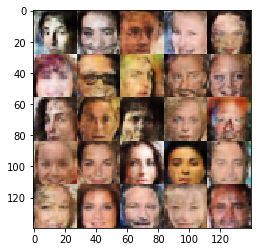

Epoch 8/8... Discriminator Loss: 1.4204... Generator Loss: 0.5211
Epoch 8/8... Discriminator Loss: 1.6493... Generator Loss: 0.3702
Epoch 8/8... Discriminator Loss: 1.2654... Generator Loss: 0.7741
Epoch 8/8... Discriminator Loss: 1.5498... Generator Loss: 0.4379
Epoch 8/8... Discriminator Loss: 1.5814... Generator Loss: 0.4168
Epoch 8/8... Discriminator Loss: 1.4702... Generator Loss: 0.4496
Epoch 8/8... Discriminator Loss: 1.2420... Generator Loss: 1.0577
Epoch 8/8... Discriminator Loss: 1.4434... Generator Loss: 0.5258
Epoch 8/8... Discriminator Loss: 1.4412... Generator Loss: 0.5178
Epoch 8/8... Discriminator Loss: 1.3507... Generator Loss: 0.6686


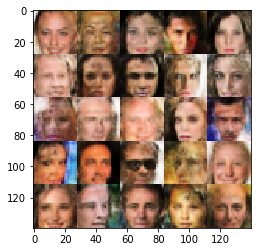

Epoch 8/8... Discriminator Loss: 1.4054... Generator Loss: 0.6520
Epoch 8/8... Discriminator Loss: 1.3184... Generator Loss: 0.9251
Epoch 8/8... Discriminator Loss: 1.2768... Generator Loss: 0.6496
Epoch 8/8... Discriminator Loss: 1.3805... Generator Loss: 0.5707
Epoch 8/8... Discriminator Loss: 1.4005... Generator Loss: 0.4933
Epoch 8/8... Discriminator Loss: 1.2712... Generator Loss: 0.6426
Epoch 8/8... Discriminator Loss: 1.2925... Generator Loss: 0.8190
Epoch 8/8... Discriminator Loss: 1.3544... Generator Loss: 0.6540
Epoch 8/8... Discriminator Loss: 1.2098... Generator Loss: 0.8283
Epoch 8/8... Discriminator Loss: 1.3113... Generator Loss: 0.7136


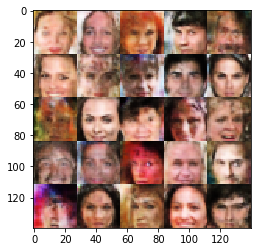

Epoch 8/8... Discriminator Loss: 1.4737... Generator Loss: 0.4558
Epoch 8/8... Discriminator Loss: 1.3174... Generator Loss: 0.7209
Epoch 8/8... Discriminator Loss: 1.4173... Generator Loss: 0.5351
Epoch 8/8... Discriminator Loss: 1.2961... Generator Loss: 0.8980
Epoch 8/8... Discriminator Loss: 1.3512... Generator Loss: 0.6191
Epoch 8/8... Discriminator Loss: 1.3687... Generator Loss: 0.5422
Epoch 8/8... Discriminator Loss: 1.3366... Generator Loss: 0.6468
Epoch 8/8... Discriminator Loss: 1.3719... Generator Loss: 1.2485
Epoch 8/8... Discriminator Loss: 1.2972... Generator Loss: 0.6381
Epoch 8/8... Discriminator Loss: 1.4630... Generator Loss: 0.4435


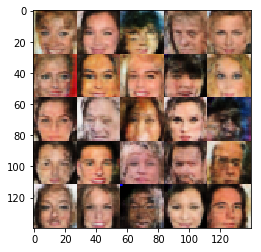

Epoch 8/8... Discriminator Loss: 1.3820... Generator Loss: 1.3683
Epoch 8/8... Discriminator Loss: 1.2675... Generator Loss: 0.7729
Epoch 8/8... Discriminator Loss: 1.3462... Generator Loss: 0.7932
Epoch 8/8... Discriminator Loss: 1.4615... Generator Loss: 0.4768
Epoch 8/8... Discriminator Loss: 1.3635... Generator Loss: 0.5271
Epoch 8/8... Discriminator Loss: 1.4553... Generator Loss: 0.5297
Epoch 8/8... Discriminator Loss: 1.3674... Generator Loss: 0.7395
Epoch 8/8... Discriminator Loss: 1.4101... Generator Loss: 0.5428
Epoch 8/8... Discriminator Loss: 1.1769... Generator Loss: 0.7681
Epoch 8/8... Discriminator Loss: 1.2662... Generator Loss: 0.9340


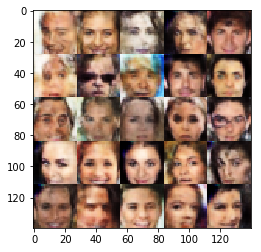

Epoch 8/8... Discriminator Loss: 1.2674... Generator Loss: 0.6765
Epoch 8/8... Discriminator Loss: 1.3963... Generator Loss: 0.5331
Epoch 8/8... Discriminator Loss: 1.3204... Generator Loss: 0.6725
Epoch 8/8... Discriminator Loss: 1.5282... Generator Loss: 0.4419
Epoch 8/8... Discriminator Loss: 1.4196... Generator Loss: 0.5356
Epoch 8/8... Discriminator Loss: 1.3578... Generator Loss: 0.6269
Epoch 8/8... Discriminator Loss: 1.2353... Generator Loss: 1.0489
Epoch 8/8... Discriminator Loss: 1.4093... Generator Loss: 0.5143
Epoch 8/8... Discriminator Loss: 1.2586... Generator Loss: 0.9126
Epoch 8/8... Discriminator Loss: 1.4141... Generator Loss: 0.6213


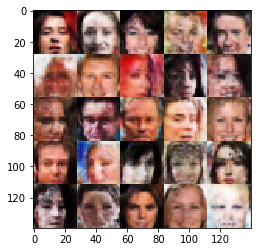

Epoch 8/8... Discriminator Loss: 1.4306... Generator Loss: 0.5108
Epoch 8/8... Discriminator Loss: 1.2154... Generator Loss: 0.7341
Epoch 8/8... Discriminator Loss: 1.3776... Generator Loss: 0.5469
Epoch 8/8... Discriminator Loss: 1.7321... Generator Loss: 0.3239
Epoch 8/8... Discriminator Loss: 1.5009... Generator Loss: 0.4736
Epoch 8/8... Discriminator Loss: 1.4067... Generator Loss: 0.4787
Epoch 8/8... Discriminator Loss: 1.3888... Generator Loss: 0.5914
Epoch 8/8... Discriminator Loss: 1.4885... Generator Loss: 0.4697
Epoch 8/8... Discriminator Loss: 1.2427... Generator Loss: 0.7605
Epoch 8/8... Discriminator Loss: 1.3183... Generator Loss: 0.6669


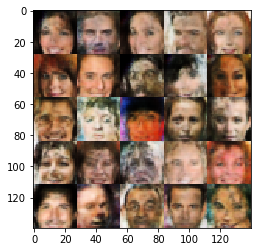

Epoch 8/8... Discriminator Loss: 1.3804... Generator Loss: 0.5004
Epoch 8/8... Discriminator Loss: 1.5490... Generator Loss: 0.4197
Epoch 8/8... Discriminator Loss: 1.3316... Generator Loss: 0.6849
Epoch 8/8... Discriminator Loss: 1.5771... Generator Loss: 0.3946
Epoch 8/8... Discriminator Loss: 1.3847... Generator Loss: 0.5565
Epoch 8/8... Discriminator Loss: 1.6690... Generator Loss: 0.3759
Epoch 8/8... Discriminator Loss: 1.3287... Generator Loss: 0.6228
Epoch 8/8... Discriminator Loss: 1.3045... Generator Loss: 0.6553
Epoch 8/8... Discriminator Loss: 1.3523... Generator Loss: 0.7644
Epoch 8/8... Discriminator Loss: 1.4469... Generator Loss: 0.4665


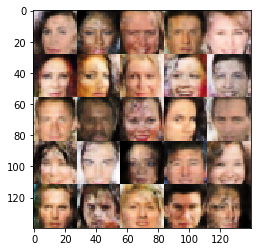

Epoch 8/8... Discriminator Loss: 1.2978... Generator Loss: 0.6487
Epoch 8/8... Discriminator Loss: 1.4668... Generator Loss: 0.5887
Epoch 8/8... Discriminator Loss: 1.3873... Generator Loss: 0.5807
Epoch 8/8... Discriminator Loss: 1.5239... Generator Loss: 0.4600
Epoch 8/8... Discriminator Loss: 1.5121... Generator Loss: 0.4547
Epoch 8/8... Discriminator Loss: 1.2269... Generator Loss: 0.8651
Epoch 8/8... Discriminator Loss: 1.3349... Generator Loss: 0.7658
Epoch 8/8... Discriminator Loss: 1.3747... Generator Loss: 0.6426
Epoch 8/8... Discriminator Loss: 1.4050... Generator Loss: 0.5951
Epoch 8/8... Discriminator Loss: 1.4660... Generator Loss: 0.4787


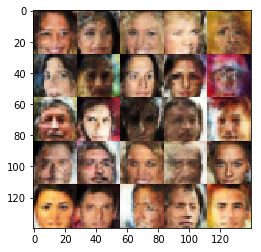

Epoch 8/8... Discriminator Loss: 1.2493... Generator Loss: 0.8871
Epoch 8/8... Discriminator Loss: 1.2421... Generator Loss: 0.8423
Epoch 8/8... Discriminator Loss: 1.2119... Generator Loss: 1.1736
Epoch 8/8... Discriminator Loss: 1.2829... Generator Loss: 0.6415
Epoch 8/8... Discriminator Loss: 1.4450... Generator Loss: 0.4807
Epoch 8/8... Discriminator Loss: 1.3170... Generator Loss: 0.6181
Epoch 8/8... Discriminator Loss: 1.2672... Generator Loss: 0.8660
Epoch 8/8... Discriminator Loss: 1.6221... Generator Loss: 0.3836
Epoch 8/8... Discriminator Loss: 1.5110... Generator Loss: 0.4551
Epoch 8/8... Discriminator Loss: 1.3485... Generator Loss: 0.9039


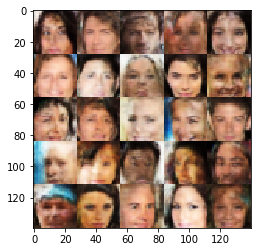

Epoch 8/8... Discriminator Loss: 1.3619... Generator Loss: 0.6462
Epoch 8/8... Discriminator Loss: 1.2071... Generator Loss: 0.7832
Epoch 8/8... Discriminator Loss: 1.2183... Generator Loss: 0.8329
Epoch 8/8... Discriminator Loss: 1.2991... Generator Loss: 0.7715
Epoch 8/8... Discriminator Loss: 1.2407... Generator Loss: 0.6339
Epoch 8/8... Discriminator Loss: 1.2791... Generator Loss: 0.7194
Epoch 8/8... Discriminator Loss: 1.6309... Generator Loss: 0.3555
Epoch 8/8... Discriminator Loss: 1.4198... Generator Loss: 0.5244
Epoch 8/8... Discriminator Loss: 1.3616... Generator Loss: 0.6136
Epoch 8/8... Discriminator Loss: 1.5202... Generator Loss: 0.4496


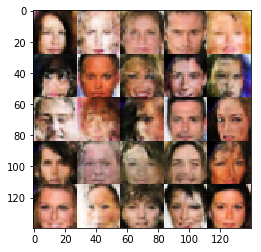

Epoch 8/8... Discriminator Loss: 1.5184... Generator Loss: 0.4258
Epoch 8/8... Discriminator Loss: 1.4292... Generator Loss: 0.5848
Epoch 8/8... Discriminator Loss: 1.4533... Generator Loss: 0.5033
Epoch 8/8... Discriminator Loss: 1.3676... Generator Loss: 0.5343
Epoch 8/8... Discriminator Loss: 1.4053... Generator Loss: 0.5744
Epoch 8/8... Discriminator Loss: 1.3954... Generator Loss: 0.5648
Epoch 8/8... Discriminator Loss: 1.4872... Generator Loss: 0.4459
Epoch 8/8... Discriminator Loss: 1.5038... Generator Loss: 0.4983
Epoch 8/8... Discriminator Loss: 1.4028... Generator Loss: 0.5008
Epoch 8/8... Discriminator Loss: 1.5178... Generator Loss: 0.4053


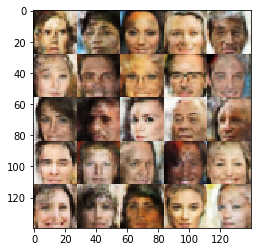

Epoch 8/8... Discriminator Loss: 1.3033... Generator Loss: 0.6585
Epoch 8/8... Discriminator Loss: 1.3686... Generator Loss: 0.5974
Epoch 8/8... Discriminator Loss: 1.4328... Generator Loss: 0.5151
Epoch 8/8... Discriminator Loss: 1.5585... Generator Loss: 0.4063
Epoch 8/8... Discriminator Loss: 1.7392... Generator Loss: 0.3192
Epoch 8/8... Discriminator Loss: 1.3777... Generator Loss: 0.5401
Epoch 8/8... Discriminator Loss: 1.2674... Generator Loss: 0.8010
Epoch 8/8... Discriminator Loss: 1.4789... Generator Loss: 0.4829
Epoch 8/8... Discriminator Loss: 1.2656... Generator Loss: 0.6673
Epoch 8/8... Discriminator Loss: 1.3064... Generator Loss: 0.6893


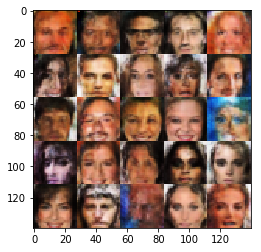

Epoch 8/8... Discriminator Loss: 1.4134... Generator Loss: 0.5393
Epoch 8/8... Discriminator Loss: 1.2874... Generator Loss: 0.7029
Epoch 8/8... Discriminator Loss: 1.3588... Generator Loss: 0.6300
Epoch 8/8... Discriminator Loss: 1.2707... Generator Loss: 0.8185
Epoch 8/8... Discriminator Loss: 1.3796... Generator Loss: 0.5658
Epoch 8/8... Discriminator Loss: 1.5142... Generator Loss: 0.4330
Epoch 8/8... Discriminator Loss: 1.3175... Generator Loss: 0.6344
Epoch 8/8... Discriminator Loss: 1.3525... Generator Loss: 0.5142
Epoch 8/8... Discriminator Loss: 1.5126... Generator Loss: 0.5106
Epoch 8/8... Discriminator Loss: 1.2223... Generator Loss: 0.7306


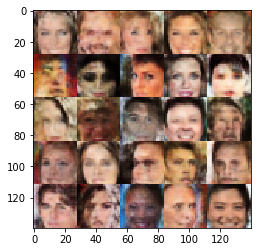

Epoch 8/8... Discriminator Loss: 1.2423... Generator Loss: 1.1087
Epoch 8/8... Discriminator Loss: 1.4024... Generator Loss: 0.5214
Epoch 8/8... Discriminator Loss: 1.4102... Generator Loss: 0.5231
Epoch 8/8... Discriminator Loss: 1.4351... Generator Loss: 0.5632
Epoch 8/8... Discriminator Loss: 1.3844... Generator Loss: 0.5263
Epoch 8/8... Discriminator Loss: 1.3026... Generator Loss: 0.7273
Epoch 8/8... Discriminator Loss: 1.6562... Generator Loss: 0.3764
Epoch 8/8... Discriminator Loss: 1.5573... Generator Loss: 0.3988
Epoch 8/8... Discriminator Loss: 1.5471... Generator Loss: 0.3827
Epoch 8/8... Discriminator Loss: 1.3598... Generator Loss: 0.6119


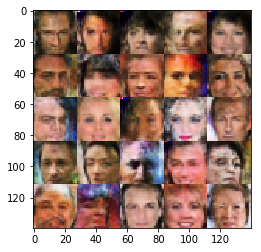

Epoch 8/8... Discriminator Loss: 1.4812... Generator Loss: 0.4901
Epoch 8/8... Discriminator Loss: 1.3800... Generator Loss: 0.5343
Epoch 8/8... Discriminator Loss: 1.2269... Generator Loss: 0.7405
Epoch 8/8... Discriminator Loss: 1.3324... Generator Loss: 0.7383
Epoch 8/8... Discriminator Loss: 1.3667... Generator Loss: 0.6376
Epoch 8/8... Discriminator Loss: 1.2656... Generator Loss: 0.7562
Epoch 8/8... Discriminator Loss: 1.2826... Generator Loss: 0.7955
Epoch 8/8... Discriminator Loss: 1.3729... Generator Loss: 0.5530
Epoch 8/8... Discriminator Loss: 1.3890... Generator Loss: 0.5659
Epoch 8/8... Discriminator Loss: 1.3353... Generator Loss: 0.6289


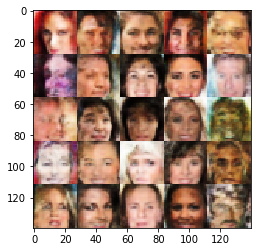

Epoch 8/8... Discriminator Loss: 1.2198... Generator Loss: 0.7547
Epoch 8/8... Discriminator Loss: 1.3120... Generator Loss: 1.0358
Epoch 8/8... Discriminator Loss: 1.3102... Generator Loss: 0.8483
Epoch 8/8... Discriminator Loss: 1.4004... Generator Loss: 1.0972
Epoch 8/8... Discriminator Loss: 1.6569... Generator Loss: 0.3843
Epoch 8/8... Discriminator Loss: 1.5376... Generator Loss: 0.4066
Epoch 8/8... Discriminator Loss: 1.2673... Generator Loss: 0.9018
Epoch 8/8... Discriminator Loss: 1.3923... Generator Loss: 0.6407
Epoch 8/8... Discriminator Loss: 1.6333... Generator Loss: 0.3572
Epoch 8/8... Discriminator Loss: 1.3852... Generator Loss: 0.8099


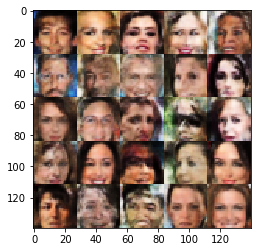

Epoch 8/8... Discriminator Loss: 1.3498... Generator Loss: 0.5856
Epoch 8/8... Discriminator Loss: 1.3458... Generator Loss: 0.7780
Epoch 8/8... Discriminator Loss: 1.6136... Generator Loss: 0.3726
Epoch 8/8... Discriminator Loss: 1.4328... Generator Loss: 0.5300
Epoch 8/8... Discriminator Loss: 1.5363... Generator Loss: 0.4100
Epoch 8/8... Discriminator Loss: 1.2279... Generator Loss: 0.8293
Epoch 8/8... Discriminator Loss: 1.3532... Generator Loss: 0.7124
Epoch 8/8... Discriminator Loss: 1.4261... Generator Loss: 0.5897
Epoch 8/8... Discriminator Loss: 1.2337... Generator Loss: 0.9606
Epoch 8/8... Discriminator Loss: 1.3840... Generator Loss: 0.7512


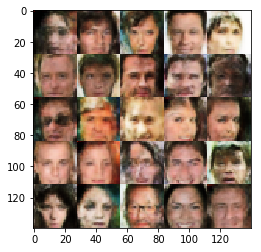

Epoch 8/8... Discriminator Loss: 1.3308... Generator Loss: 0.6567
Epoch 8/8... Discriminator Loss: 1.3425... Generator Loss: 0.7051
Epoch 8/8... Discriminator Loss: 1.3924... Generator Loss: 0.7210
Epoch 8/8... Discriminator Loss: 1.3617... Generator Loss: 0.5564
Epoch 8/8... Discriminator Loss: 1.4590... Generator Loss: 0.4446
Epoch 8/8... Discriminator Loss: 1.3497... Generator Loss: 0.5582
Epoch 8/8... Discriminator Loss: 1.3456... Generator Loss: 0.5806
Epoch 8/8... Discriminator Loss: 1.3399... Generator Loss: 0.7535
Epoch 8/8... Discriminator Loss: 1.3027... Generator Loss: 0.5658
Epoch 8/8... Discriminator Loss: 1.4826... Generator Loss: 0.4769


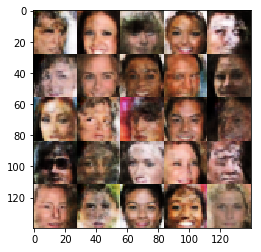

Epoch 8/8... Discriminator Loss: 1.2883... Generator Loss: 0.7974
Epoch 8/8... Discriminator Loss: 1.2927... Generator Loss: 0.8994


In [22]:
batch_size = 64
z_dim = 100
learning_rate = 0.0002
beta1 = 0.2
alpha = 0.08

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 8

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.